# Summary of this notebook
In this notebook we clean and create a test data set for generating process models out of multimodal documents.
We use the SAP Signavio Academic Models as a basis and
1. Clean and filter it
2. Generate multimodal process documentations and the ground truth json out of it.

For step 1, the cleaning and filtering we first extract meta data (section "extracting metadata"). Then we analyze the metadata (section "Analyzing the metadata"). Based on the findings we filter the models based on these characteristics (section "filtering and cleaning"):
* BPMN 2.0 models only
* english and german language only (otherwise I am not able ensure the quality of the models)
* models with min one lane and min four activities only (ensures a certain quality of the models)
* models with min max label length of 5 letters only  (ensures no empty models or models with only letters like A or B as labels)
* models with different names only (otherwise we have a lot of duplicates)
* models with descriptions only (cause we want to increase the text in the process documentation)
* models with no open subprocesses, collapsed are fine (we can not handle message and sequence flows within open subprocesses yet)
* models with valid sytax only (ensures a certain quality of the models)
* models with less then 100 elements only (problematic for resolution of the images otherwise and only some egde cases)

This results in 123 models (out of around one million). We could increase the number of models if we need in the following ways:
* ignore the number of descriptions (dependent on the use case), I guess it increases it by factor 5 - 10
* allow duplicate names and filter duplicates smarter, I guess here is a huge potential
* ignore the language, should increase it estimated by factor 2
* the other characteristics can be changed as well but are more edge-cased focus and ensure a realitsic quality of the models


For step 2 we upload the models to Signavio and generate a process documentation including images and text (section "Generating process documentations"). In addition we generate the ground truth json (section "Generating ground truth json")

# Extracting metadata
In the first step we want to investigate the data set, extract relevent metadata information and save it as a file to use it later for filtering and cleaning. We want to extract the following metadata:
* number of elements
* count of elements per category
* count of entries per property
* min, max and mean length of the labels
* model name of the json model
* detecting language of the model

In [2]:
# Import important libraries
import logging, json
logging.basicConfig(format="%(asctime)s %(levelname)s - %(message)s", level=logging.INFO)

import pandas as pd
pd.set_option("display.min_rows", 4)
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
%matplotlib inline

%reload_ext autoreload
%autoreload 2

from sapsam import parser, constants


# parse csvs
csv_paths = parser.get_csv_paths()

2024-01-22 17:47:26,569 INFO - Found 103 csvs


In [74]:
# Lets look at the data in the first csv
csv_path = csv_paths[0]
df_raw = pd.read_csv(csv_path)
df_raw = df_raw.rename(columns=lambda s: s.replace(" ", "_").lower())
print(df_raw.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   revision_id      10000 non-null  object
 1   model_id         10000 non-null  object
 2   organization_id  10000 non-null  object
 3   datetime         10000 non-null  object
 4   model_json       10000 non-null  object
 5   description      5 non-null      object
 6   name             10000 non-null  object
 7   type             437 non-null    object
 8   namespace        10000 non-null  object
dtypes: object(9)
memory usage: 703.2+ KB
None


In [75]:
# Lets filter BPMN 2.0 only
df_BPMN = df_raw[df_raw.namespace == "http://b3mn.org/stencilset/bpmn2.0#"]

In [80]:
# Lets extract relevant metadata and save it as a pickle file cause it takes very long

from langdetect import detect
from collections import Counter

# Extract name of the json model. Seems to be more accurate than the original name
def extract_model_json_name(model_json):
    try:
        return json.loads(model_json).get('properties', {}).get('name', "")
    except json.JSONDecodeError:
        # Handle the case where x is not valid JSON
        return ""

# Extracting different kind of metadata
def extract_metadata(row):
    bpmn_parser = parser.BpmnModelParser()
    parsedModel = bpmn_parser.parse_df_row(row)

    # Extracting number of elements
    num_elements = parsedModel.shape[0]

    # Extracting counts of element catagorys
    elements_count = None
    category_elements = parsedModel.get("category", pd.Series())
    if not category_elements.empty:
        elements_count = pd.Series(dict(Counter(category_elements.values)))
    

    if 'properties' in parsedModel.columns:

        # returns 1 if property exists and 0 if not
        def property_existence_as_number(property):
            if not property:
                return 0
            if isinstance(property, str):
                str_striped = property.strip()
                if str_striped:
                    return 1
                else:
                    return 0
            elif isinstance(property, float):
                if pd.isna(property):
                    return 0
                else:
                    return 1
            else:
                return 1

        # extratcing property count
        df_properties = pd.DataFrame(parsedModel.properties.tolist())
        properties_count = df_properties.applymap(property_existence_as_number).sum()

    else:
        properties_count = None

    # extracting min, max and mean label length
    if 'label' in parsedModel.columns:
        label_length_max = parsedModel['label'].fillna("").map(len).max()
        label_length_min = parsedModel['label'].fillna("").map(len).min()
        label_length_mean = parsedModel['label'].fillna("").map(len).mean()
        
        try:
            detected_language = detect(parsedModel.label.str.cat(sep=' '))
        except:
            detected_language = None                       
    else:
        # Handle the case when 'label' column is not present
        label_length_max = None
        label_length_min = None
        label_length_mean = None
        detected_language  = None

    return pd.Series([num_elements, detected_language, label_length_max, label_length_min, label_length_mean, properties_count, elements_count])

# extracts metadata from the given csv_path and saves it together with original data in a pickle
def enrich_metadata_and_save(csv_path):
    df_raw = pd.read_csv(csv_path)
    df_raw = df_raw.rename(columns=lambda s: s.replace(" ", "_").lower())
    df_BPMN = df_raw[df_raw.namespace == "http://b3mn.org/stencilset/bpmn2.0#"]
    df_BPMN["model_json_name"] = df_BPMN["model_json"].apply(extract_model_json_name)
    df_BPMN[['num_elements', 'detected_language', 'label_length_max', 'label_length_min', 'label_length_mean', 'properties_count', 'elements_count']] = df_BPMN.apply(extract_metadata, axis=1)
    
    filename = csv_path.name + ".pkl"
    df_BPMN.to_pickle(constants.DATA_ENRICHED / filename)

#enrich_metadata_and_save(csv_paths[0]) 

C:\Users\I566116\AppData\Local\Temp\ipykernel_28800\1296180372.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_BPMN["model_json_name"] = df_BPMN["model_json"].apply(extract_model_json_name)
C:\Users\I566116\AppData\Local\Temp\ipykernel_28800\1296180372.py:75: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_BPMN[['num_elements', 'detected_language', 'label_length_max', 'label_length_min', 'label_length_mean', 'properties_count', 'elements_count']] = df_BPMN.apply(extract_metadata, axis=1)
C:\Users\I

In [79]:
# lets try it with the first model (without saving it as a file to not overwrite it)
model = df_BPMN.iloc[0]
metadata = extract_metadata(model)

with pd.option_context('display.max_rows', None, 'display.max_columns', None, 'display.max_colwidth', None):  # more options can be specified also
    display(metadata)

0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

In [82]:
# lets do this for the first 10 entries to have a bigger and more reprensetative data pool (aprox 30 mins)
for i in range(10):
    enrich_metadata_and_save(csv_paths[i]) 

C:\Users\I566116\AppData\Local\Temp\ipykernel_28800\1296180372.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_BPMN["model_json_name"] = df_BPMN["model_json"].apply(extract_model_json_name)
C:\Users\I566116\AppData\Local\Temp\ipykernel_28800\1296180372.py:75: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_BPMN[['num_elements', 'detected_language', 'label_length_max', 'label_length_min', 'label_length_mean', 'properties_count', 'elements_count']] = df_BPMN.apply(extract_metadata, axis=1)
C:\Users\I

In [89]:
# and now for the rest (multiple hours, best overnight)
for i in range(10, 103):
    enrich_metadata_and_save(csv_paths[i]) 

C:\Users\I566116\AppData\Local\Temp\ipykernel_28800\1296180372.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_BPMN["model_json_name"] = df_BPMN["model_json"].apply(extract_model_json_name)
C:\Users\I566116\AppData\Local\Temp\ipykernel_28800\1296180372.py:75: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_BPMN[['num_elements', 'detected_language', 'label_length_max', 'label_length_min', 'label_length_mean', 'properties_count', 'elements_count']] = df_BPMN.apply(extract_metadata, axis=1)
C:\Users\I

# Analyzing the metadata
Lets have a look at the metadata to get a feeling what good filters could be

In [90]:
# lets load the enriched data
def read_enriched(csv_path) -> pd.DataFrame:
    filename = csv_path.name + ".pkl"
    return pd.read_pickle(constants.DATA_ENRICHED / filename)

df_enriched = read_enriched(csv_paths[0])

# lets find relevant properties with the help of the properties count
# lets focus on englisch because the properties are cusstom and can be different in every language
df_enriched_EN = df_enriched[df_enriched.detected_language == 'en']

prop_count = df_enriched_EN.properties_count
df_prop_count = pd.DataFrame(list(prop_count))
means = df_prop_count.mean()
# Placeholder threshold
threshold = 0.10
filtered_means = means[means > threshold]
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
print(filtered_means)

# the first insights: 
# seems like documentation is a great canidate for our use case because 
# we want to include as much text as possible in the process docmunentation later
# if there is a cost attribute the model seems to have a high quality
# if there is a name for the root element (equals diagram name) seems to have a good correlation and a good canidate as well
# if the name of the pool is "ACME AG" the model seems to have a high quality

probability                       1.483892
isimmediate                       2.387866
conditiontype                    16.939273
conditionexpression               1.015518
bordercolor                      44.922751
showdiamondmarker                 5.009860
name                             22.183448
type                              4.535790
text                              0.763339
processtype                       1.887536
isexecutable                      0.823066
boundaryvisible                   1.905935
isclosed                          0.884218
suppressjoinfailure               0.854423
adhocordering                     2.431034
enableinstancecompensation        0.854423
multiinstance                     0.955261
bgcolor                          20.171033
processid                         4.824529
maximum                           1.904922
adhoc                             0.854423
minimum                           1.904922
status                            2.913838
showcaption

In [85]:
# lets check what happens if we filter for documentation_count
def get_count(item, count_label):
        if isinstance(item, pd.Series): 
            return item.get(count_label, 0)
        else:
            return 0

# extract relevant counts
df_enriched['documentation_count'] = pd.to_numeric(df_enriched['properties_count'].apply(lambda x: get_count(x,'documentation')))

# define conditions
print()
print("Total number of entries: ", df_enriched.shape[0])
df_has_docu = df_enriched[(df_enriched.documentation_count > 5)]
print("Number of entries with docu cleaning: ", df_has_docu.shape[0])



Total number of entries:  5989
Number of entries with docu cleaning:  1305


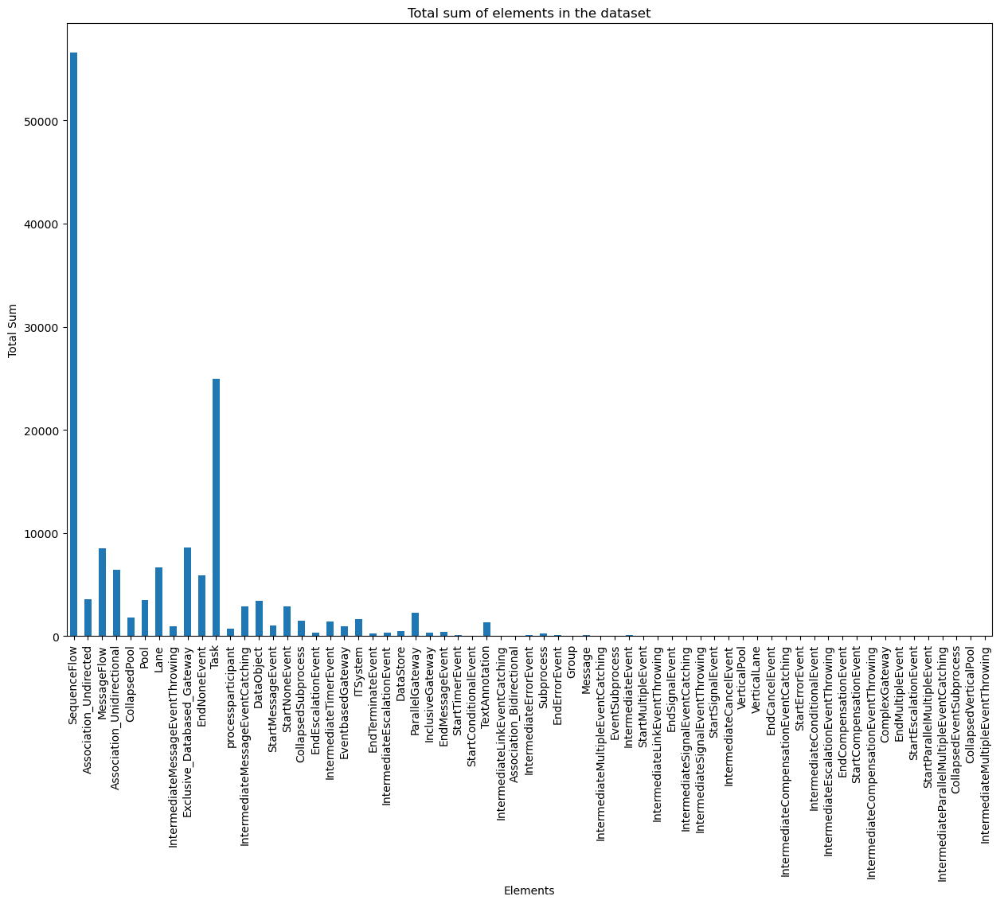

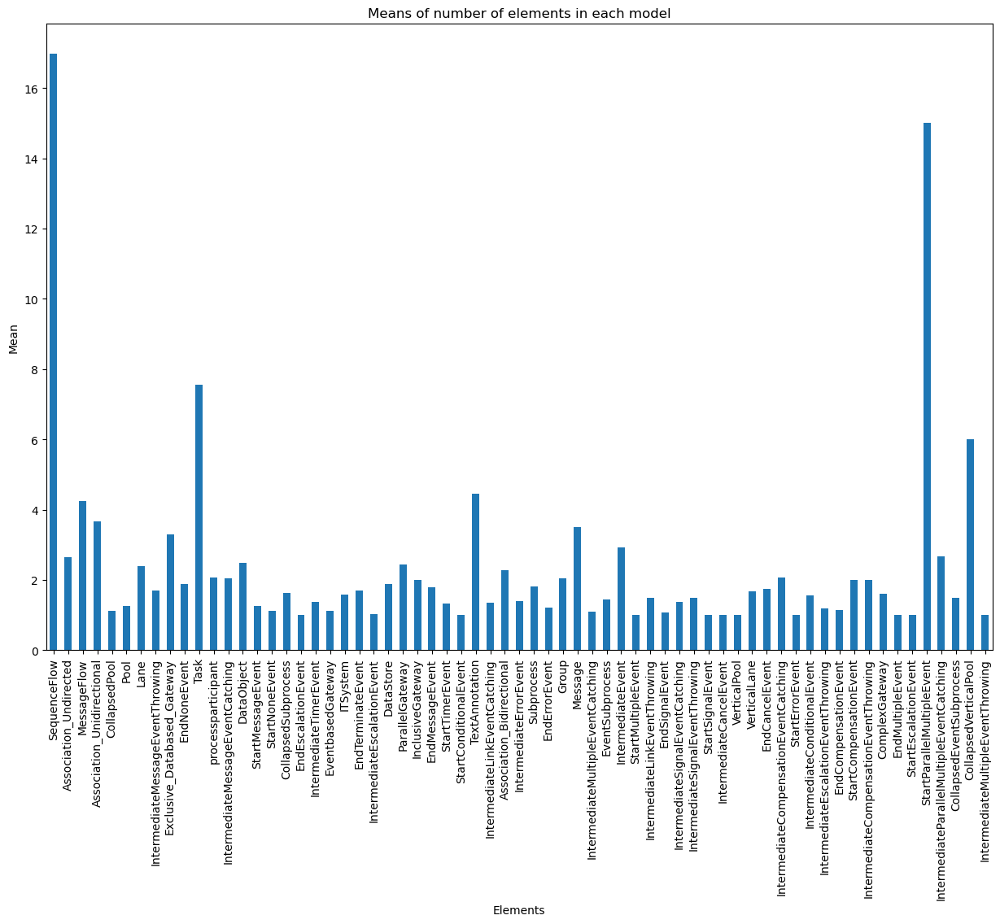

In [8]:
# Lets look at the elem_count and print it
elem_count = df_enriched_EN.elements_count
df_elem_count = pd.DataFrame(list(elem_count))

elem_count_sums = df_elem_count.sum()
elem_count_means = df_elem_count.mean()

# Plotting
plt.figure(figsize=(15, 10))
elem_count_sums.plot(kind='bar')
plt.title('Total sum of elements in the dataset')
plt.xlabel('Elements')
plt.ylabel('Total Sum')
plt.xticks(rotation=90)  # Rotates the labels on the x-axis for readability
plt.show()

plt.figure(figsize=(15, 10))
elem_count_means.plot(kind='bar')
plt.title('Means of number of elements in each model')
plt.xlabel('Elements')
plt.ylabel('Mean')
plt.xticks(rotation=90)  # Rotates the labels on the x-axis for readability
plt.show()

# Insights:
# Min 1 or 2 lanes and 4 tasks seems like a valid filter

<class 'pandas.core.frame.DataFrame'>
Index: 3351 entries, 1 to 9996
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   revision_id        3351 non-null   object 
 1   model_id           3351 non-null   object 
 2   organization_id    3351 non-null   object 
 3   datetime           3351 non-null   object 
 4   model_json         3351 non-null   object 
 5   description        1 non-null      object 
 6   name               3351 non-null   object 
 7   type               240 non-null    object 
 8   namespace          3351 non-null   object 
 9   model_json_name    3351 non-null   object 
 10  num_elements       3351 non-null   float64
 11  detected_language  3351 non-null   object 
 12  label_length_max   3351 non-null   float64
 13  label_length_min   3351 non-null   float64
 14  label_length_mean  3351 non-null   float64
 15  properties_count   3351 non-null   object 
 16  elements_count     3351 non-n

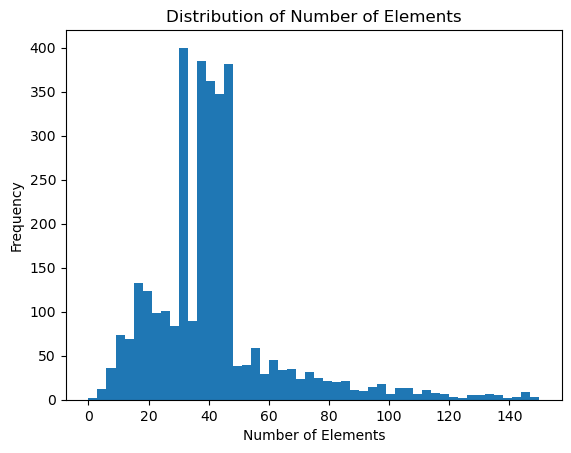

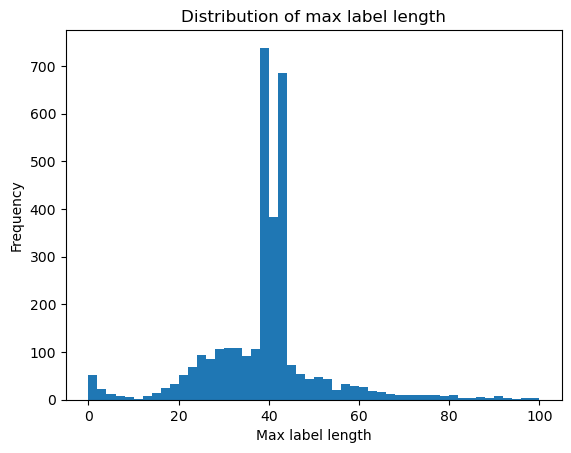

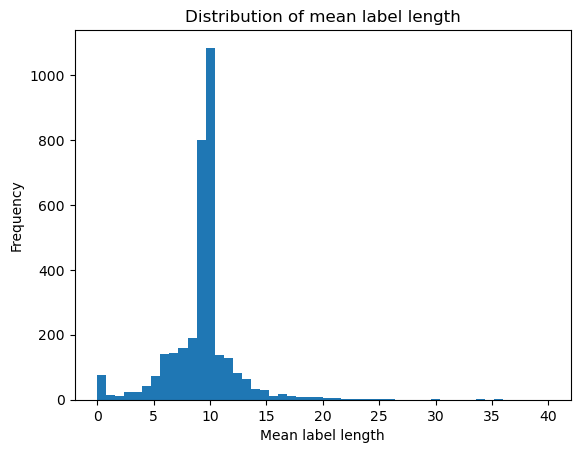

In [35]:
# lets look at the other metadata and how we can define boundaries 


# lets look closer at the df
print(df_enriched_EN.info())

# plot metadata
plt.hist(df_enriched_EN['num_elements'], bins=50,  range=(0, 150))  
plt.title('Distribution of Number of Elements')
plt.xlabel('Number of Elements')
plt.ylabel('Frequency')
plt.show()

plt.hist(df_enriched_EN['label_length_max'], bins=50,  range=(0, 100))  
plt.title('Distribution of max label length')
plt.xlabel('Max label length')
plt.ylabel('Frequency')
plt.show()

plt.hist(df_enriched_EN['label_length_mean'], bins=50,  range=(0, 40))  
plt.title('Distribution of mean label length')
plt.xlabel('Mean label length')
plt.ylabel('Frequency')
plt.show()

# for num_elements: > 10 seems like a good minimum standard. We could have three classes: Simple (10-20), medium (20-50), complex (50-100)
# for label_length_max >5 seems like a good minimum standard. Not sure if we need a maximum here.

In [12]:
# our models should have a valid syntax. The check is costly and should be perfromed as a last step to stay efficient
import json, requests
from conf import system_instance
from sapsam.SignavioAuthenticator import SignavioAuthenticator

def check_syntax(model_json):
    auth_data = SignavioAuthenticator.authenticate()
    syntax_check_url = system_instance + '/p/syntaxchecker'
    cookies = {'JSESSIONID': auth_data['jsesssion_ID'], 'LBROUTEID': auth_data['lb_route_ID']}
    headers = {'Accept': 'application/json', 'x-signavio-id':  auth_data['auth_token']}
    data = {
        'isJson': 'true',
        'ns': 'http://b3mn.org/stencilset/bpmn2.0#',
        'data_json': model_json,
    }
    syntax_check_request = requests.post(syntax_check_url,cookies=cookies,headers=headers,data=data)
    result = json.loads(syntax_check_request.content)
    return result

def has_no_syntax_error(row):
    check = check_syntax(row.model_json)
    check_rep = check.get("rep", False)
    if check_rep:
        check_rep_0 = check_rep[0]
        if check_rep_0:
            check_rep_0_must = check_rep_0.get('must', False)
            if check_rep_0_must:
                return not check_rep_0_must
            
    return True
    

print(has_no_syntax_error(df_enriched_EN.iloc[0]))

NameError: name 'df_enriched_EN' is not defined

In [5]:
# Lets draw some of these

from IPython.display import Image, display
from sapsam.ImageGenerator import ImageGenerator

def upload_and_show_image(model):
    # get required data
    model_json = model.model_json
    model_namespace = model.namespace
    model_name = model.model_json_name
    print('Name: ', model_name)
    # generate image
    gen = ImageGenerator()
    # note: error InvalidHeader can occour if the account is deactivated or credentials are wrong
    image_request = gen.generate_image(model_name, model_json, model_namespace, deletes=False)
    display(Image(image_request))

In [13]:
random_samples = df_enriched_EN.sample(n=10)
random_samples.apply(upload_and_show_image, axis=1)

NameError: name 'df_enriched_EN' is not defined

# Filtering and cleaning
Based on our findings in the section above and further experiments we want to filter and clean the data set.

In [37]:
def clean_df(df_BPMN_enriched: pd.DataFrame) -> pd.DataFrame:
    
    def get_count(item, count_label):
        if isinstance(item, pd.Series): 
            return item.get(count_label, 0)
        else:
            return 0

    # extract relevant counts
    df_BPMN_enriched['documentation_count'] = pd.to_numeric(df_BPMN_enriched['properties_count'].apply(lambda x: get_count(x,'documentation')))
    df_BPMN_enriched['lane_count'] = pd.to_numeric(df_BPMN_enriched['elements_count'].apply(lambda x: get_count(x,'Lane')))
    df_BPMN_enriched['task_count'] = pd.to_numeric(df_BPMN_enriched['elements_count'].apply(lambda x: get_count(x,'Task')))
    df_BPMN_enriched['event_subprocess_count'] = pd.to_numeric(df_BPMN_enriched['elements_count'].apply(lambda x: get_count(x,'EventSubprocess')))
    df_BPMN_enriched['subprocess_count'] = pd.to_numeric(df_BPMN_enriched['elements_count'].apply(lambda x: get_count(x,'Subprocess')))


    # define conditions
    #condition_eng = (df_BPMN_enriched.detected_language == 'en')
    condition_eng = ((df_BPMN_enriched.detected_language == 'en') | (df_BPMN_enriched.detected_language == 'de'))
    condition_name_exist = df_BPMN_enriched.model_json_name.apply(lambda x: bool(x.strip()))
    condition_has_documentation = (df_BPMN_enriched.documentation_count >= 4)
    #condition_number_elements = ((df_BPMN_enriched.num_elements > 10) & (df_BPMN_enriched.num_elements < 100))
    condition_number_elements = (df_BPMN_enriched.num_elements < 100)
    condition_min_label_max_length = (df_BPMN_enriched.label_length_max >= 5)
    condition_has_lane = (df_BPMN_enriched.lane_count >= 1)
    condition_has_tasks = (df_BPMN_enriched.task_count >= 4)

    # No open subprocess, because we can not handle it yet, especially diffifcult with the sequence and message flow
    # Collapsed subprocess should be no problem as we can handle them like a normal task
    condition_no_event_subprocess = (df_BPMN_enriched.event_subprocess_count == 0)
    condition_no_subprocess = (df_BPMN_enriched.subprocess_count == 0)

    print("Number of entries before cleaning: ", df_BPMN_enriched.shape[0])
    #df_BPMN_cleaned  = df_BPMN_enriched[condition_eng & condition_name_exist & condition_number_elements & condition_min_label_max_length & condition_has_documentation & condition_has_lane & condition_has_tasks]
    df_BPMN_cleaned  = df_BPMN_enriched[condition_has_lane & condition_has_tasks & condition_number_elements & condition_min_label_max_length & condition_eng & condition_has_documentation & condition_no_event_subprocess & condition_no_subprocess]
    df_BPMN_cleaned = df_BPMN_cleaned.drop_duplicates(subset=['model_json_name']) # that filters almost everything out, not sure how good that is
    print("Number of entries after cleaning: ", df_BPMN_cleaned.shape[0])
    return df_BPMN_cleaned

csv_path = csv_paths[0]
filename = csv_path.name + ".pkl"
df_cleaned = clean_df(pd.read_pickle(constants.DATA_ENRICHED / filename))
print(df_cleaned.info())

# insights:
# we applied this function to the full data set (around 1 million entries in total) with multiple configurations:
# detected_language == 'en' & num_elements < 100 & label_length_max >= 5 & lane_count >= 1 & task_count >= 4: 728 models left
# detected_language == 'en' & num_elements < 100 & label_length_max >= 5 & lane_count >= 1 & task_count >= 4 & documentation_count >= 4 : 69 models left

# documentation_count >= 4: 209 models left
# documentation_count >= 4 & num_elements < 100: 186 models left
# documentation_count >= 4 & num_elements < 100 & label_length_max >= 5: 186 models left
# documentation_count >= 4 & num_elements < 100 & label_length_max >= 5 & detected_language == 'en': 69 models left

# so if we want to have around 100 models (syntax check and manually filtering will come on top as well) we have two ways
# a) use eng and german and other languages, we did this
# b) dont use documentation count


Number of entries before cleaning:  5989
Number of entries after cleaning:  7
<class 'pandas.core.frame.DataFrame'>
Index: 7 entries, 1 to 623
Data columns (total 22 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   revision_id             7 non-null      object 
 1   model_id                7 non-null      object 
 2   organization_id         7 non-null      object 
 3   datetime                7 non-null      object 
 4   model_json              7 non-null      object 
 5   description             0 non-null      object 
 6   name                    7 non-null      object 
 7   type                    1 non-null      object 
 8   namespace               7 non-null      object 
 9   model_json_name         7 non-null      object 
 10  num_elements            7 non-null      float64
 11  detected_language       7 non-null      object 
 12  label_length_max        7 non-null      float64
 13  label_length_min        

In [4]:
# lets draw these
df_cleaned.apply(upload_and_show_image, axis=1)

NameError: name 'upload_and_show_image' is not defined

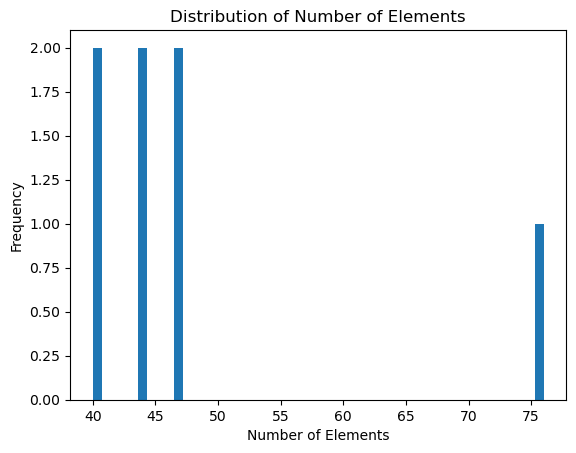

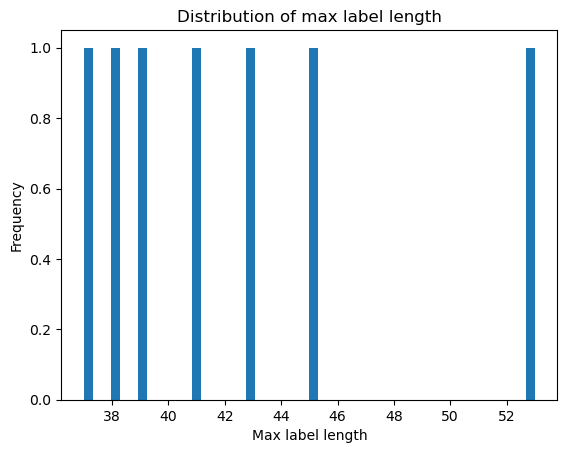

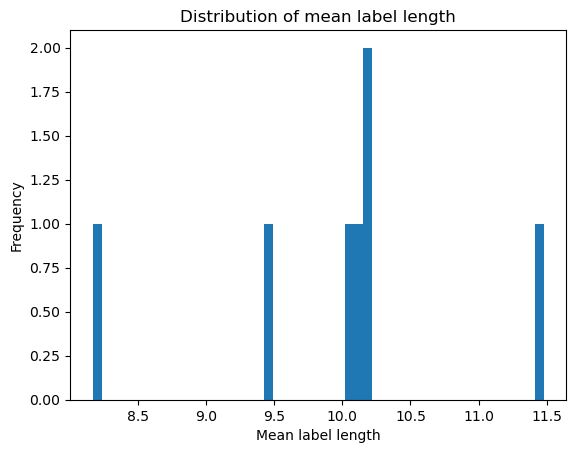

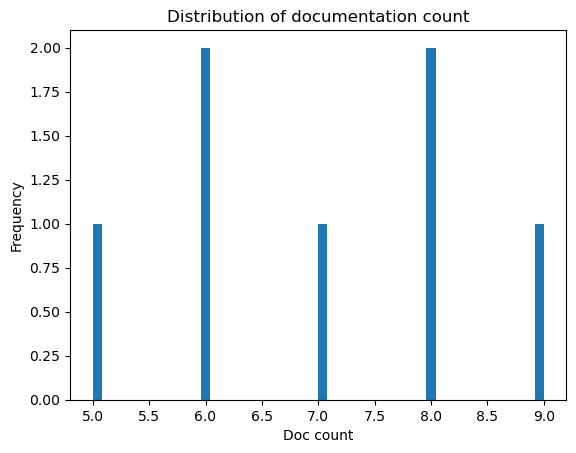

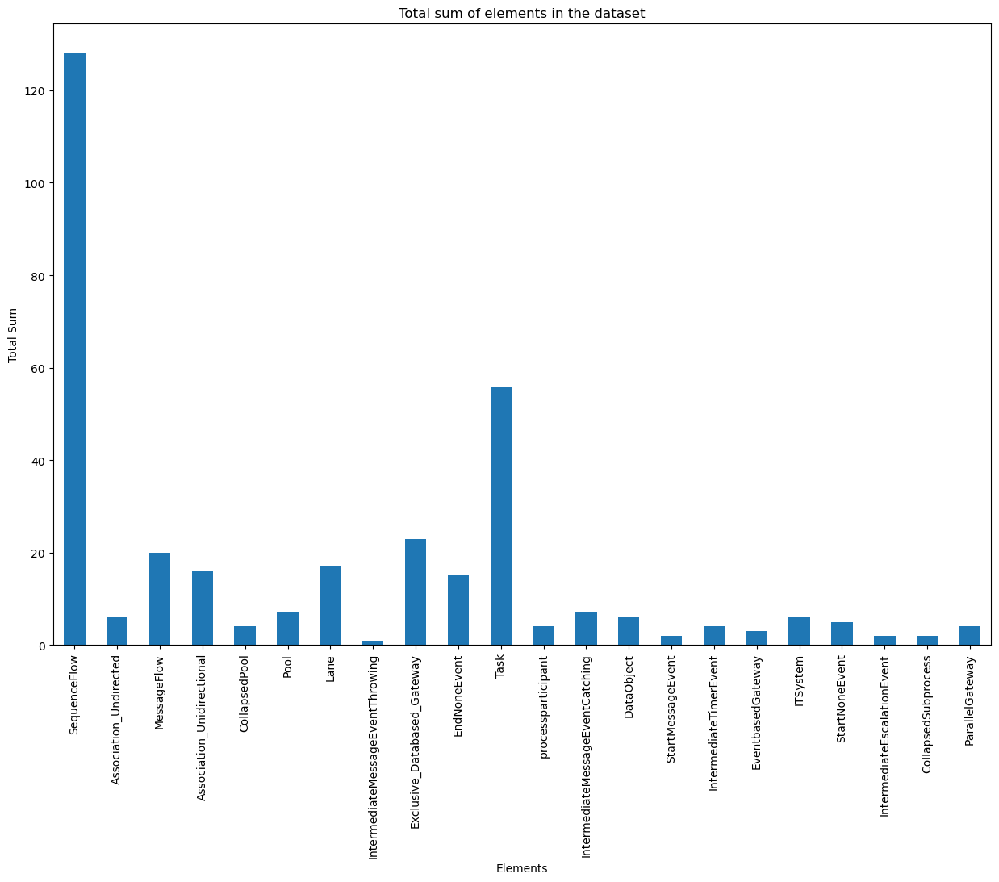

In [8]:
# Lets look at the cleaned dataframe:
plt.hist(df_cleaned['num_elements'], bins=50)  # You can adjust the number of bins
plt.title('Distribution of Number of Elements')
plt.xlabel('Number of Elements')
plt.ylabel('Frequency')
plt.show()

plt.hist(df_cleaned['label_length_max'], bins=50)  # You can adjust the number of bins
plt.title('Distribution of max label length')
plt.xlabel('Max label length')
plt.ylabel('Frequency')
plt.show()

plt.hist(df_cleaned['label_length_mean'], bins=50)  # You can adjust the number of bins
plt.title('Distribution of mean label length')
plt.xlabel('Mean label length')
plt.ylabel('Frequency')
plt.show()

plt.hist(df_cleaned['documentation_count'], bins=50)  # You can adjust the number of bins
plt.title('Distribution of documentation count')
plt.xlabel('Doc count')
plt.ylabel('Frequency')
plt.show()

elem_count = df_cleaned.elements_count
df_elem_count = pd.DataFrame(list(elem_count))
elem_count_sums = df_elem_count.sum()

# Plotting
plt.figure(figsize=(15, 10))
elem_count_sums.plot(kind='bar')
plt.title('Total sum of elements in the dataset')
plt.xlabel('Elements')
plt.ylabel('Total Sum')
plt.xticks(rotation=90)  # Rotates the labels on the x-axis for readability
plt.show()

# looks quite solid from my point of view

In [ ]:
# Lets look at this model in detail, seems good. We can ignore assocications, ITSytems and DataObject in the first run, they are seperated.
toBeTeileBeschaffen = df_cleaned[df_cleaned.model_json_name.apply(lambda x: x.strip() == "Teile beschaffen")]
print(toBeTeileBeschaffen["model_json"])

In [12]:
# Lets check a model with an EventSubprocess. We should exclude it because it seems like a too complex edge case
def get_count(item, count_label):
        if isinstance(item, pd.Series): 
            return item.get(count_label, 0)
        else:
            return 0

df_cleaned['event_sub_process_count'] = pd.DataFrame(df_cleaned['elements_count'].apply(lambda x: get_count(x,'EventSubprocess')))
toBeEventSubprocess = df_cleaned[(df_cleaned.event_sub_process_count >= 1)]
toBeEventSubprocessEntry = toBeEventSubprocess.iloc[0]
print(toBeEventSubprocessEntry["model_json"])

{"resourceId": "canvas", "properties": {"processowner": "Max Musterdiagramm", "name": "Employee Onboarding", "documentation": "The employee onboarding process deals with acquire new employees and the necessary knowledge, skills, and behaviors to become effective organizational members and insiders.", "auditing": "", "monitoring": "", "flat": "", "version": "", "author": "", "language": "English", "targetnamespace": "http://www.signavio.com/bpmn20", "expressionlanguage": "http://www.w3.org/1999/XPath", "typelanguage": "http://www.w3.org/2001/XMLSchema", "creationdate": "", "modificationdate": "", "itemdefinitions": "", "signals": "", "exporter": "", "exporterversion": "", "defaultprocessname": "", "properties": "", "properties2": "", "datainputs": "", "dataoutputs": "", "inputsets": "", "outputsets": "", "datainputset": "", "dataoutputset": "", "processtype": "None", "isclosed": "false", "isexecutable": "false", "processid": "", "orientation": "horizontal", "resources": "", "messages": 

In [38]:
# lets do the filtering for every file
def get_clean_df(index_path) -> pd.DataFrame:
    filename = csv_paths[index_path].name + ".pkl"
    return clean_df(pd.read_pickle(constants.DATA_ENRICHED / filename))

cleaned = []
for i in range(103):
    # looks equally distributed over the csvs
    cleaned.append(get_clean_df(i))

cleaned_concat = pd.concat(cleaned, axis=0)
cleaned_concat = cleaned_concat.drop_duplicates(subset=['model_json_name']) # that filters almost everything out, not sure how good that is
print("Number of entries after concatenating and droping duplicate names: ", cleaned_concat.shape[0])

Number of entries before cleaning:  5989
Number of entries after cleaning:  7
Number of entries before cleaning:  6044
Number of entries after cleaning:  9
Number of entries before cleaning:  6167
Number of entries after cleaning:  11
Number of entries before cleaning:  6030
Number of entries after cleaning:  10
Number of entries before cleaning:  6082
Number of entries after cleaning:  10
Number of entries before cleaning:  882
Number of entries after cleaning:  8
Number of entries before cleaning:  6068
Number of entries after cleaning:  12
Number of entries before cleaning:  6092
Number of entries after cleaning:  8
Number of entries before cleaning:  6003
Number of entries after cleaning:  10
Number of entries before cleaning:  6191
Number of entries after cleaning:  9
Number of entries before cleaning:  6024
Number of entries after cleaning:  8
Number of entries before cleaning:  6057
Number of entries after cleaning:  10
Number of entries before cleaning:  6000
Number of entries 

Number of entries after concatenating and droping duplicate names:  148


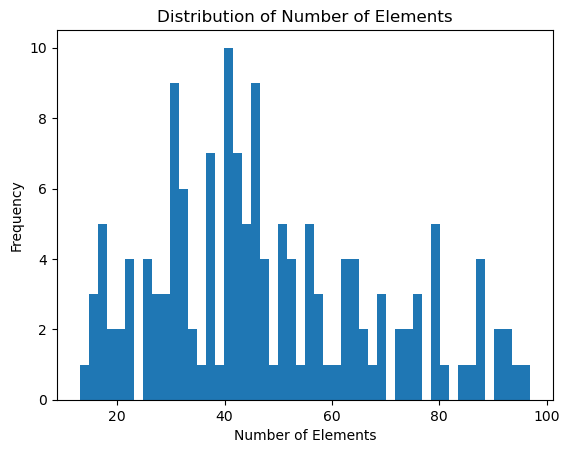

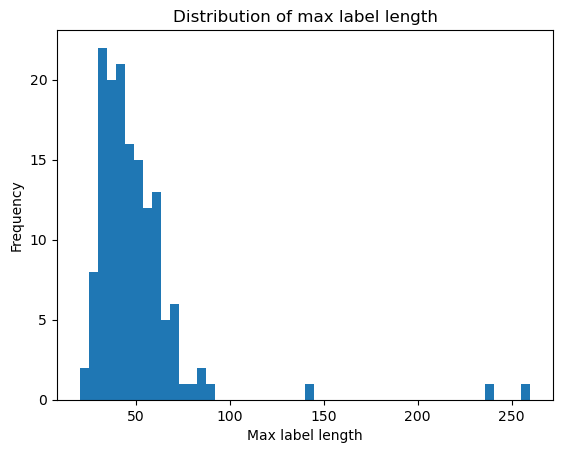

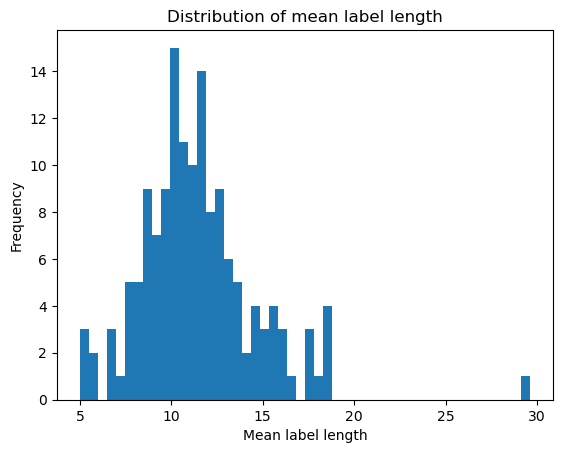

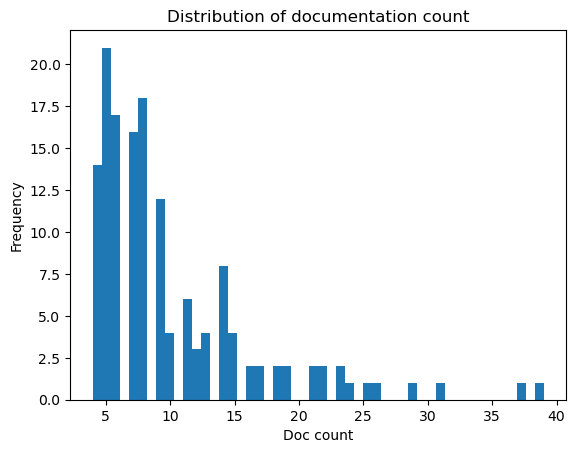

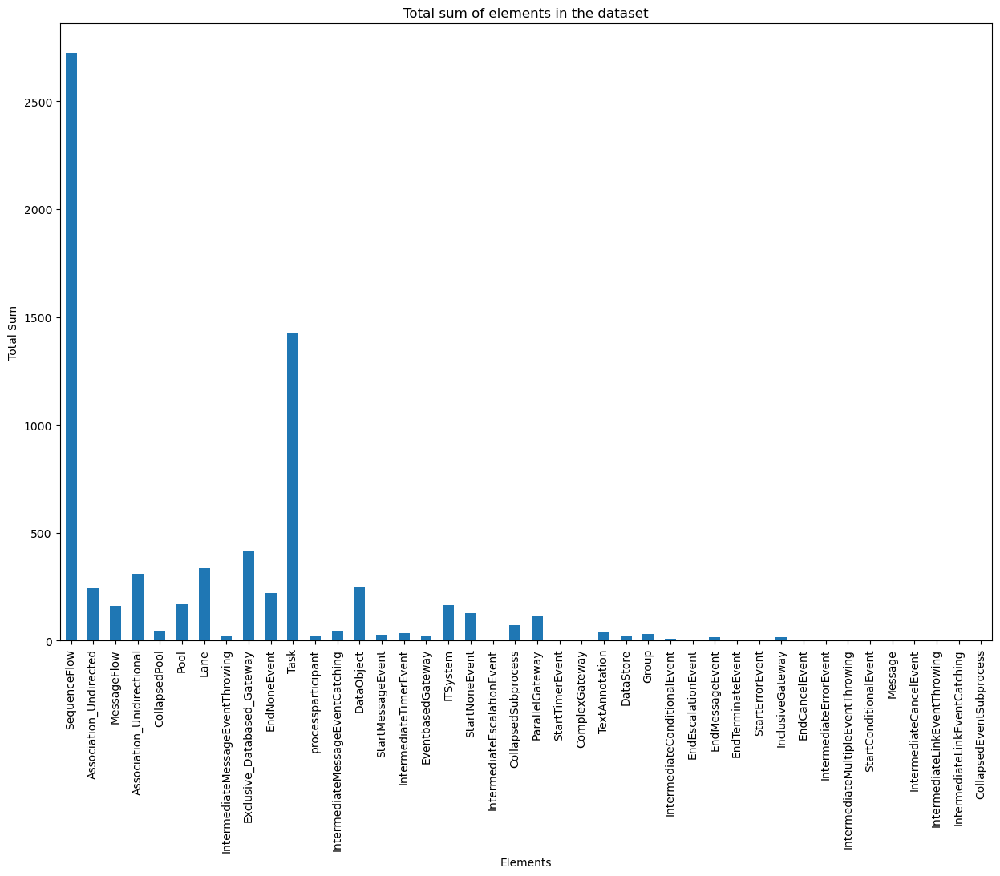

In [39]:
print("Number of entries after concatenating and droping duplicate names: ", cleaned_concat.shape[0])


# Lets look at the cleaned dataset:
plt.hist(cleaned_concat['num_elements'], bins=50)  # You can adjust the number of bins
plt.title('Distribution of Number of Elements')
plt.xlabel('Number of Elements')
plt.ylabel('Frequency')
plt.show()

plt.hist(cleaned_concat['label_length_max'], bins=50)  # You can adjust the number of bins
plt.title('Distribution of max label length')
plt.xlabel('Max label length')
plt.ylabel('Frequency')
plt.show()

plt.hist(cleaned_concat['label_length_mean'], bins=50)  # You can adjust the number of bins
plt.title('Distribution of mean label length')
plt.xlabel('Mean label length')
plt.ylabel('Frequency')
plt.show()

plt.hist(cleaned_concat['documentation_count'], bins=50)  # You can adjust the number of bins
plt.title('Distribution of documentation count')
plt.xlabel('Doc count')
plt.ylabel('Frequency')
plt.show()

elem_count = cleaned_concat.elements_count
df_elem_count = pd.DataFrame(list(elem_count))
elem_count_sums = df_elem_count.sum()

# Plotting
plt.figure(figsize=(15, 10))
elem_count_sums.plot(kind='bar')
plt.title('Total sum of elements in the dataset')
plt.xlabel('Elements')
plt.ylabel('Total Sum')
plt.xticks(rotation=90)  # Rotates the labels on the x-axis for readability
plt.show()

# looks quite solid from my point of view

In [40]:
# Lets apply the sytax check
print("Number of entries before syntax check: ", cleaned_concat.shape[0])
no_syntax_error = cleaned_concat[cleaned_concat.apply(has_no_syntax_error, axis=1)]
print("Number of entries after removing non-syntax compliant models: ", no_syntax_error.shape[0])

Number of entries before syntax check:  148
Number of entries after removing non-syntax compliant models:  138


In [86]:
# name of bpmn models that were manually detected to have a bad quality and should therefore be excluded
blacklist = [
    "Employee Onboarding",
    "Auto Replenishment Process",
    "Bidding Process",
    "Make new appointment for cancelled infusion",
    "Receive Payment",
    "SyntBots ProcessRecorder Test",
    "Illustrate a unique instance of DV incident",
    "MEP2",
    "Reise buchen",

    "3D CAD-Modell der Maschine entwickeln",        # the following models have stacked lanes (lanes in lanes in pools)
    "Prozessmodellfreigabe",                        # would be great to filter these automatically or support them in the future
    "mechanische Stückliste fertigstellen",
    "Editorial Examination",
    "Detailkonstruktion Elektrik durchführen",
    "Process model prolongation",
    "Process creation / discovery",
    "Full-Kit Kriterien prüfen",
    "Kredit-Prozess",
    "Entwicklung Steuerungstechnik",
    "Process discovery",
    "Mitzeichnungsvermerk weiterleiten"
]

def is_not_blacklisted(name):
    name_striped =name.strip()
    name_striped = name_striped.replace('\n',' ')
    if(name_striped in blacklist):
        return False
    else:
        return True

print("Number of entries before checking blacklist: ", no_syntax_error.shape[0])
not_blacklisted  = no_syntax_error[no_syntax_error.model_json_name.apply(is_not_blacklisted)]
print("Number of entries after removing blacklisted models: ", not_blacklisted.shape[0])

Number of entries before checking blacklist:  138
Number of entries after removing blacklisted models:  123


In [23]:
# This one seems to have multiple lanes in each other, lets look at it further
# A pool has two lanes. In one of the lanes is another lane. 
toBeMechStueckFertigstellen = cleaned_concat[cleaned_concat.model_json_name.apply(lambda x: x.strip() == "mechanische Stückliste fertigstellen")]
toBeMechStueckFertigstellenEntry = toBeMechStueckFertigstellen.iloc[0]

# we do not support this kind of model today but could in the future
# an idea is to adapt the schema that we have a seperated list for lanes and do not stack them into the pools

print(toBeMechStueckFertigstellenEntry["model_json"])

{"resourceId": "sid-ABB1D315-1A64-406C-AFA8-E08E7CD7F35D", "formats": {}, "ssextensions": [], "bounds": {"upperLeft": {"x": 0, "y": 0}, "lowerRight": {"x": 4934.679352906454, "y": 2841.7399034224095}}, "stencilset": {"namespace": "http://b3mn.org/stencilset/bpmn2.0#", "url": "/stencilsets/bpmn2.0/bpmn2.0.json"}, "stencil": {"id": "BPMNDiagram"}, "properties": {"orientation": "horizontal", "targetnamespace": "http://www.signavio.com", "title": "sid-ABB1D315-1A64-406C-AFA8-E08E7CD7F35D", "exporterversion": "14.13.1", "expressionlanguage": "http://www.w3.org/TR/XPath", "revisionid": "f24ef082166b4dc18a660ffb0072bcb8", "exporter": "Signavio Process Editor, http://www.signavio.com", "bpmn2_definitionsid": "sid-81796ea6-928b-410b-96c5-9c7075495b81", "meta-iso9001relevant": "", "prozessreifegrad": "", "processgoal": "", "name": "mechanische St\u00fcckliste fertigstellen", "meta-iso14001relevant": "", "typelanguage": "http://www.w3.org/2001/XMLSchema", "meta-prozessverantwortlicher": ""}, "chi

Name:  Receipt of application
setup folder
MMV aaa


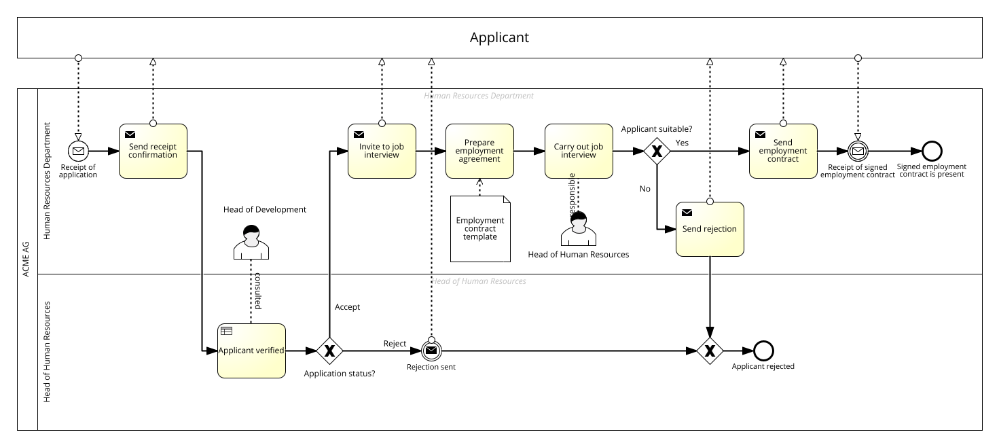

Name:  Procurement of work equipment
setup folder
MMV aaa


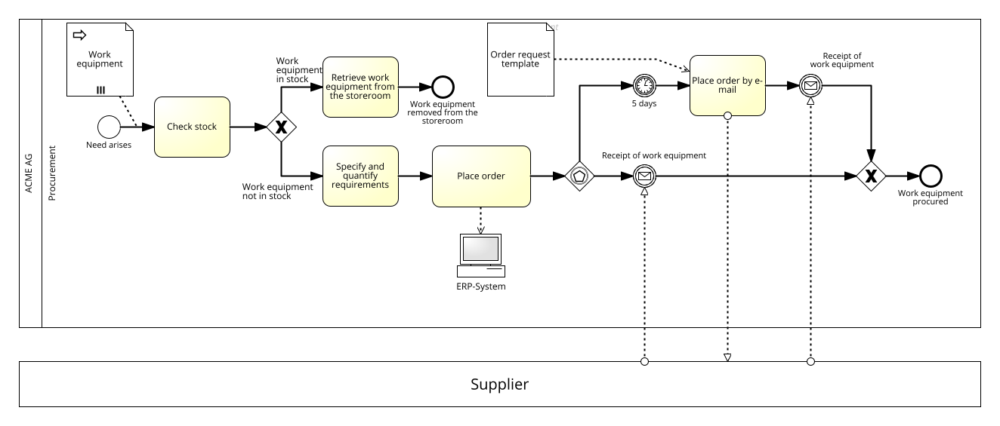

Name:  Procure parts
setup folder
MMV aaa


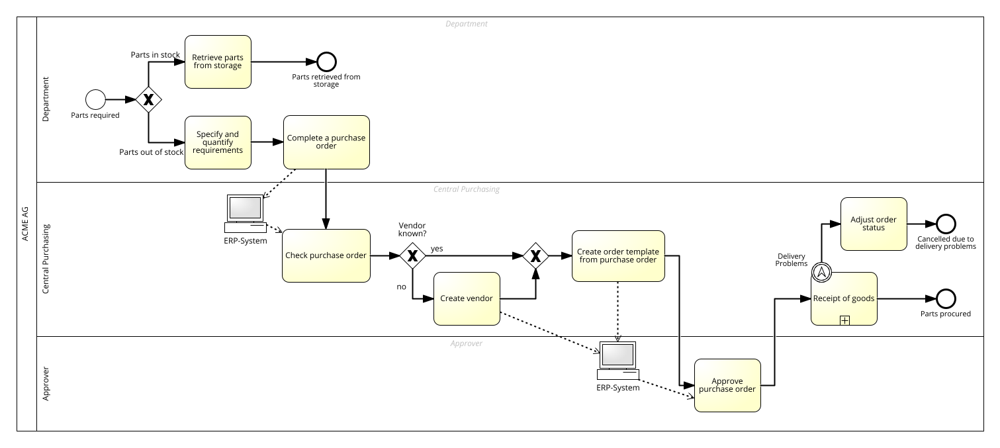

Name:  Arbeitsmittel beschaffen
setup folder
MMV aaa


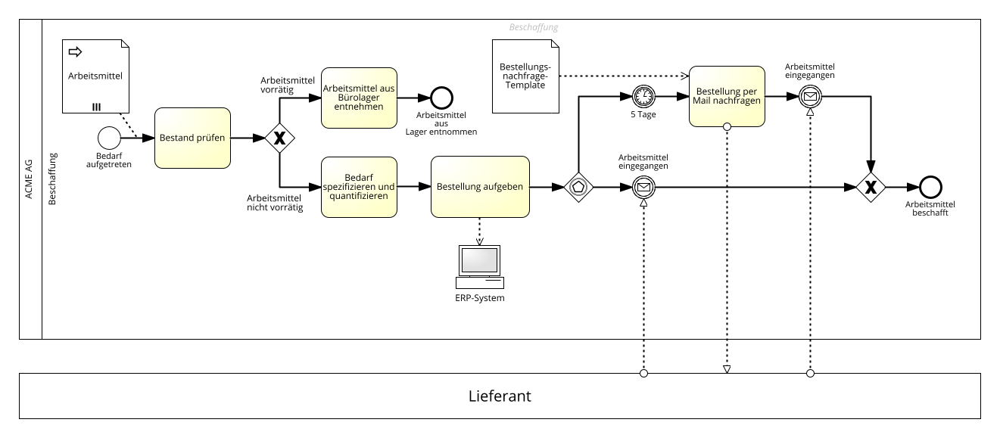

Name:  Bewerbungseingang

setup folder
MMV aaa


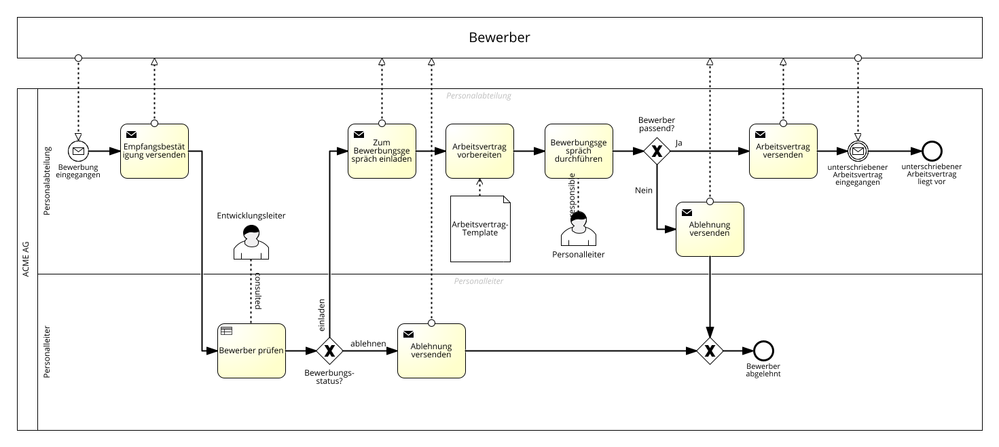

Name:  Teile beschaffen
setup folder
MMV aaa


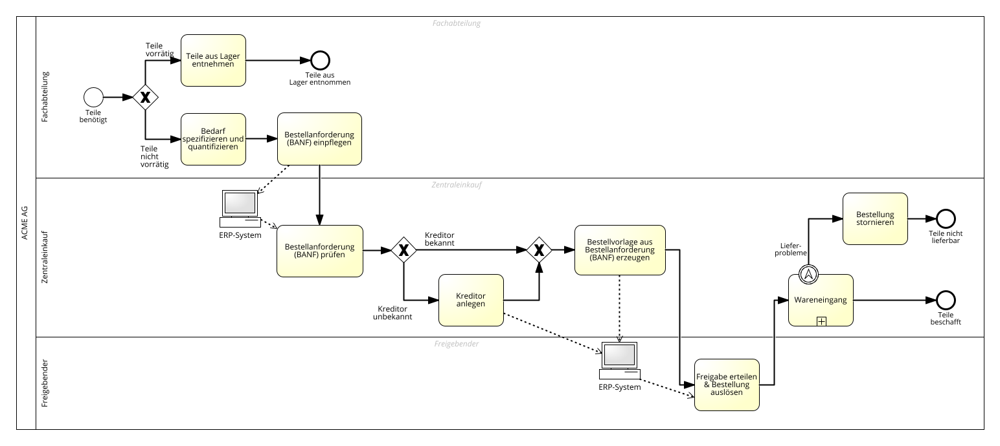

Name:  
setup folder
MMV aaa


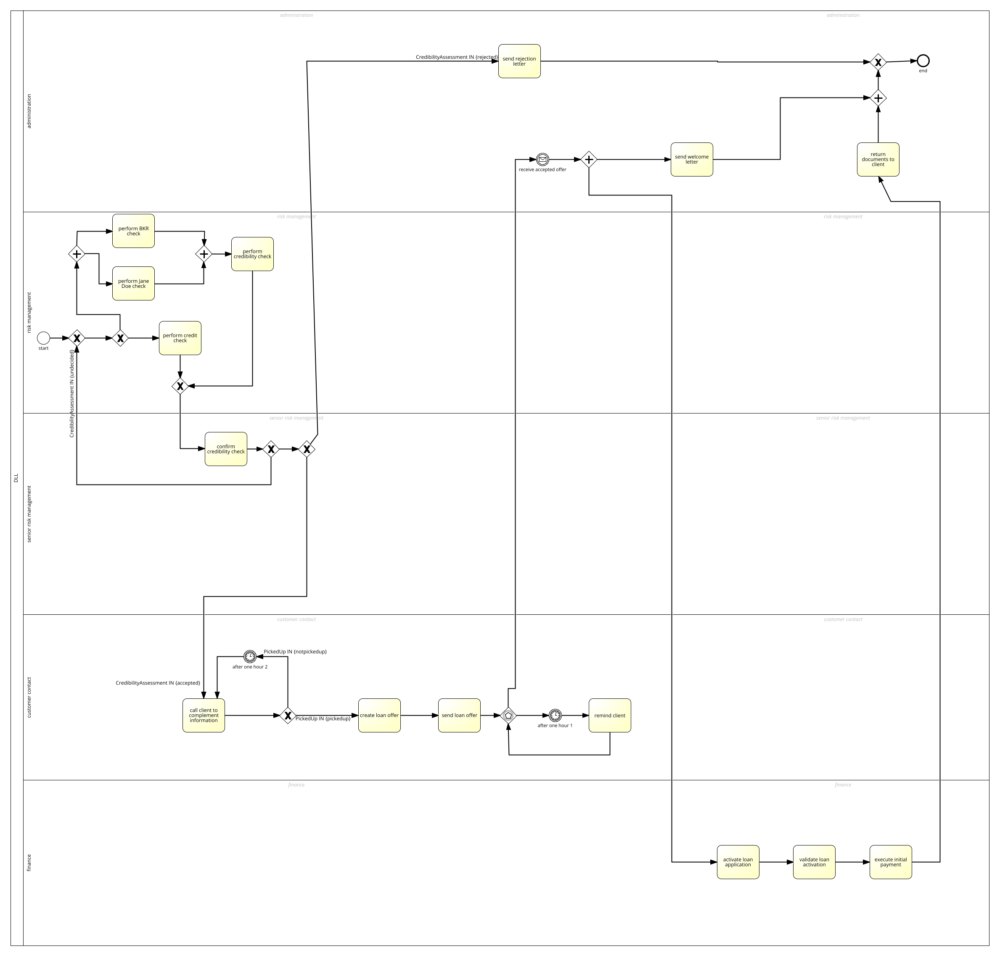

Name:  Reise buchen
setup folder
MMV aaa


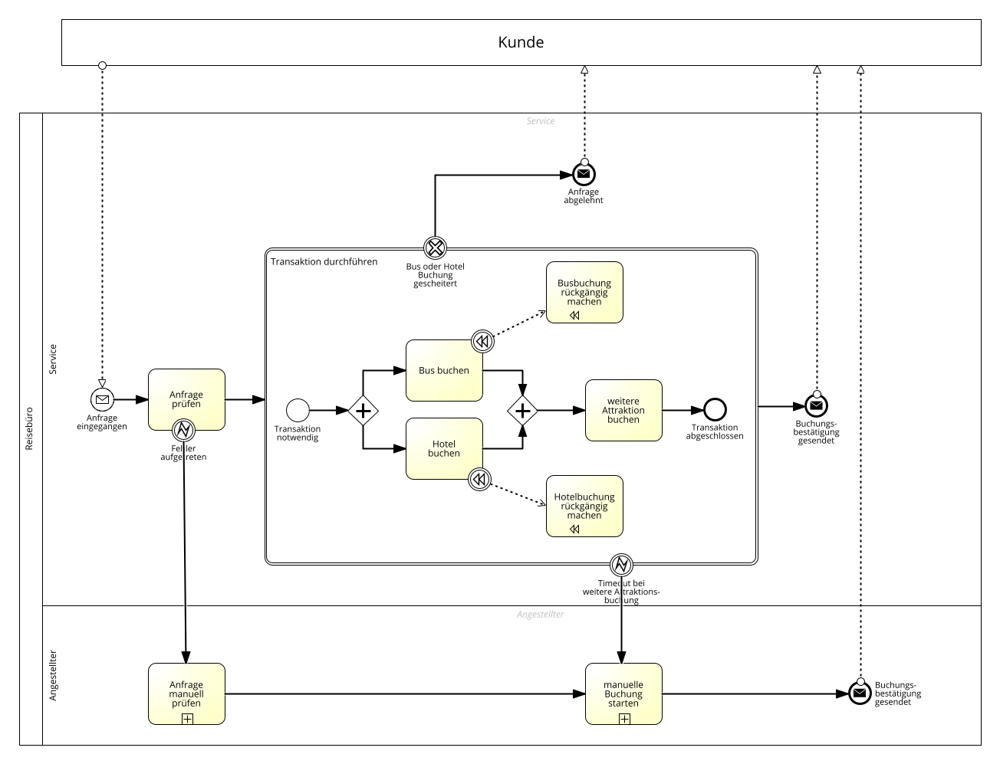

Name:  administrator

setup folder
MMV aaa


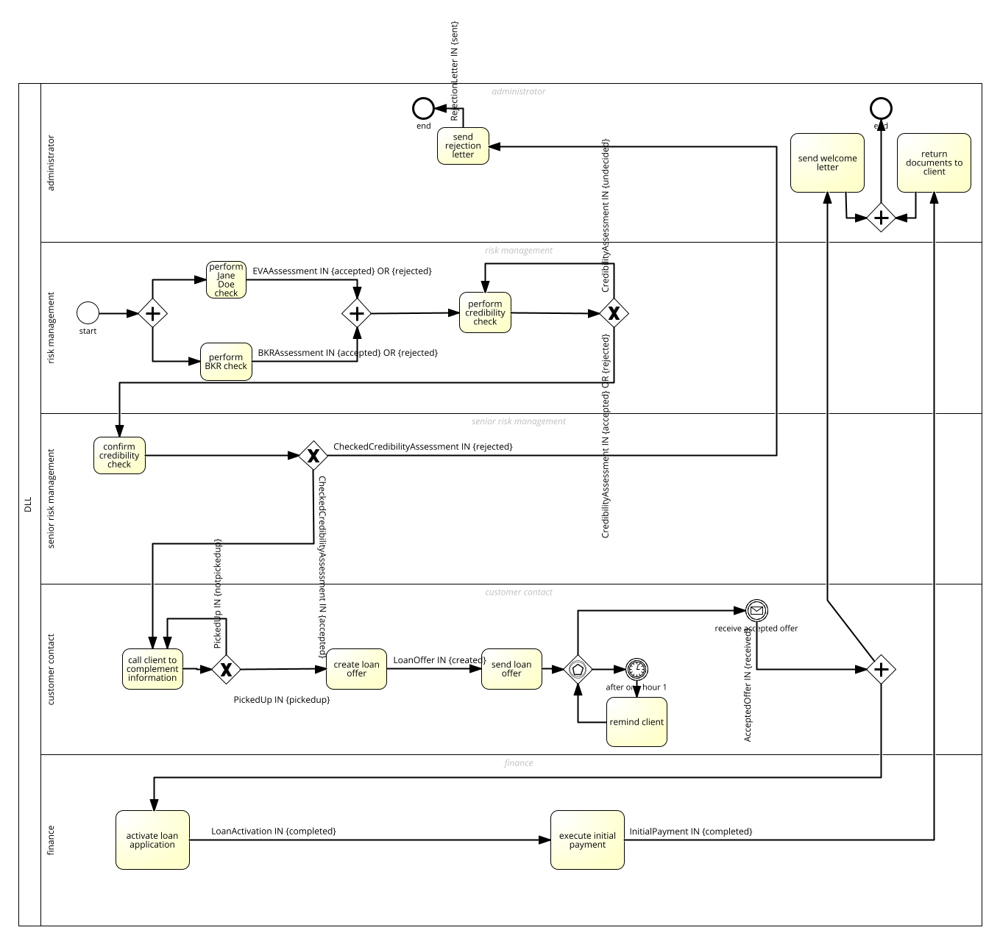

Name:  base model (adjusted_V1)
setup folder
MMV aaa


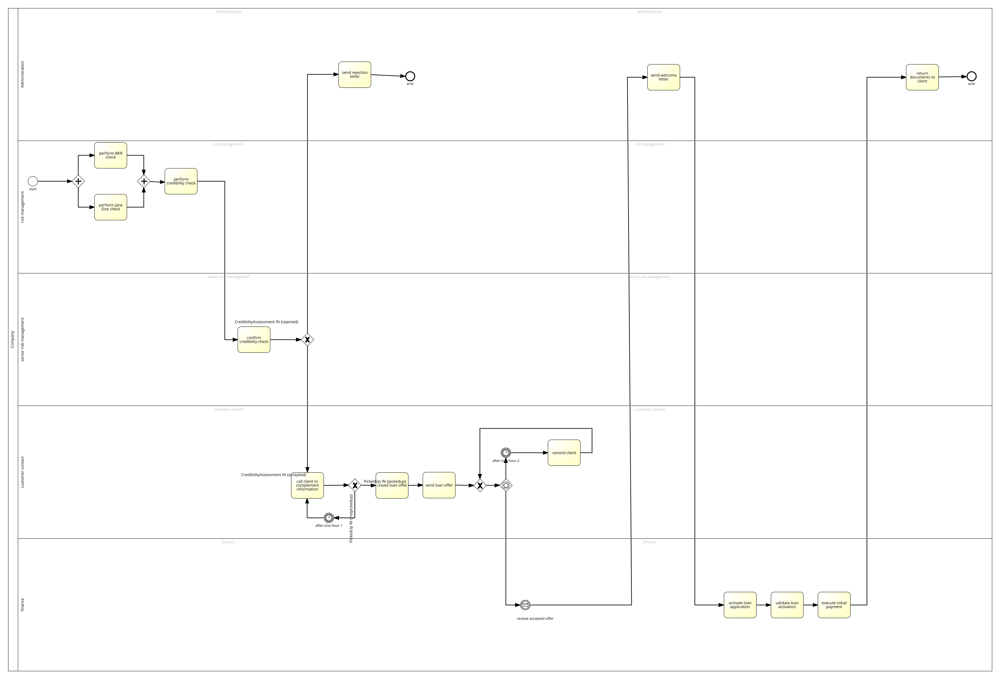

Name:  11. Quick-Model-Prozess
setup folder
MMV aaa


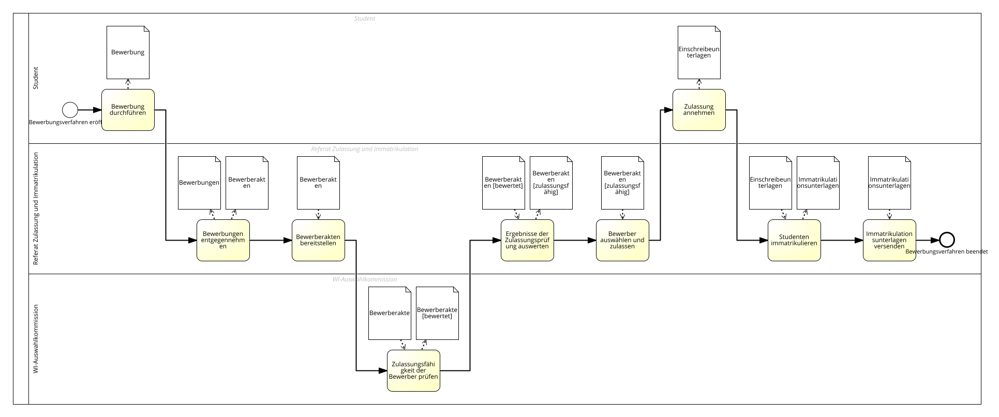

Name:  vaja3
setup folder
MMV aaa


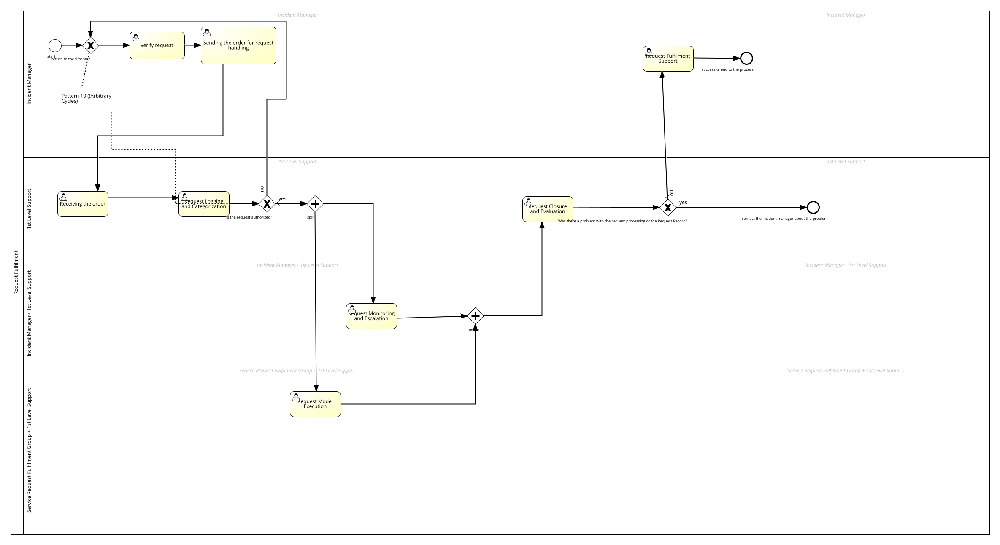

Name:  Programm-Menü-AOG
setup folder
MMV aaa


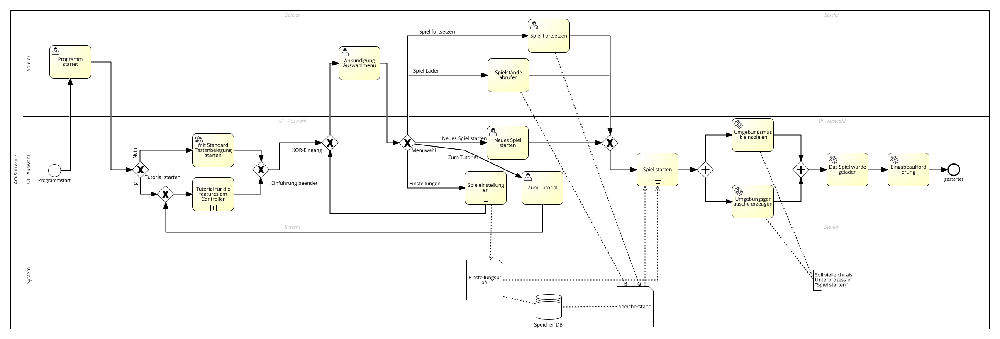

Name:  Projektdurchführung (Soll-Prozess)
setup folder
MMV aaa


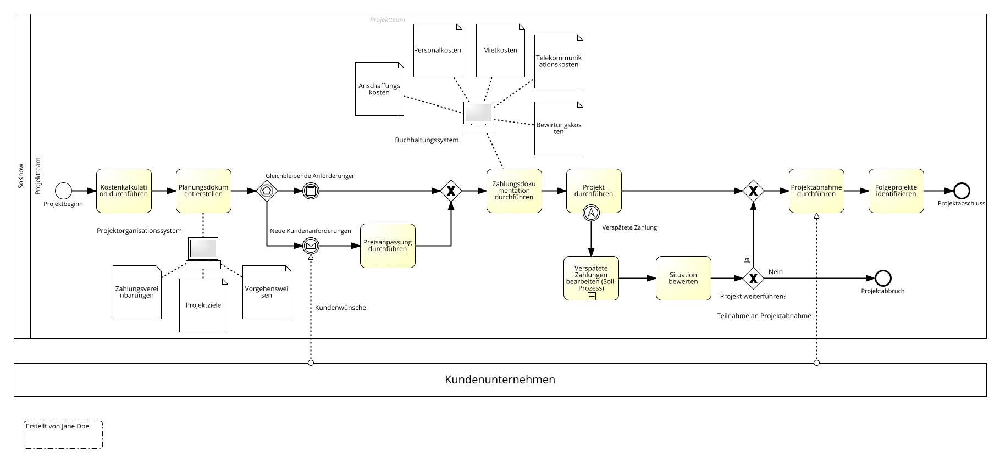

Name:  Wareneingang
setup folder
MMV aaa


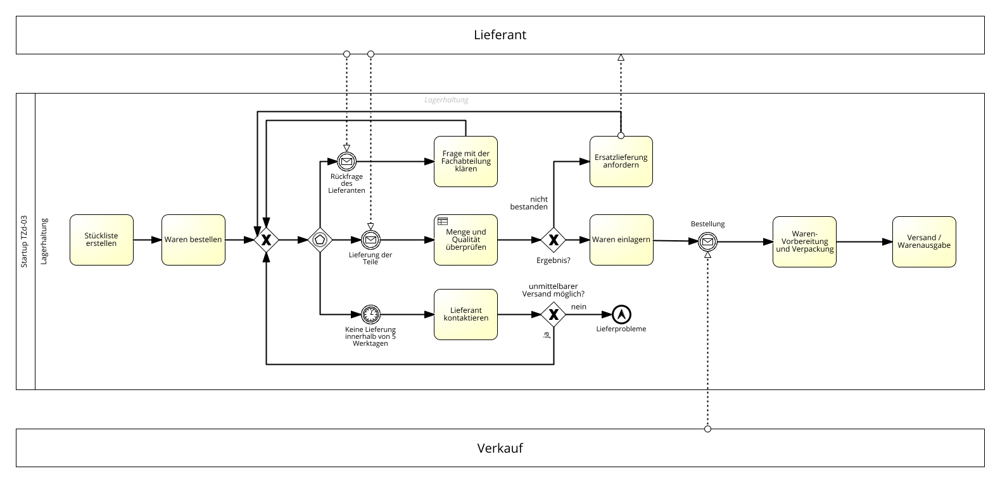

Name:  Studenten Projekt
setup folder
MMV aaa


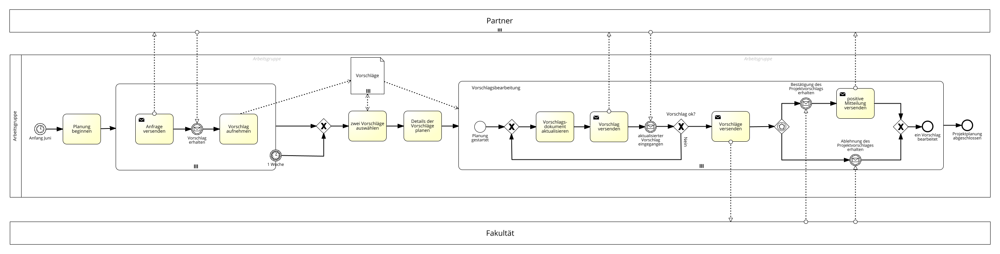

Name:  Seller receives  buyer's message and  resends the order
setup folder
MMV aaa


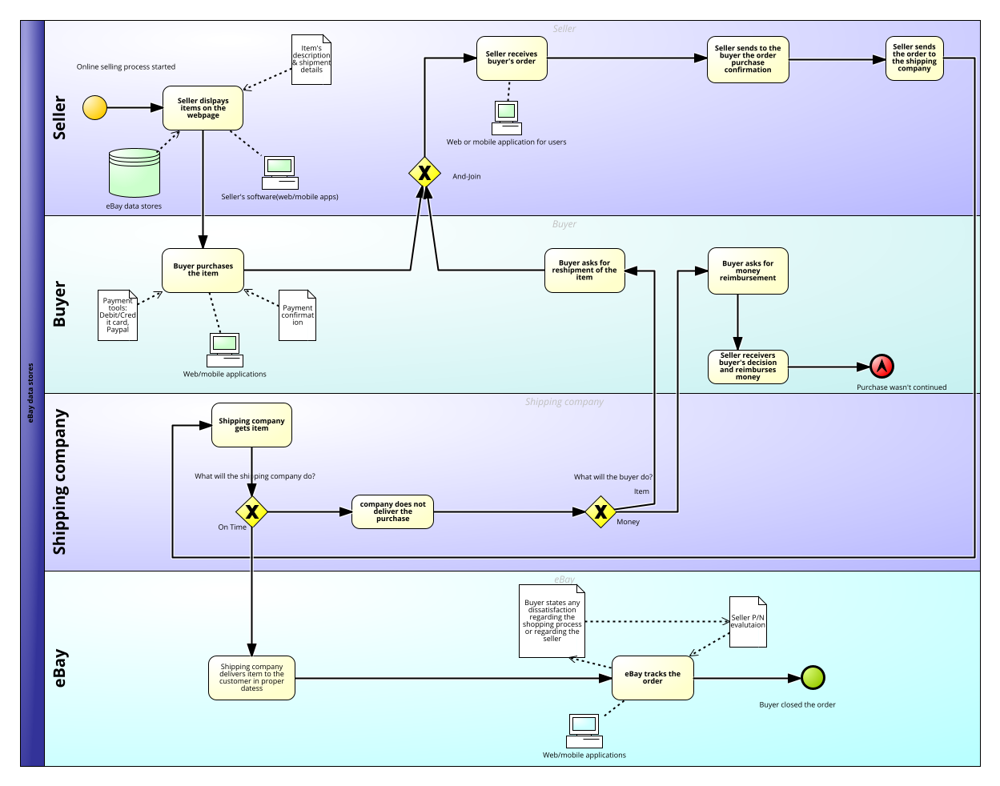

Name:  Problem lösen
setup folder
MMV aaa


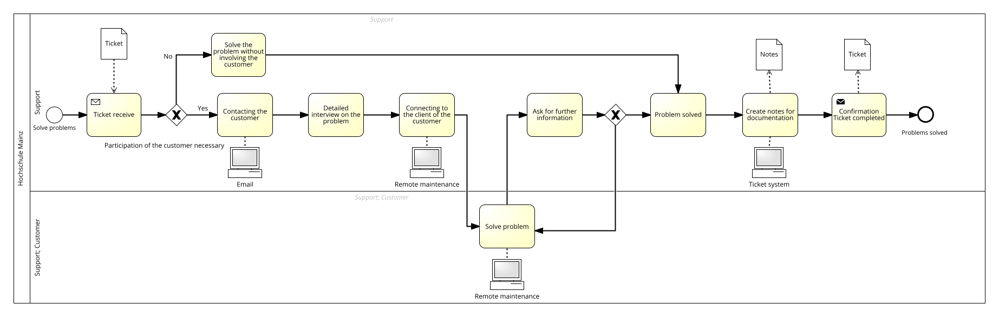

Name:  Lernfortschritt
setup folder
MMV aaa


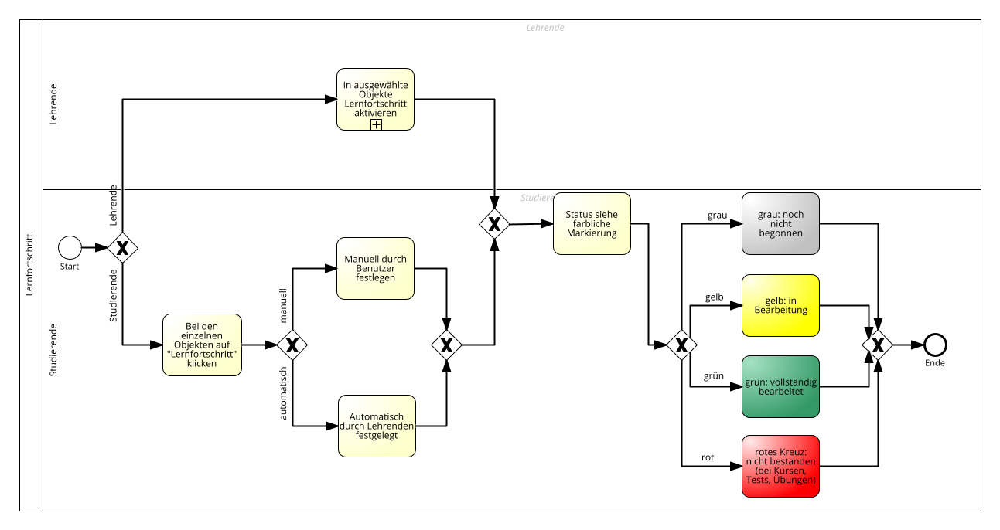

Name:  Personal Email Account Creation.
setup folder
MMV aaa


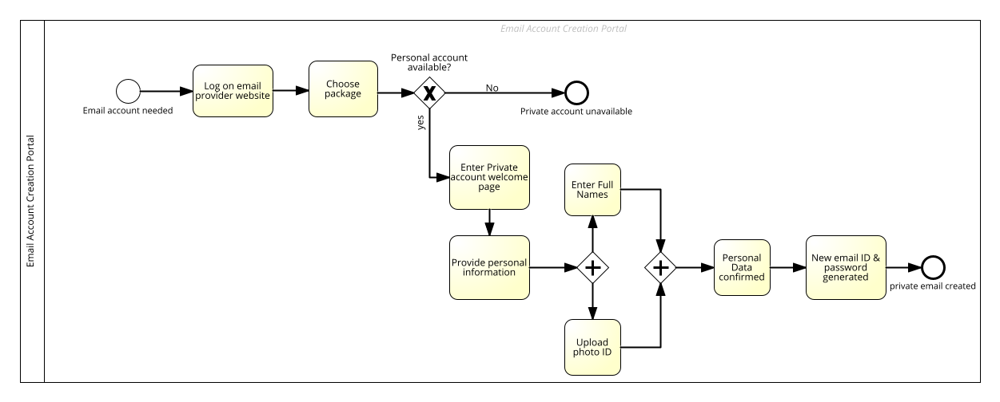

Name:  PC zusammenbauen
setup folder
MMV aaa


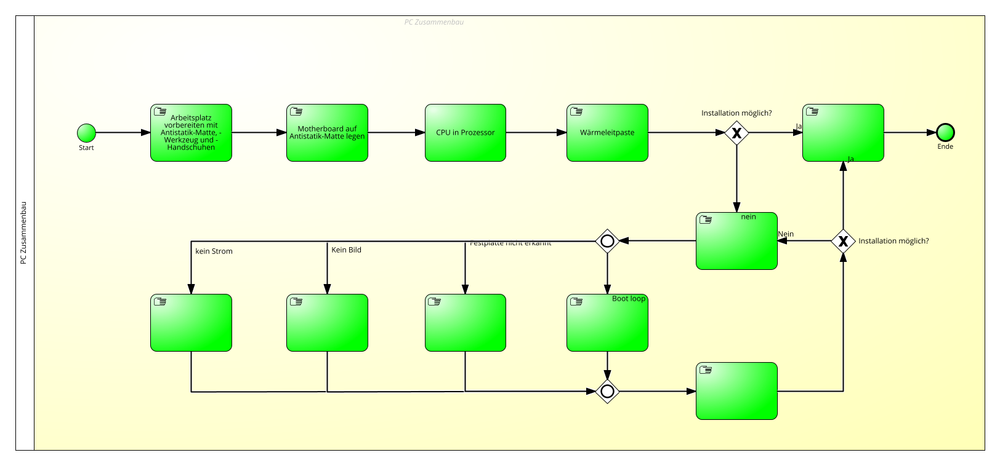

Name:  Administrator
setup folder
MMV aaa


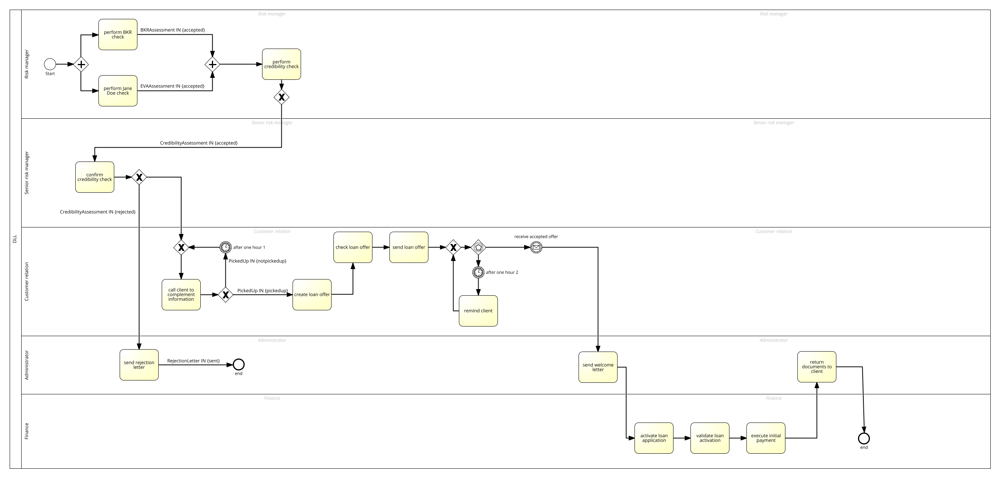

Name:  Kundenservice (Soll-Prozess)
setup folder
MMV aaa


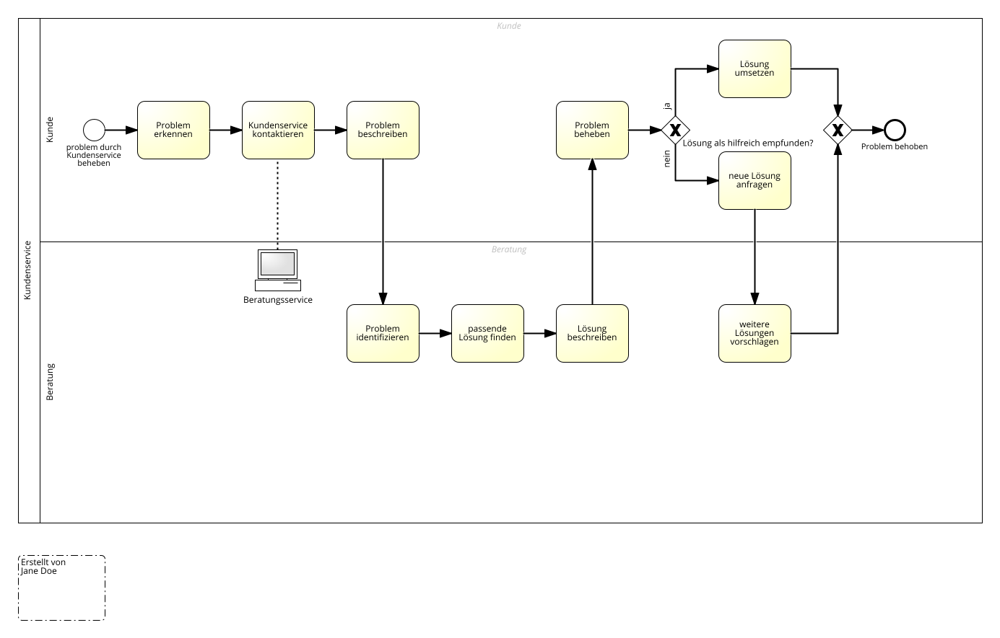

Name:  start to prepare cooking paper
setup folder
MMV aaa


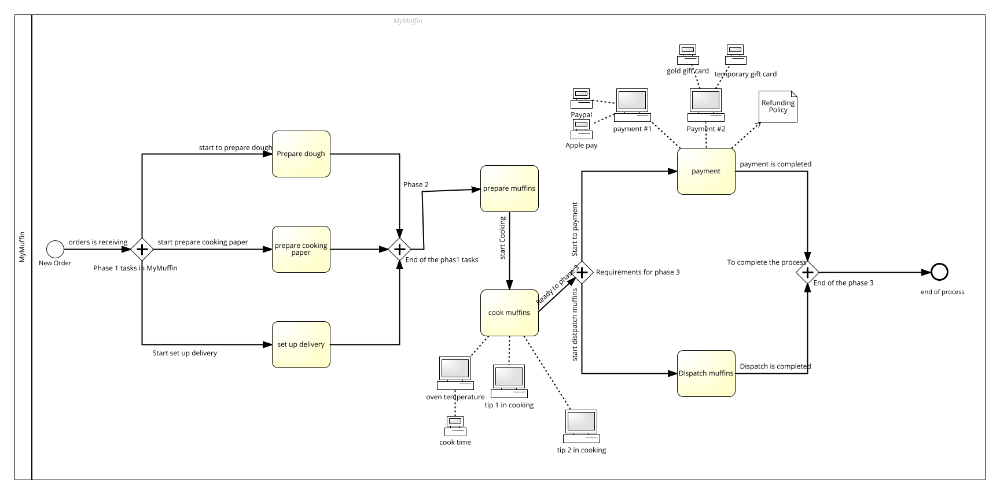

Name:  Registration
setup folder
MMV aaa


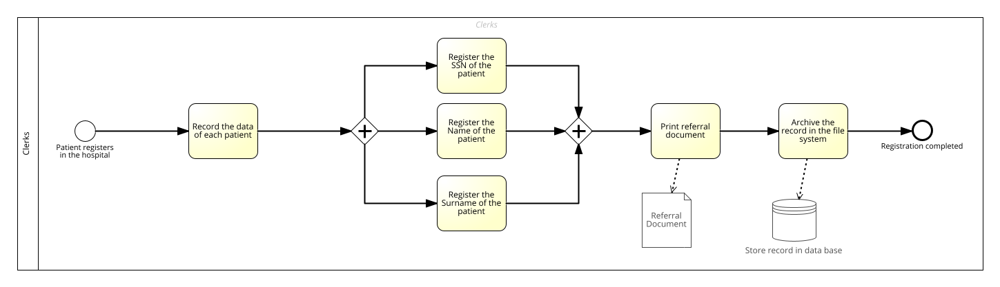

Name:  Short-term Treatment
setup folder
MMV aaa


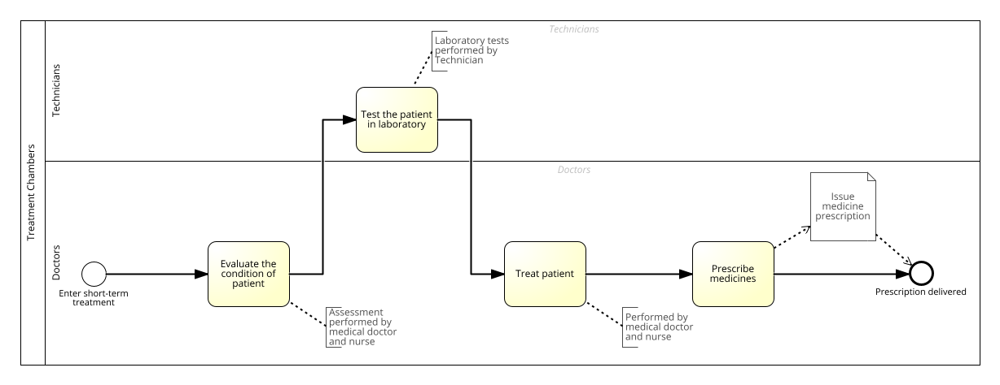

Name:  3D CAD-Modell der Maschine entwickeln
setup folder
MMV aaa


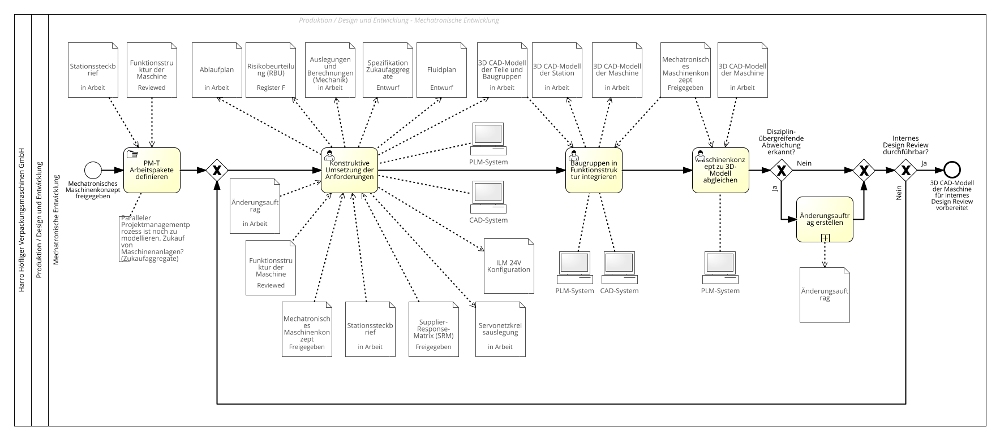

Name:  Erstellung der Web Seiten (Soll-Prozess)
setup folder
MMV aaa


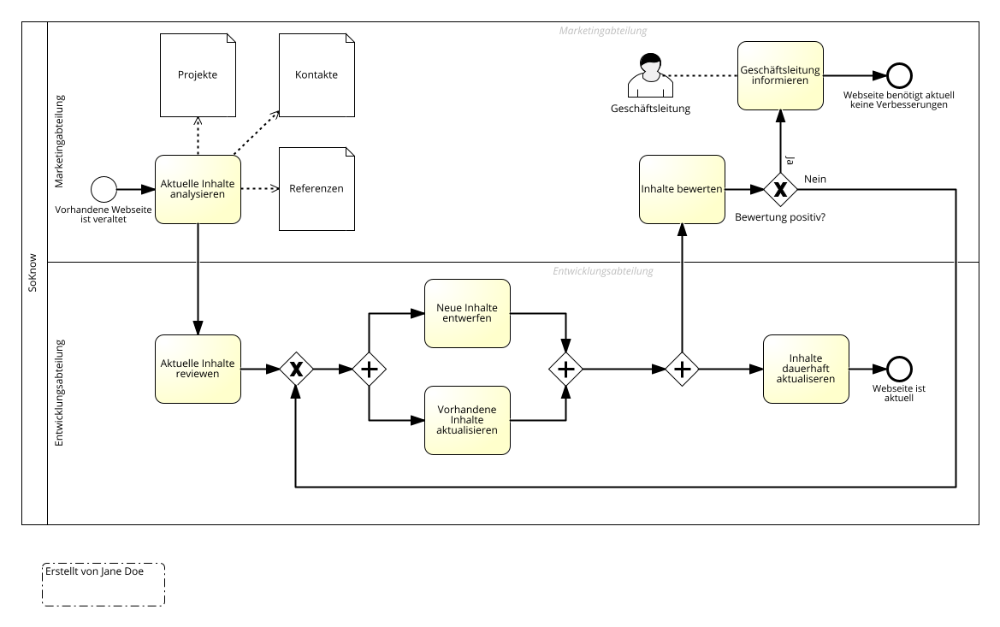

Name:  Kreditinstitut
setup folder
MMV aaa


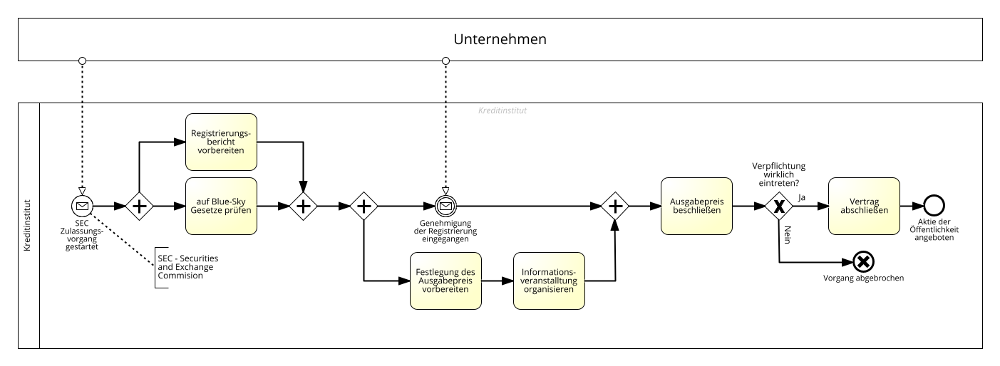

Name:  Prozessmodellfreigabe
setup folder
MMV aaa


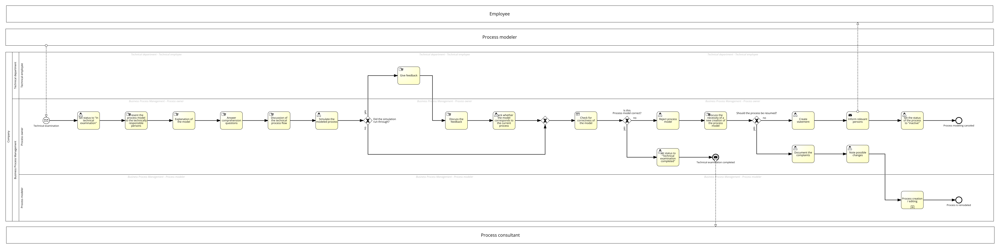

Name:  Verspätete Zahlungen bearbeiten (Soll-Prozess)
setup folder
MMV aaa


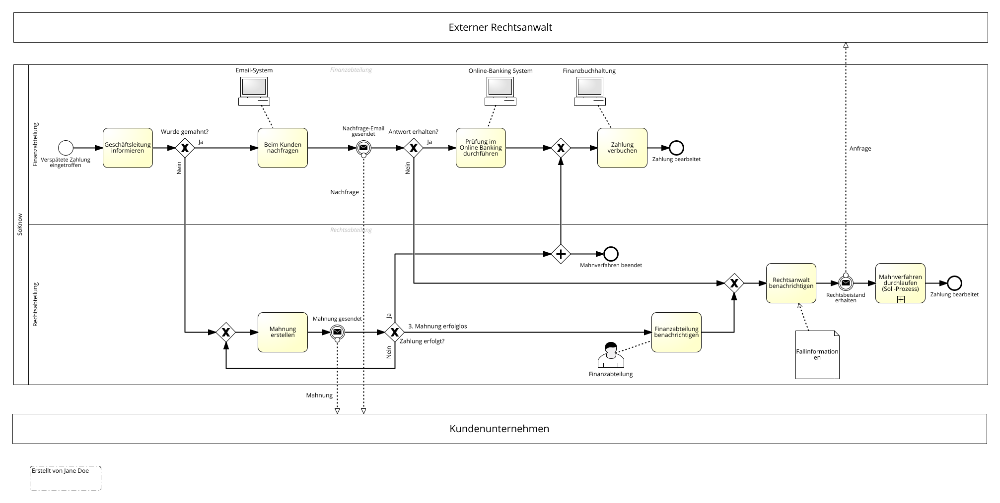

Name:  Konfliktmanagement-Soll
setup folder
MMV aaa


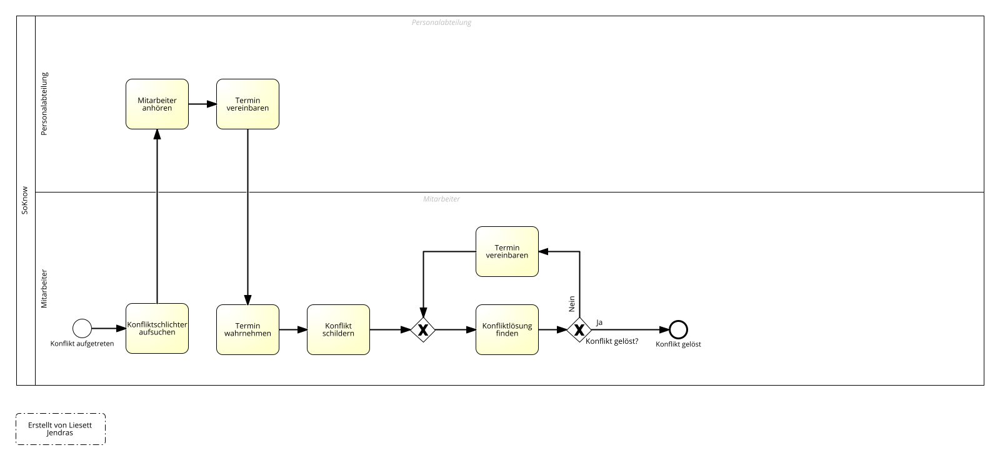

Name:  Entwicklung von Open Source Projekten (Soll-Prozess)
setup folder
MMV aaa


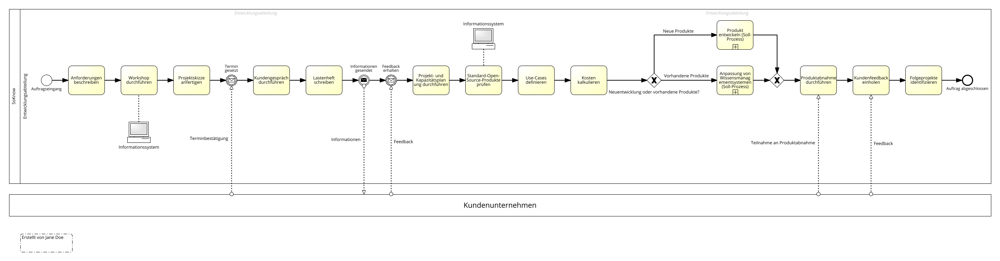

Name:  Hotel Service
setup folder
MMV aaa


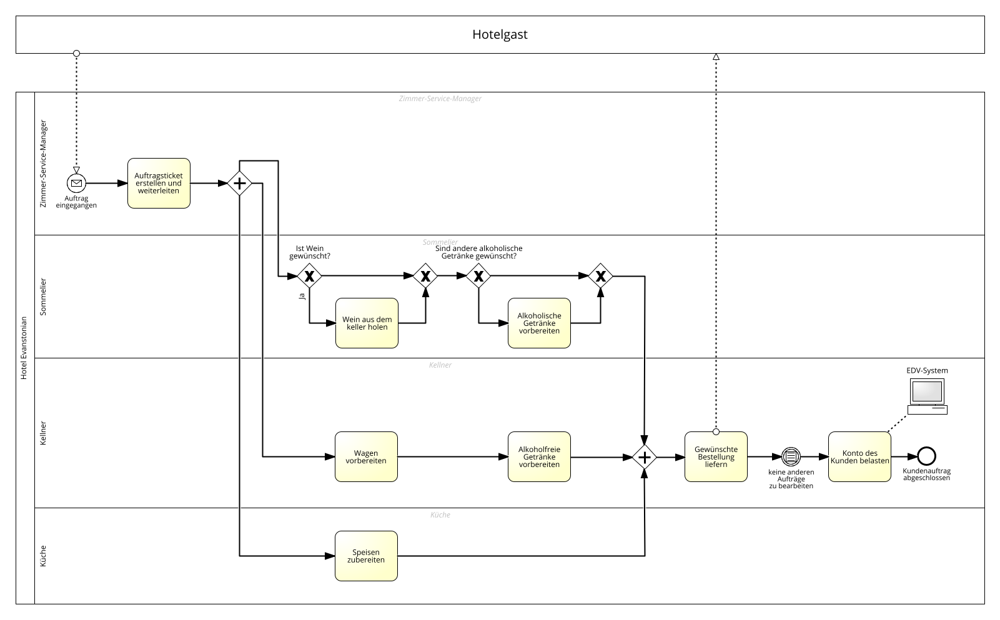

Name:  Client
setup folder
MMV aaa


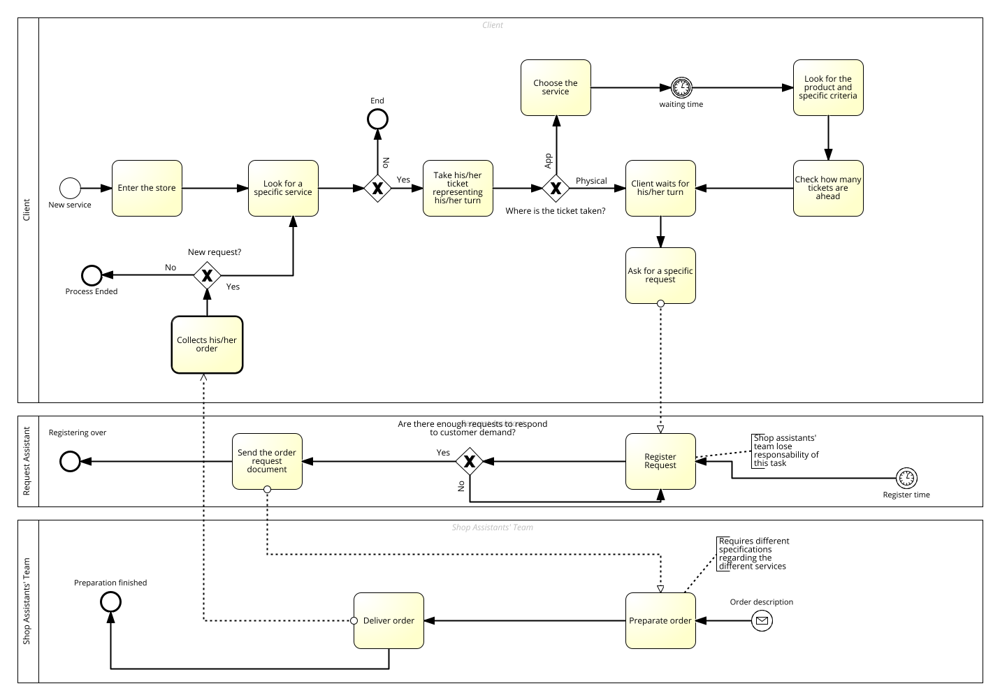

Name:  mechanische Stückliste fertigstellen
setup folder
MMV aaa


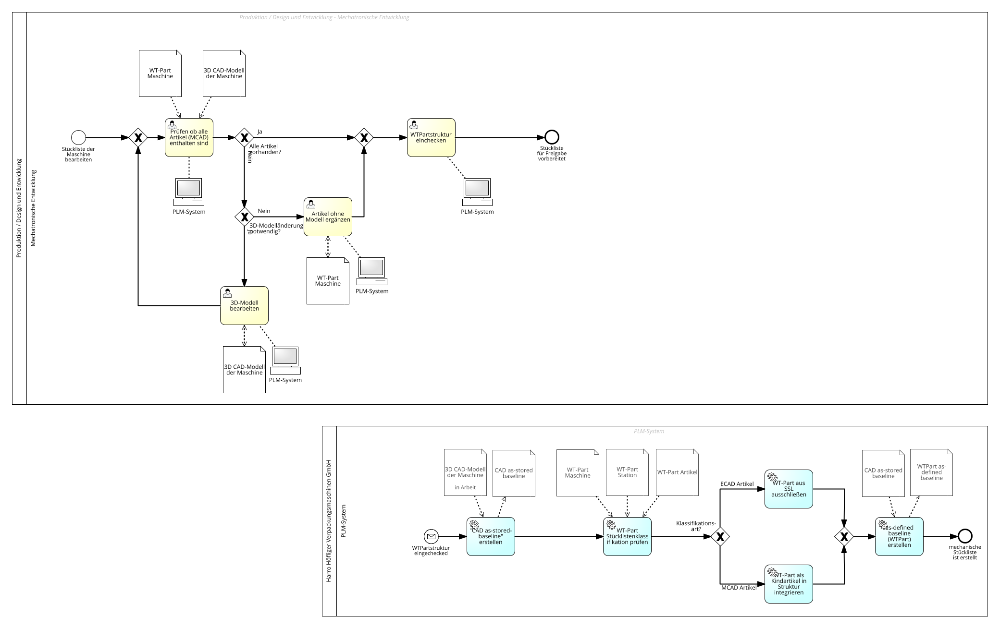

Name:  t B2B service nodes deployment (installation)
setup folder
MMV aaa


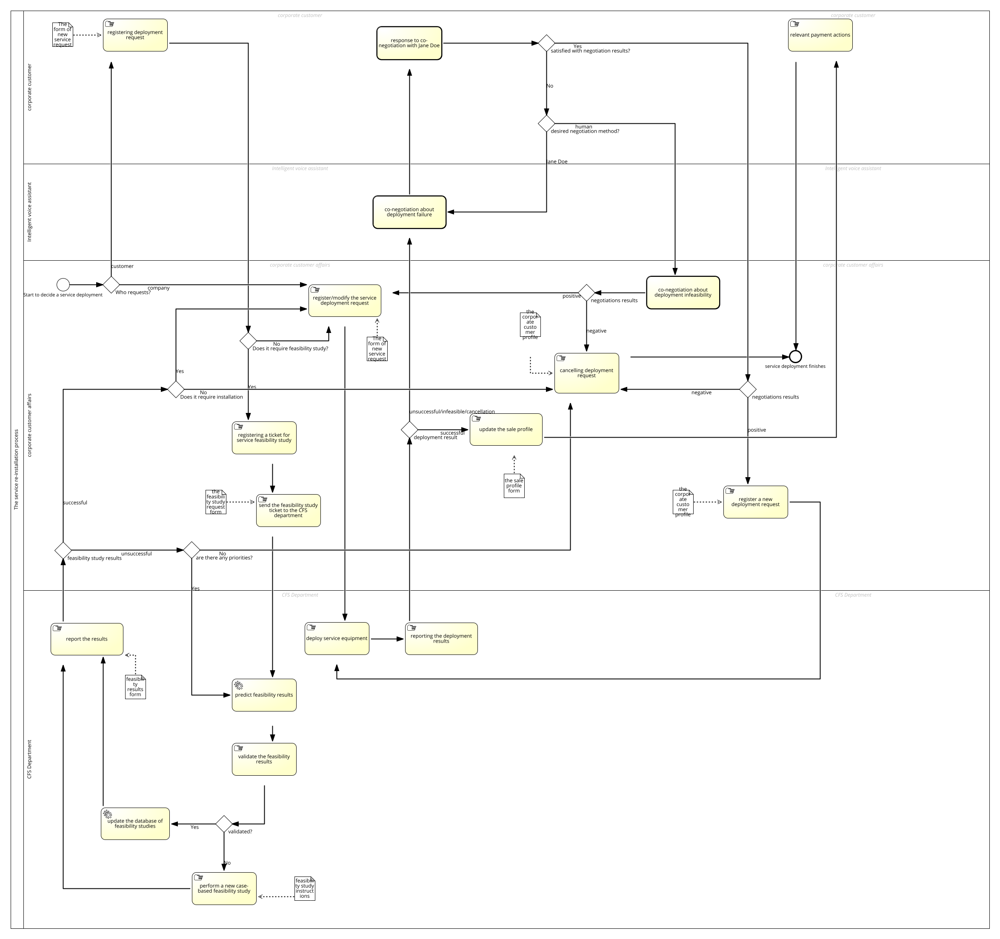

Name:  BPMN Pflege Klinikum Brandenburg
setup folder
MMV aaa


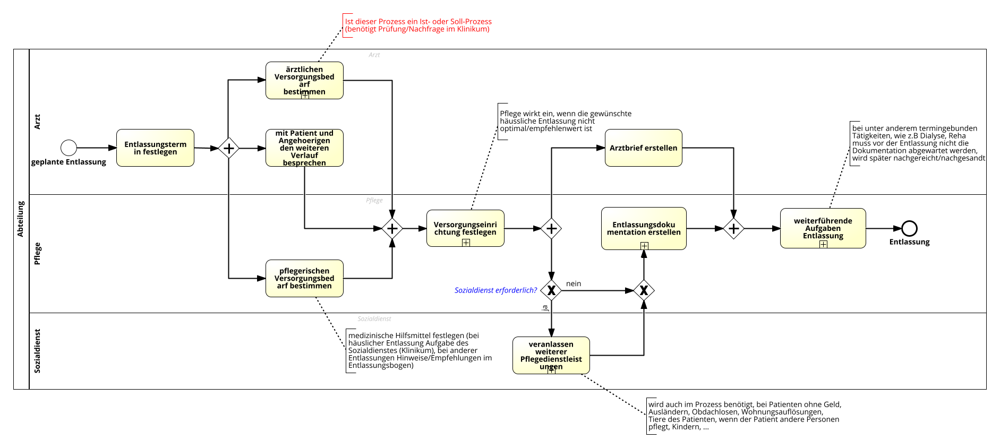

Name:  Neue Technologien herausfinden Strategie (Ist-Prozess)
setup folder
MMV aaa


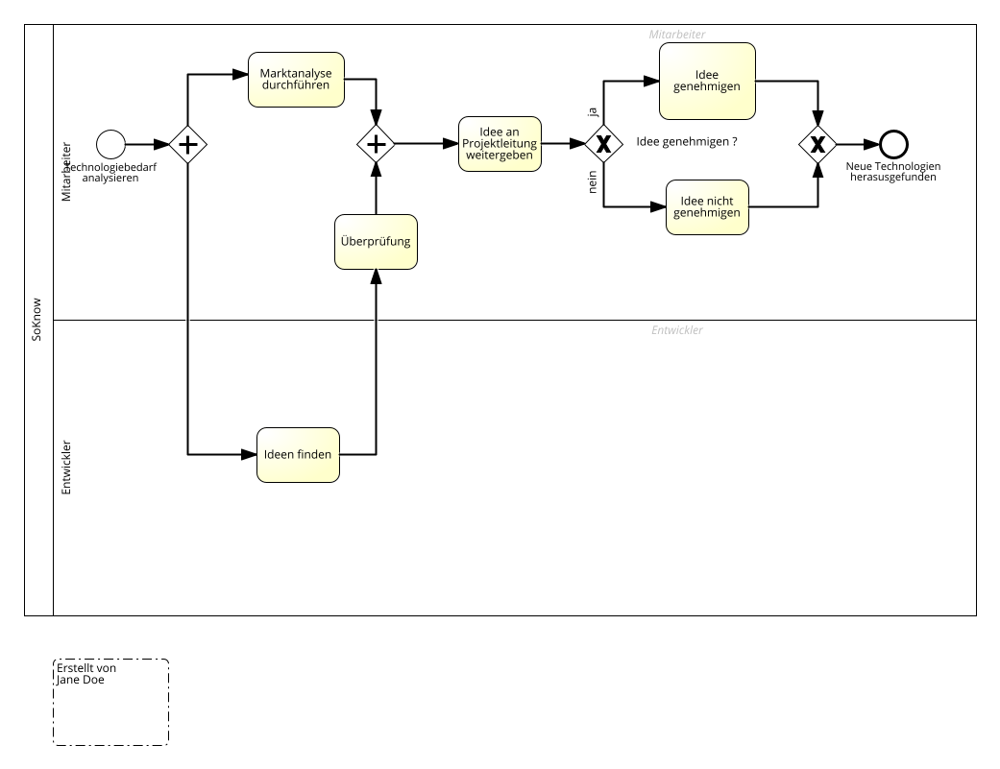

Name:  Software erstellen
setup folder
MMV aaa


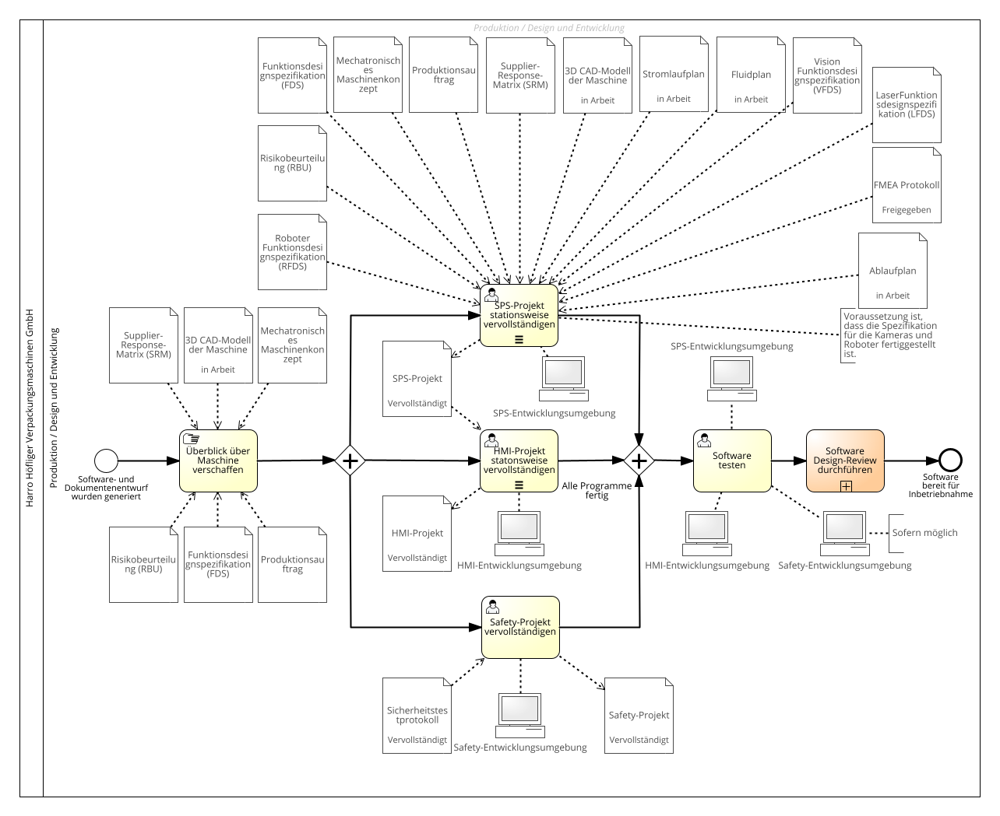

Name:  Risk Management

setup folder
MMV aaa


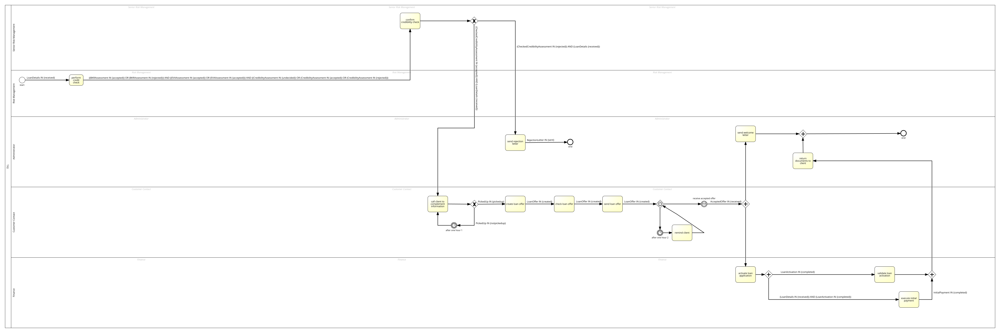

Name:  Beratungsleistung formulieren (Soll-Prozess)
setup folder
MMV aaa


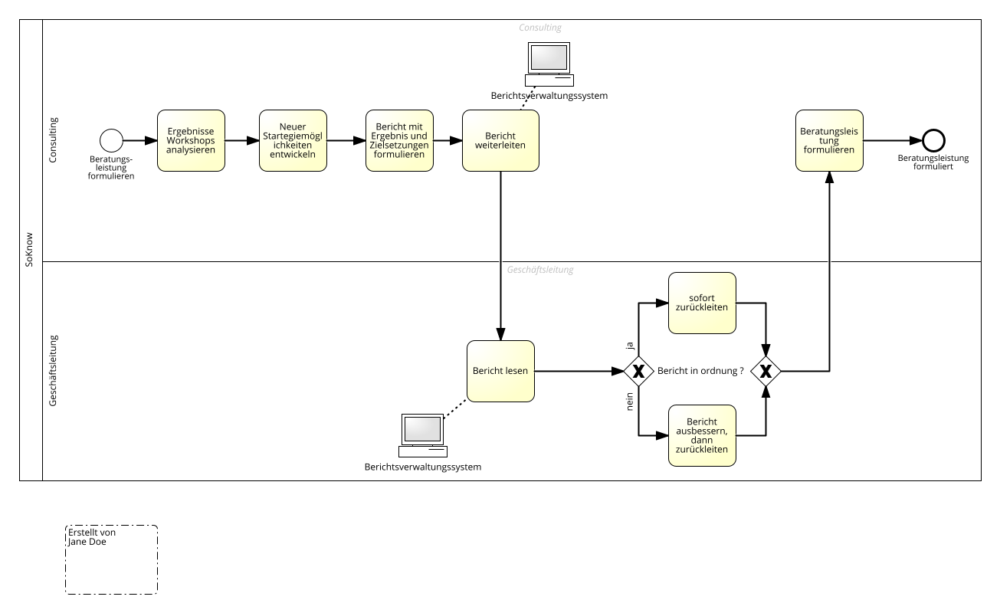

Name:  Mitarbeitergespräche
setup folder
MMV aaa


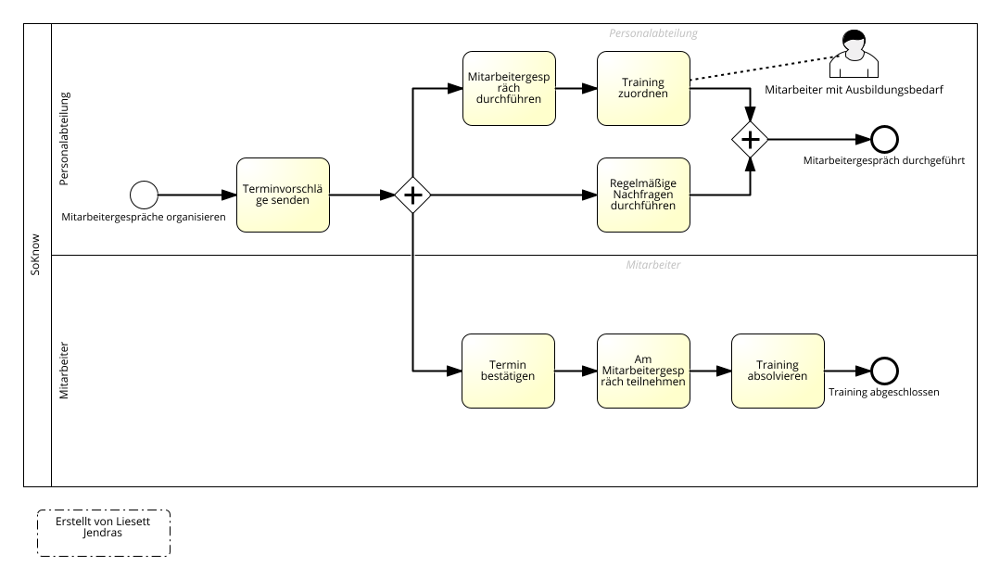

Name:  Einkauf
setup folder
MMV aaa


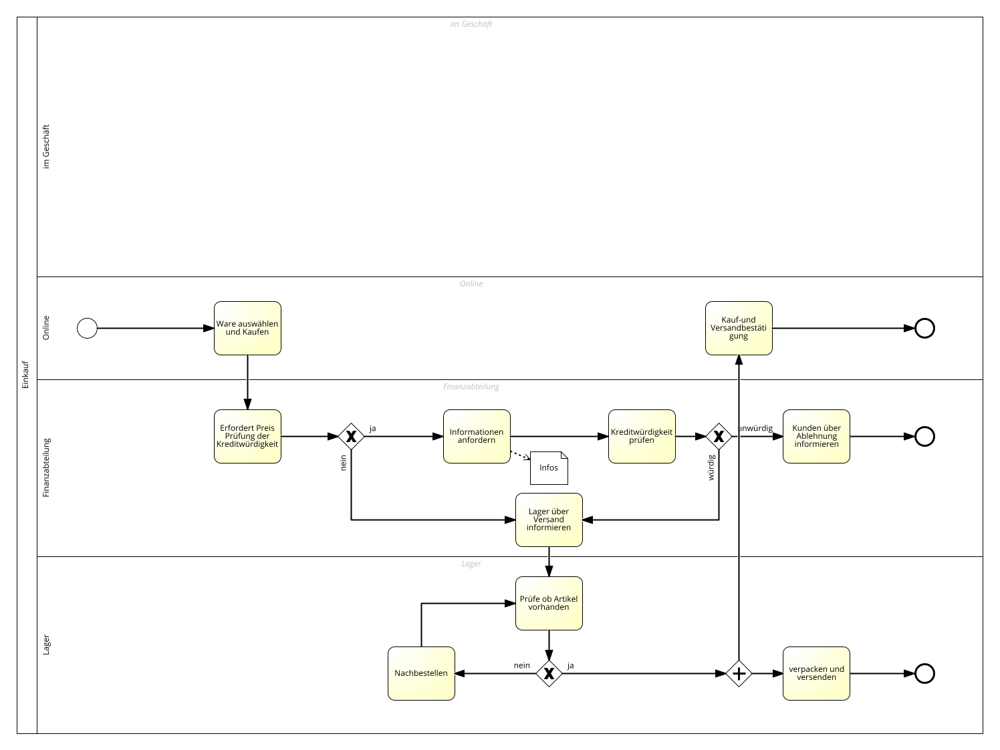

Name:  Personalentwicklung-Soll
setup folder
MMV aaa


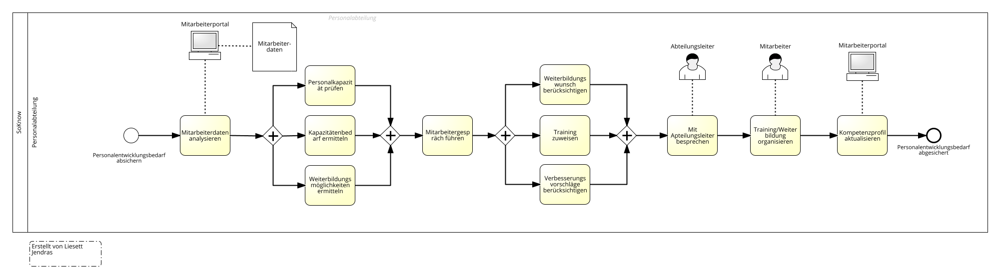

Name:  UP.07.03.02 Bewerbungsprozess
setup folder
MMV aaa


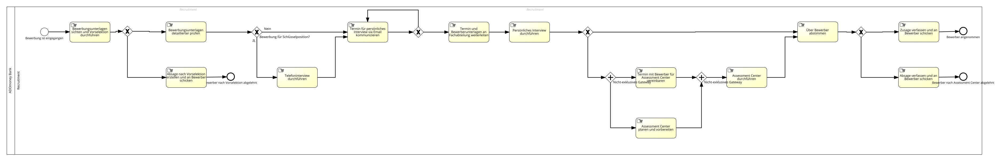

Name:  Aufgabe zuweisen
setup folder
MMV aaa


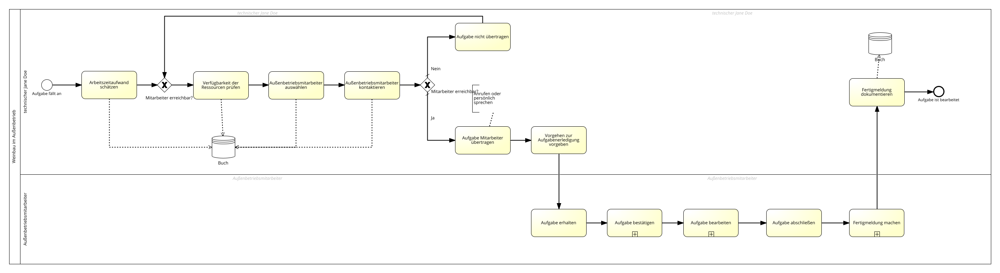

Name:  Herausfinden neuer Technologien (ist Prozess)
setup folder
MMV aaa


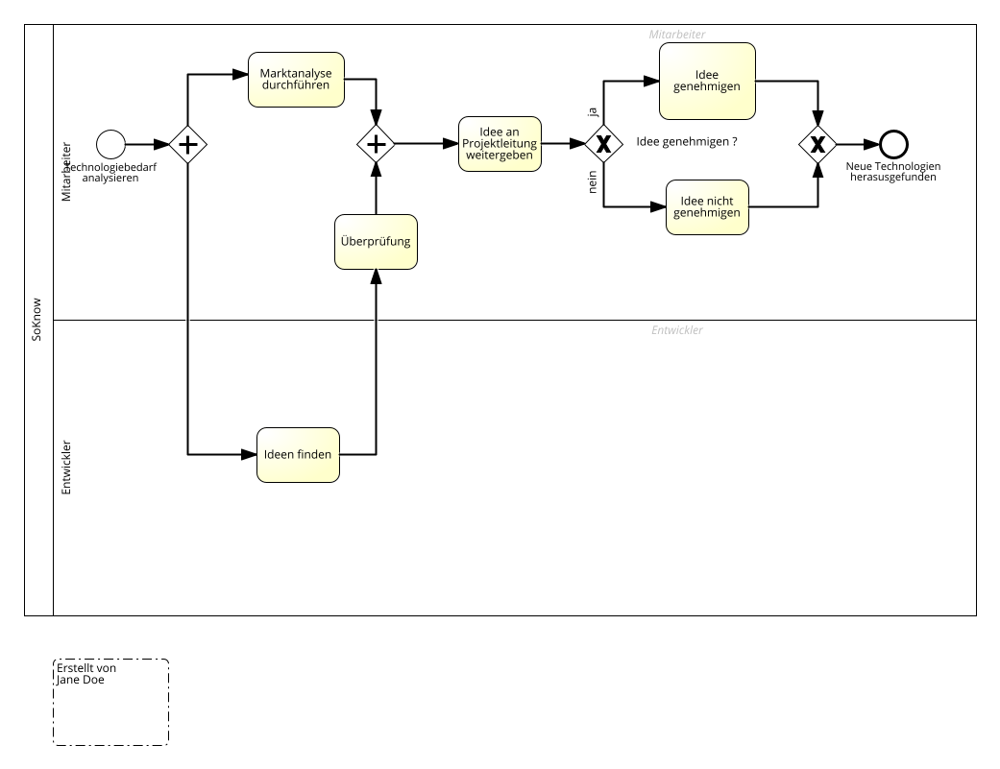

Name:  Auftrag
setup folder
MMV aaa


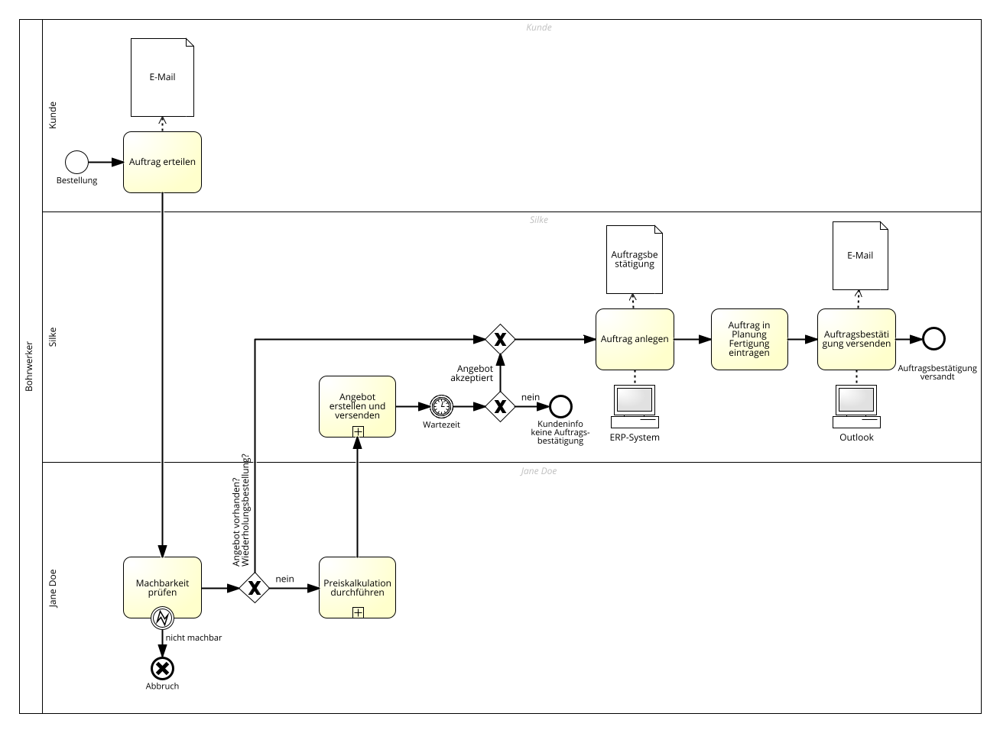

Name:  

setup folder
MMV aaa


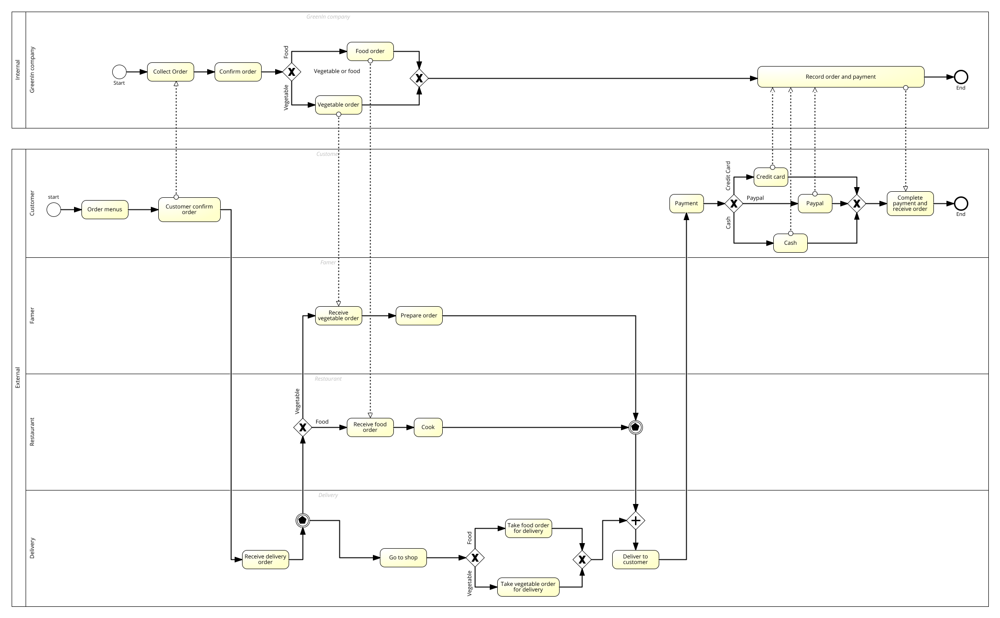

Name:  Editorial Examination
setup folder
MMV aaa


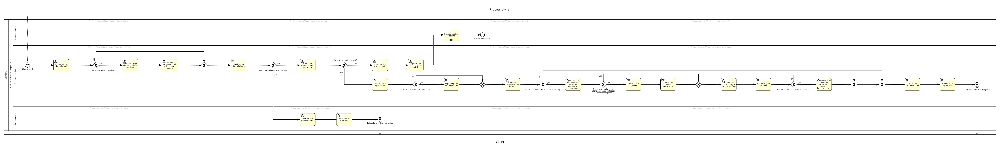

Name:  MEP2
setup folder
MMV aaa


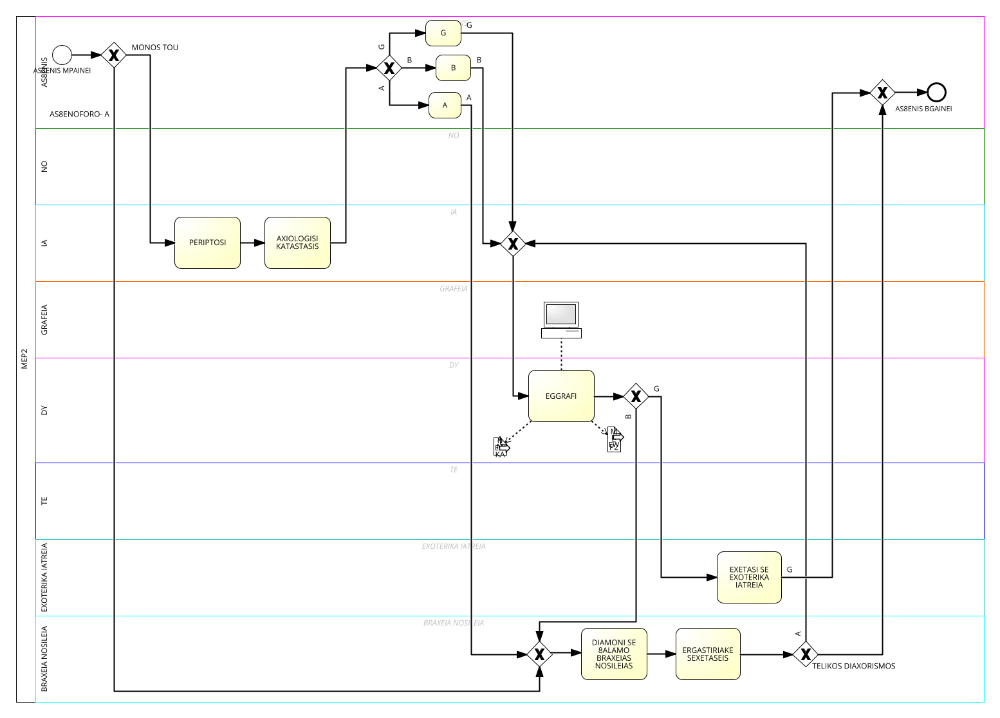

Name:  Zielsetzung
setup folder
MMV aaa


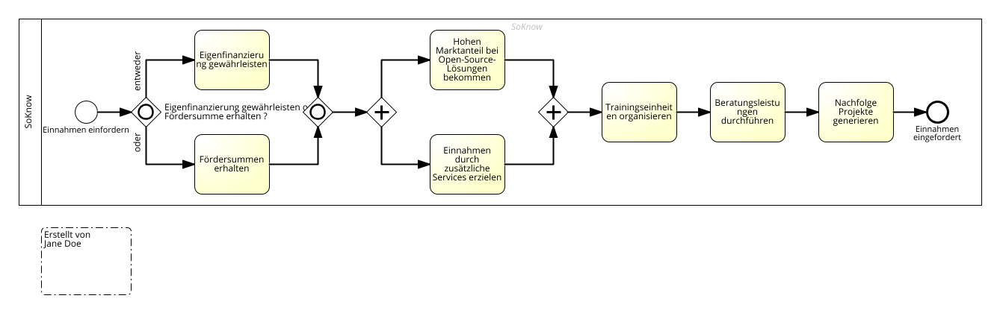

Name:  s B2B service nodes deployment (installation)
setup folder
MMV aaa


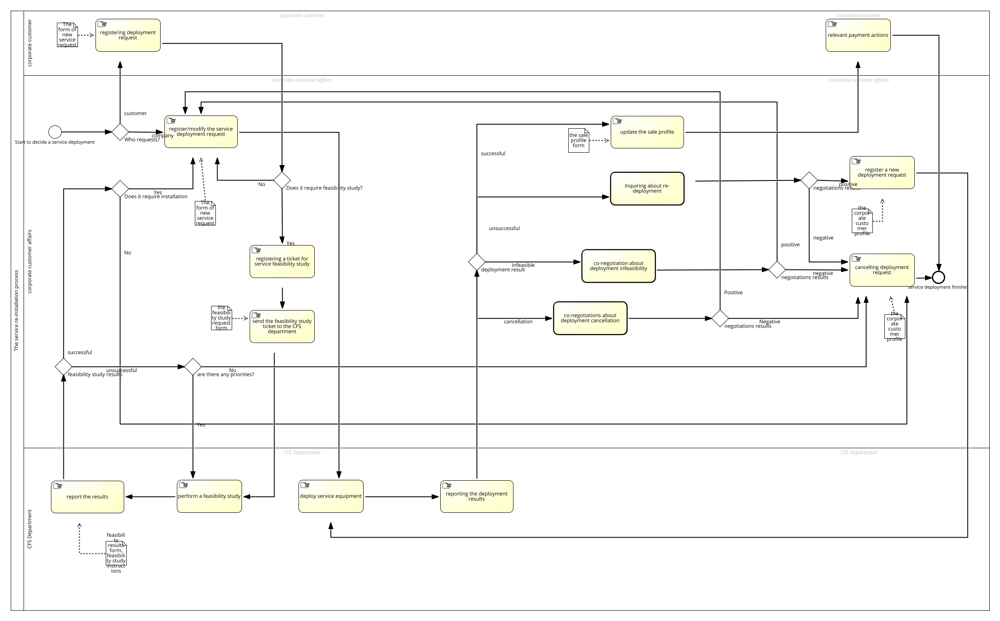

Name:  Lizenz kaufen (Soll)
setup folder
MMV aaa


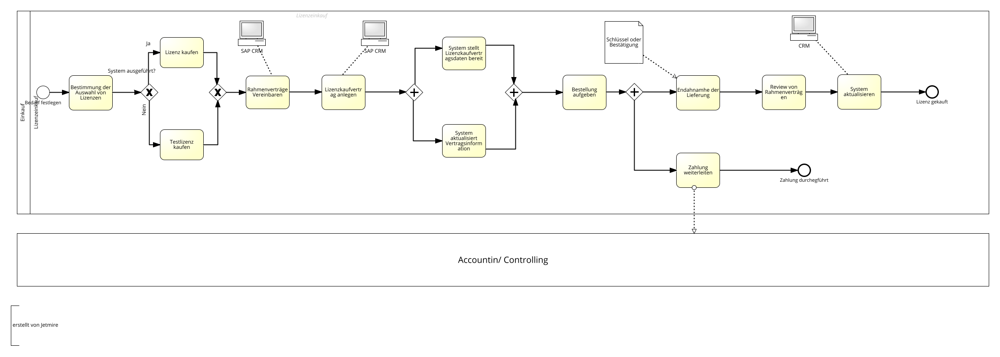

Name:  Anpassung von Wissensmanagementsystemen (Soll-Prozess)
setup folder
MMV aaa


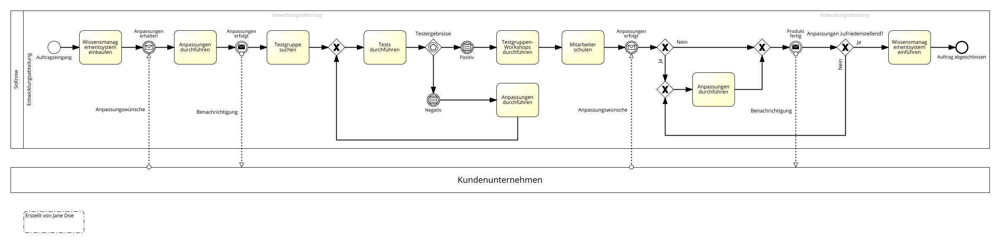

Name:  Customer
setup folder
MMV aaa


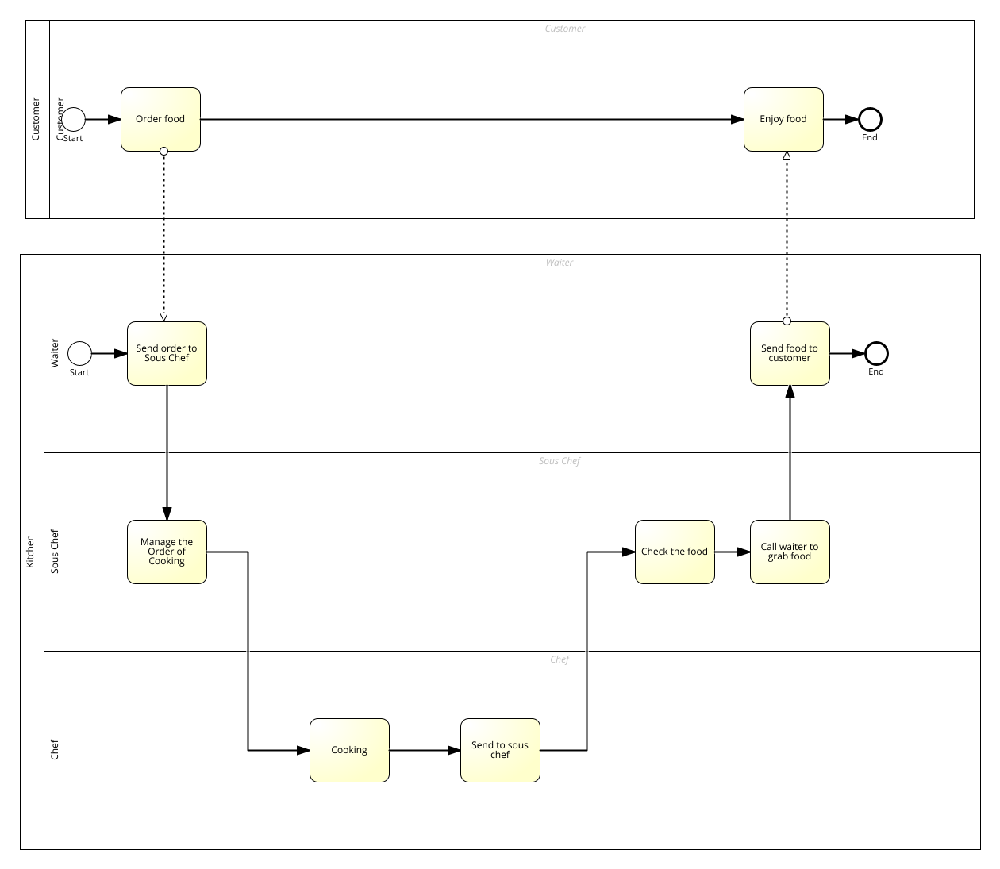

Name:  Planung von Marketing-Kampagnen (Soll-Prozess)
setup folder
MMV aaa


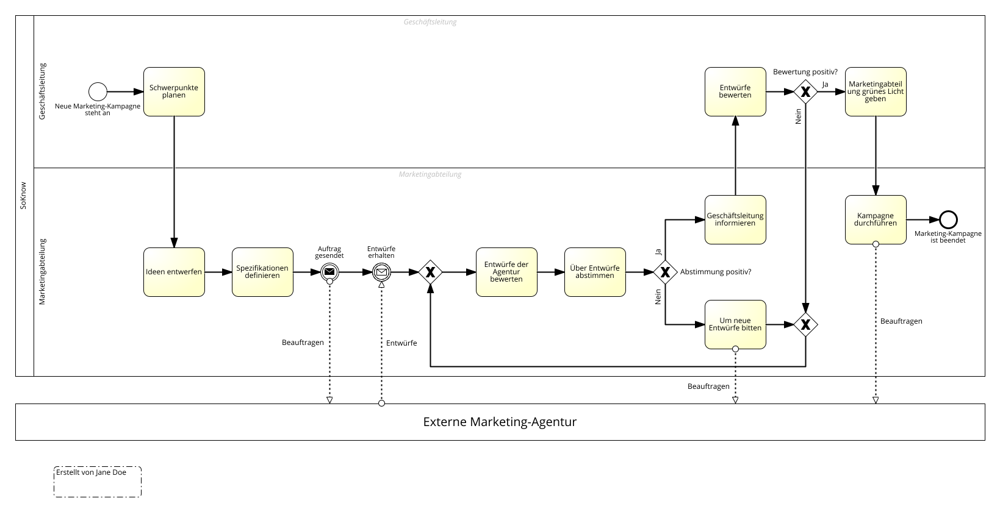

Name:  Ausschreibungsunterlagen
erstellen
setup folder
MMV aaa


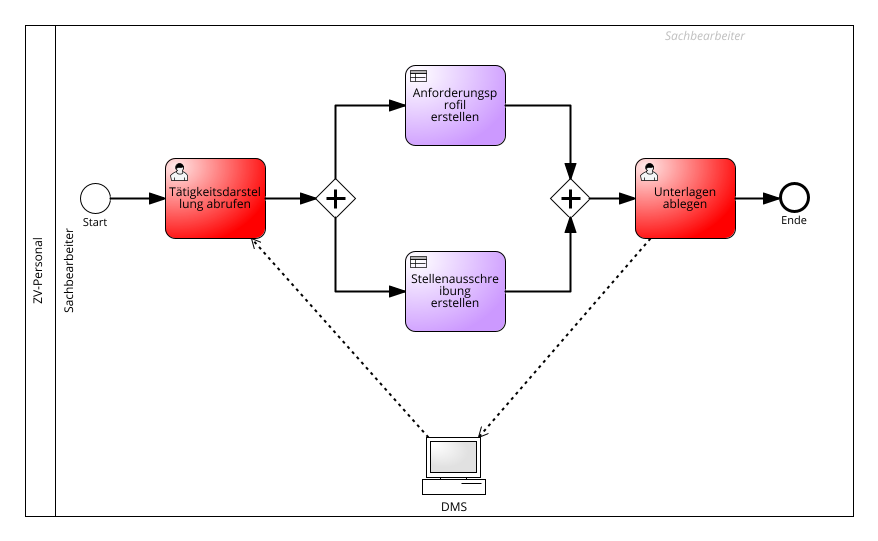

Name:  Mitzeichnungsvermerk
erstellen
setup folder
MMV aaa


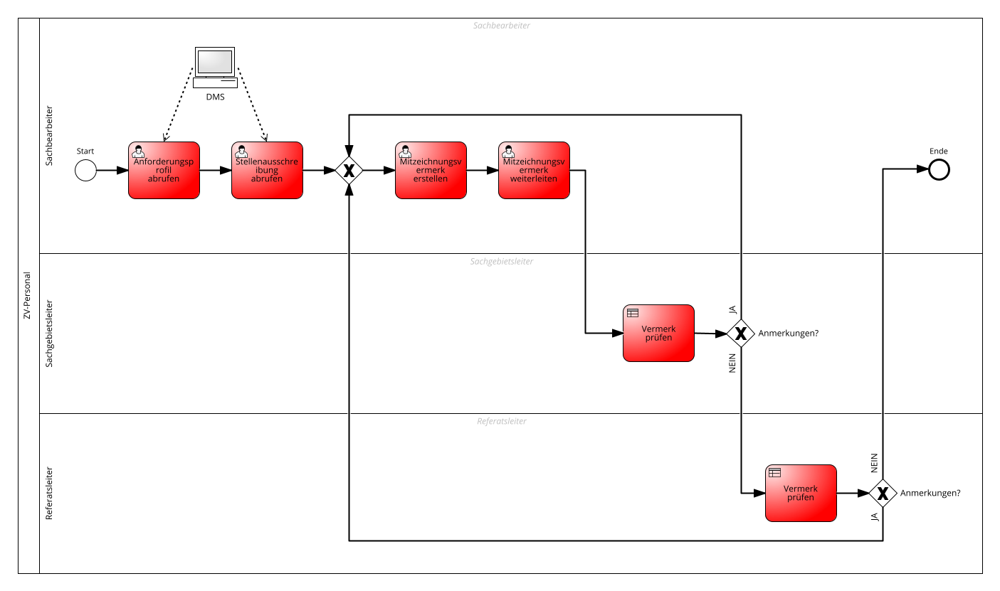

Name:  Detailkonstruktion Elektrik durchführen
setup folder
MMV aaa


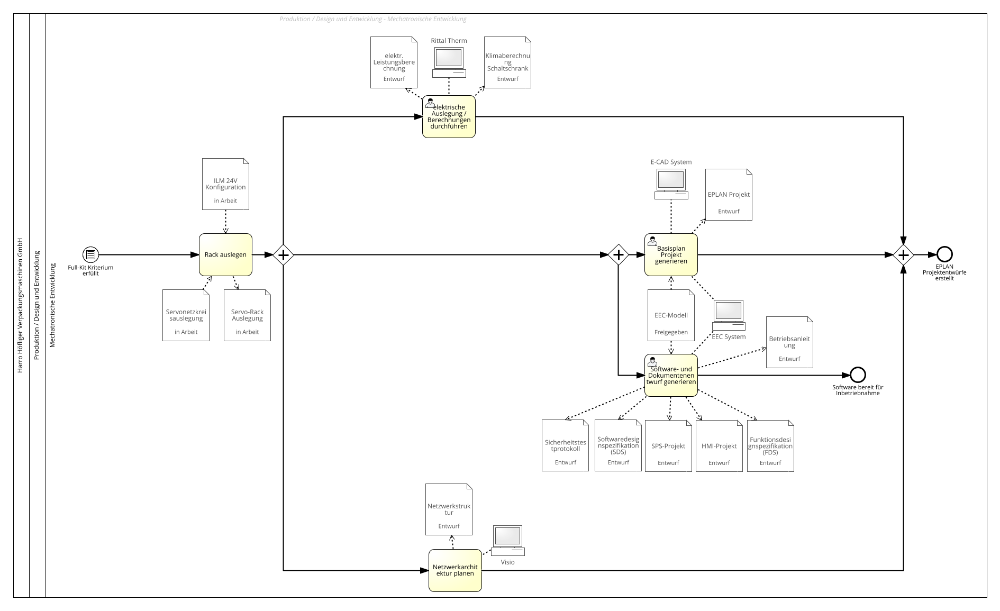

Name:  Make preparations for travel
setup folder
MMV aaa


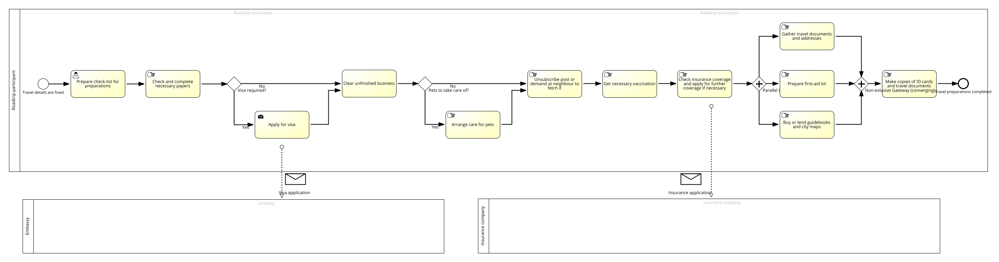

Name:  setup  WoW
subscription
setup folder
MMV aaa


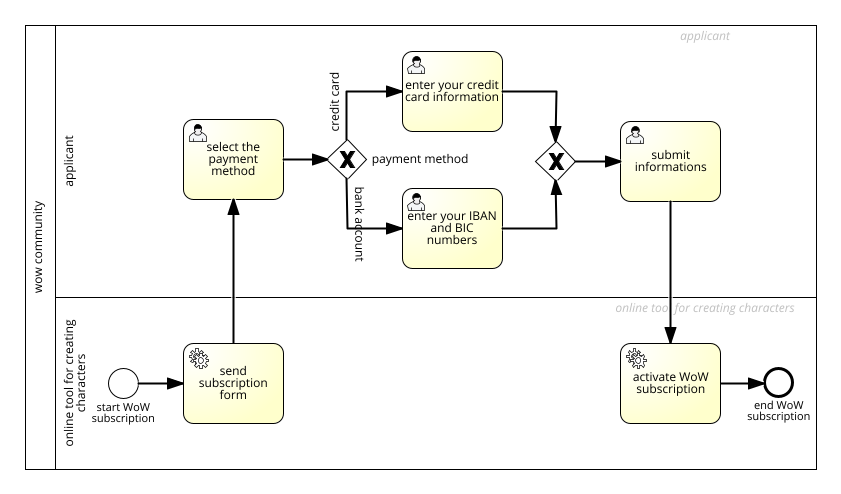

Name:  Fertigmeldung machen
setup folder
MMV aaa


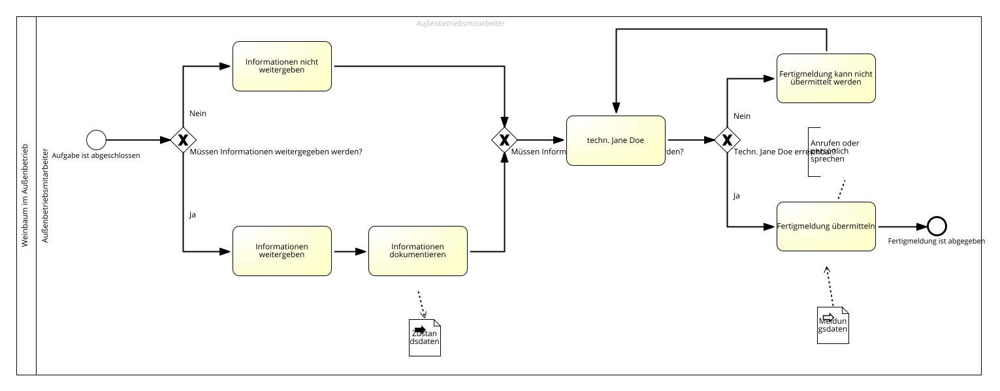

Name:  Anfrage im Angebot umwandeln
setup folder
MMV aaa


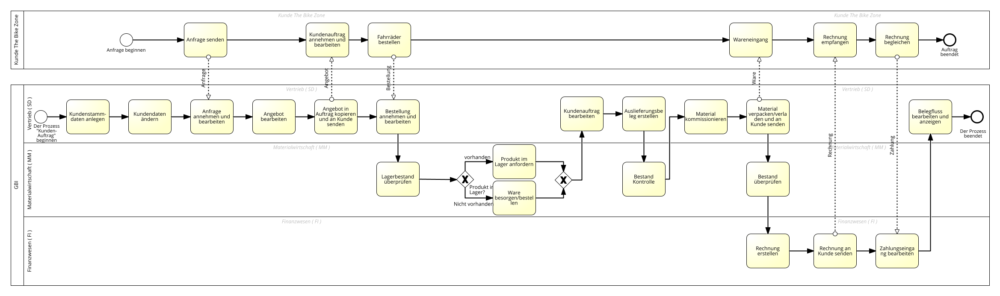

Name:  Bewerbungsverfahren
setup folder
MMV aaa


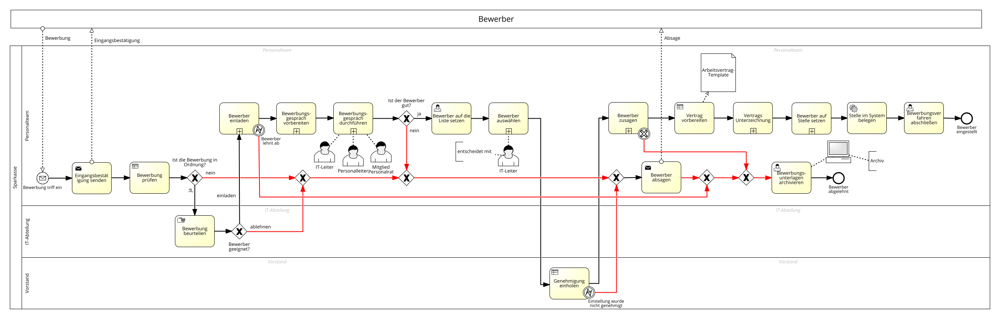

Name:  Planungssitzung (Soll-Prozess)
setup folder
MMV aaa


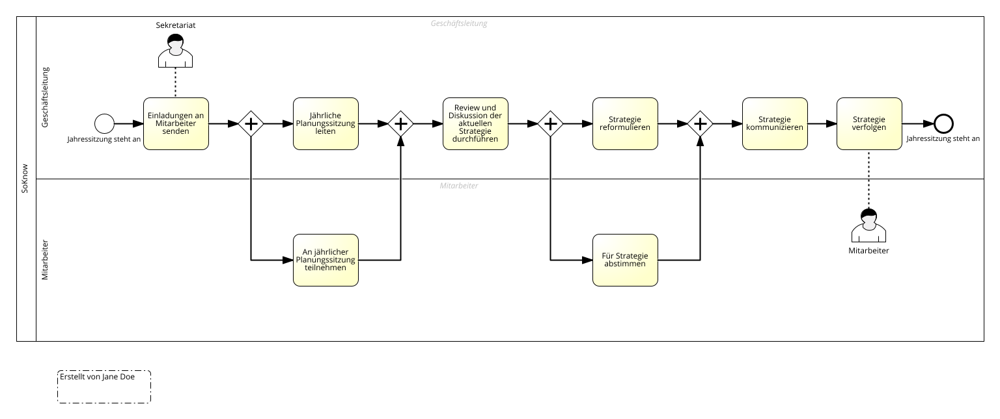

Name:  Kreditvermittlung
setup folder
MMV aaa


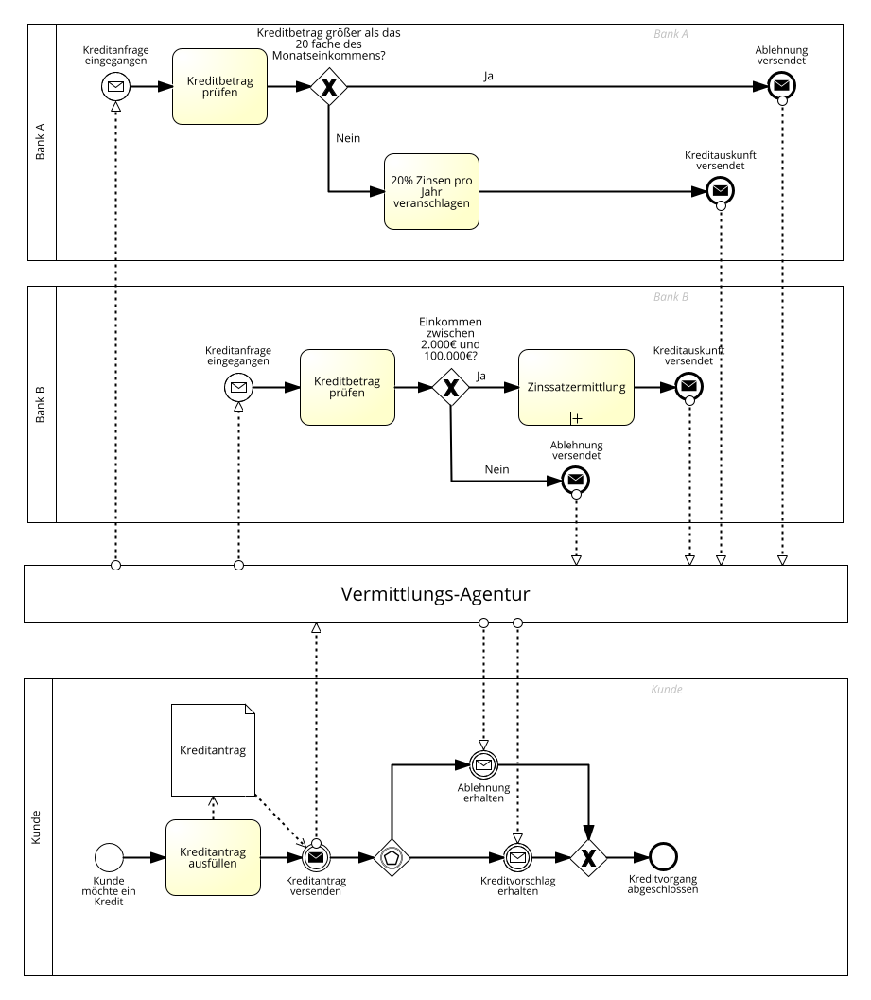

Name:  Änderungsprozesse einführen (soll-Prozesse)
setup folder
MMV aaa


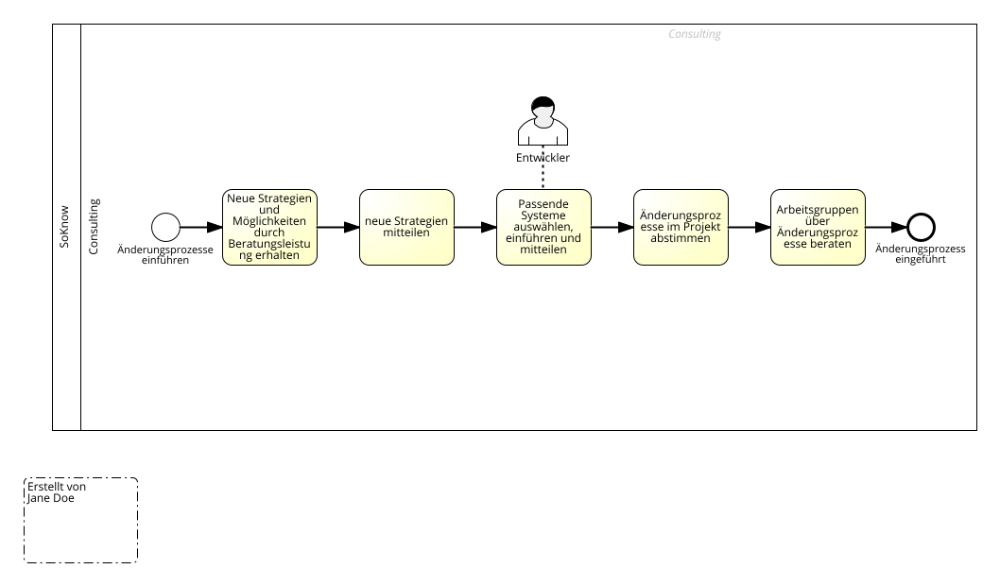

Name:  x B2B sale (2nd Phase)
setup folder
MMV aaa


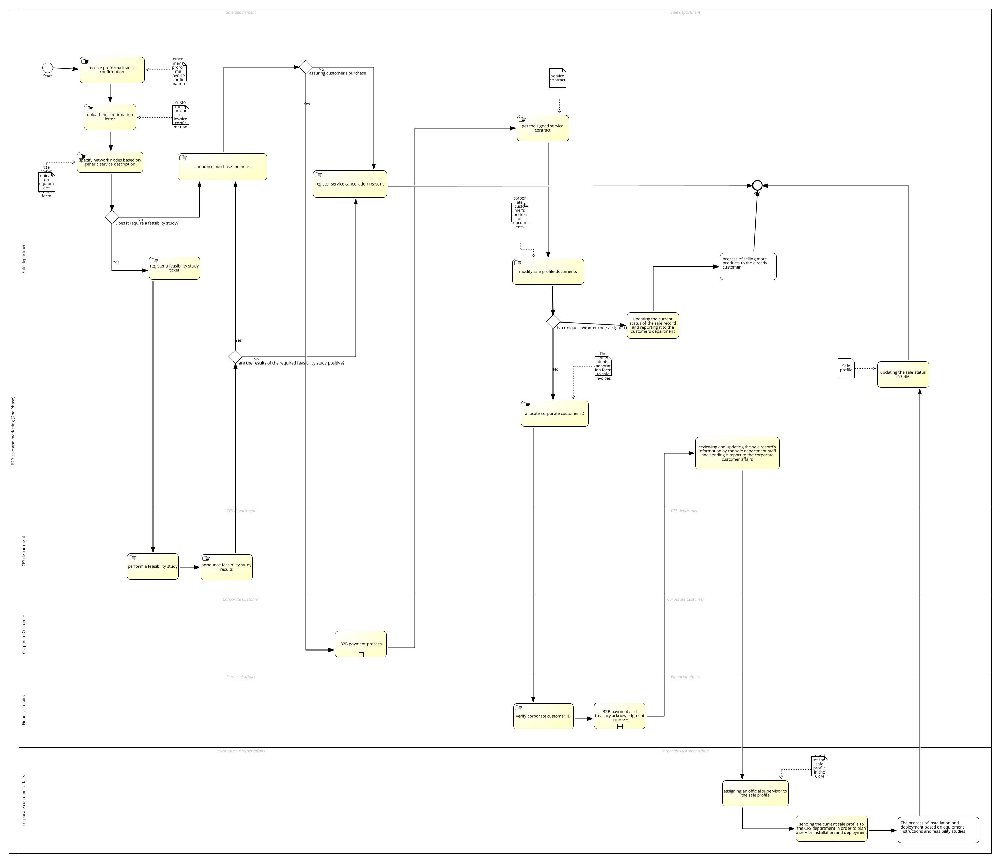

Name:  IMIS Application
setup folder
MMV aaa


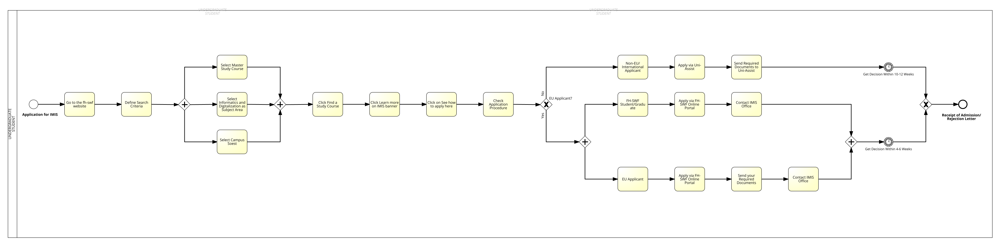

Name:  t B2B sale (2nd Phase)
setup folder
MMV aaa


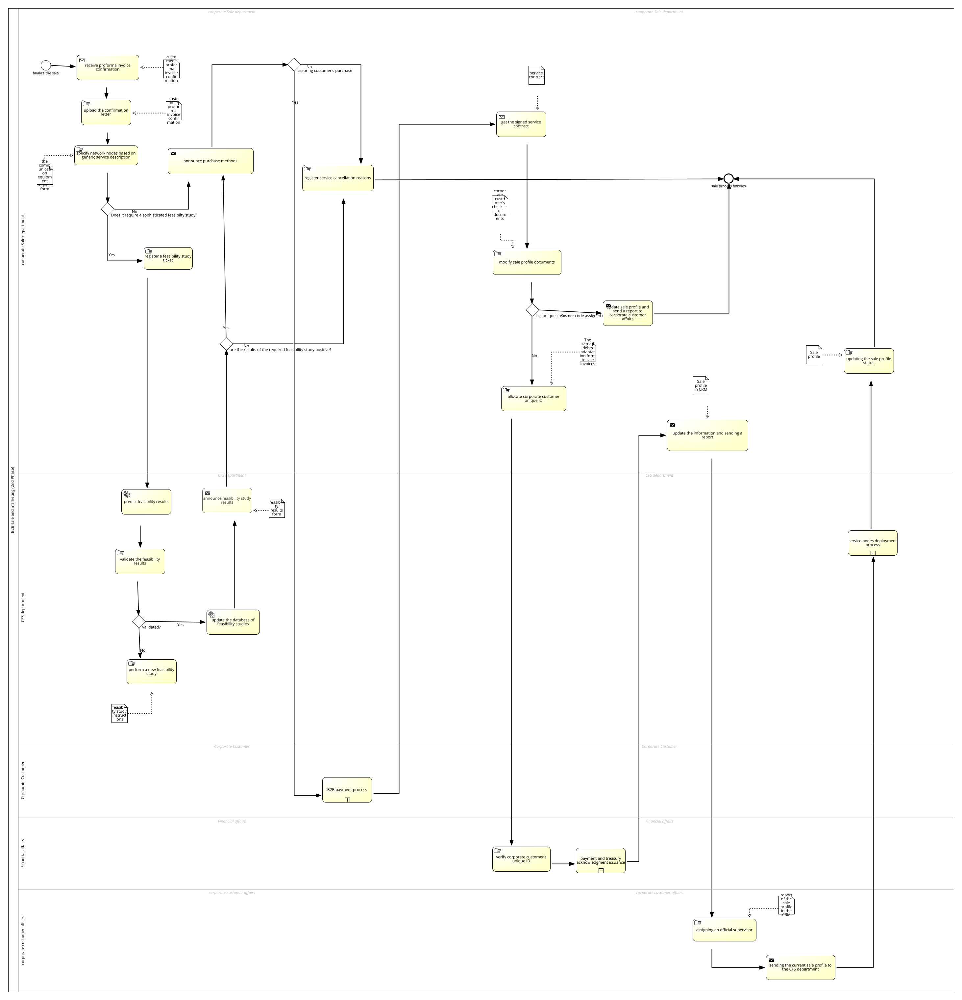

Name:  Check the data received by message
setup folder
MMV aaa


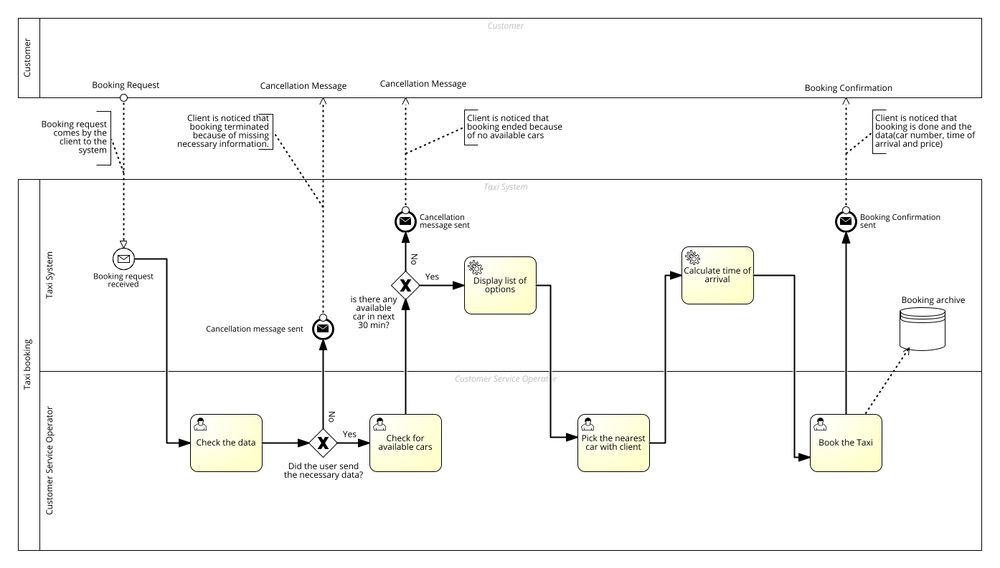

Name:  Loan provider
setup folder
MMV aaa


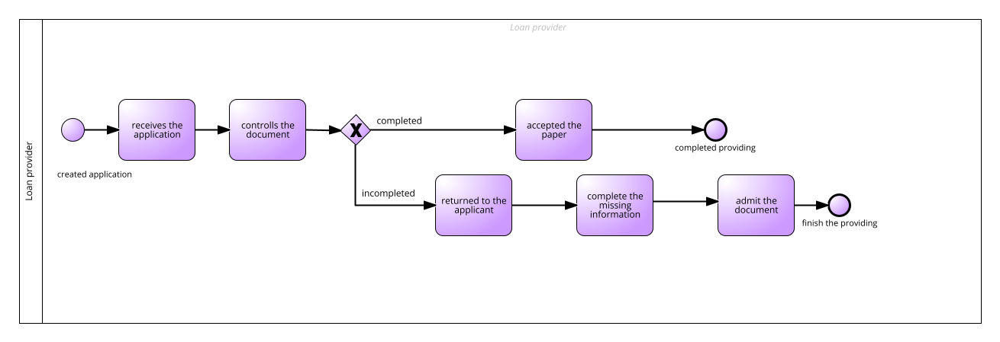

Name:  Entwicklung des Corporate Designs (Soll-Prozess)
setup folder
MMV aaa


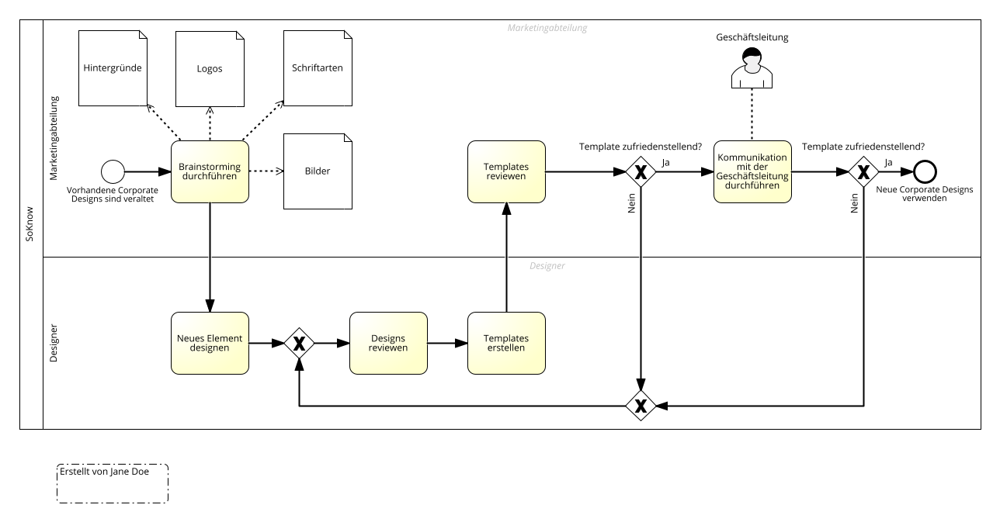

Name:  Kunde
setup folder
MMV aaa


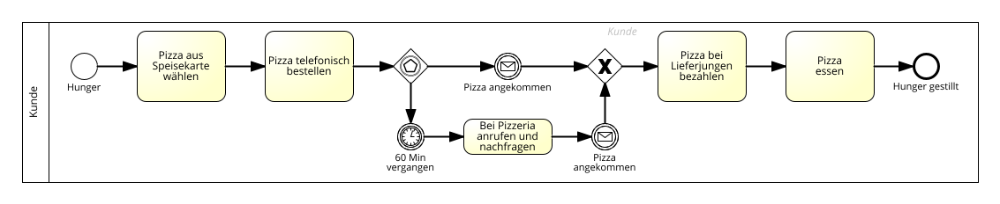

Name:  Share a staff member with another department
setup folder
MMV aaa


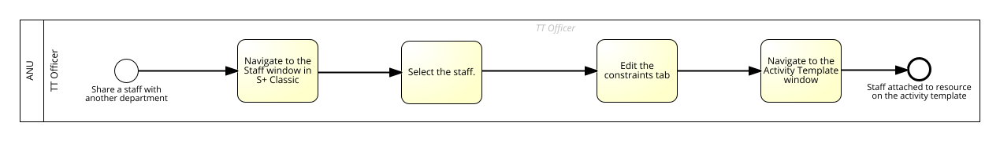

Name:  New Product Selection Process for a FMCG Retailer
setup folder
MMV aaa


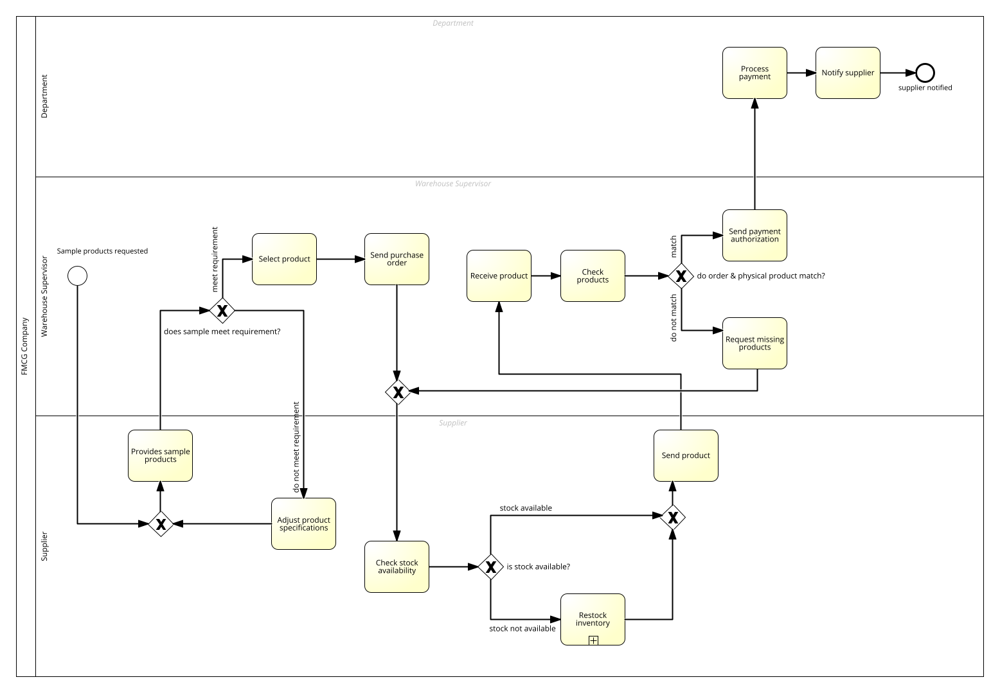

Name:  Add Patients details 

setup folder
MMV aaa


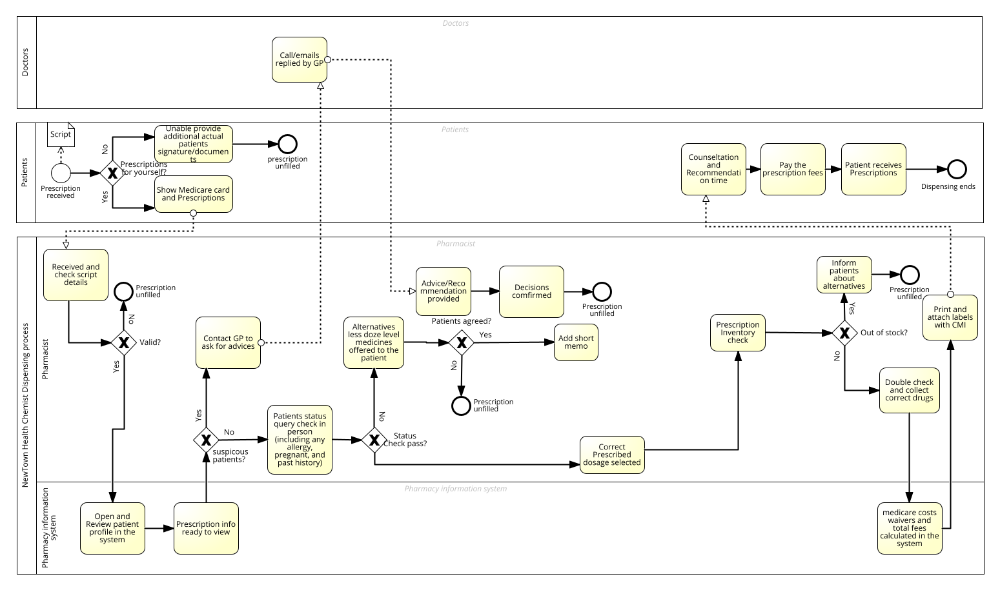

Name:  Finanzen
setup folder
MMV aaa


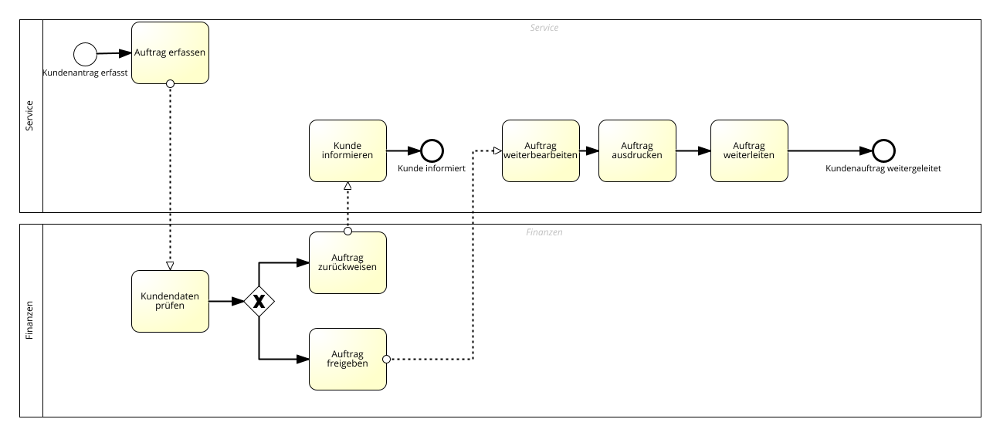

Name:  Zahlung kontrollieren
setup folder
MMV aaa


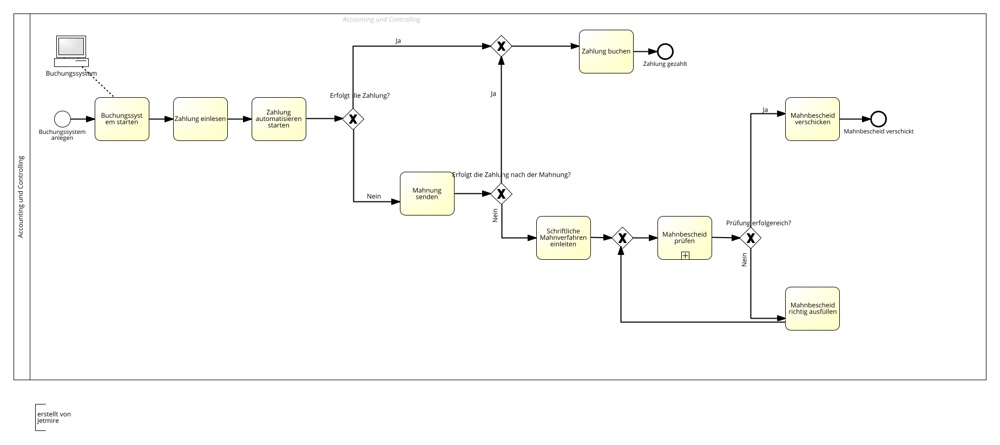

Name:  Verify dates

setup folder
MMV aaa


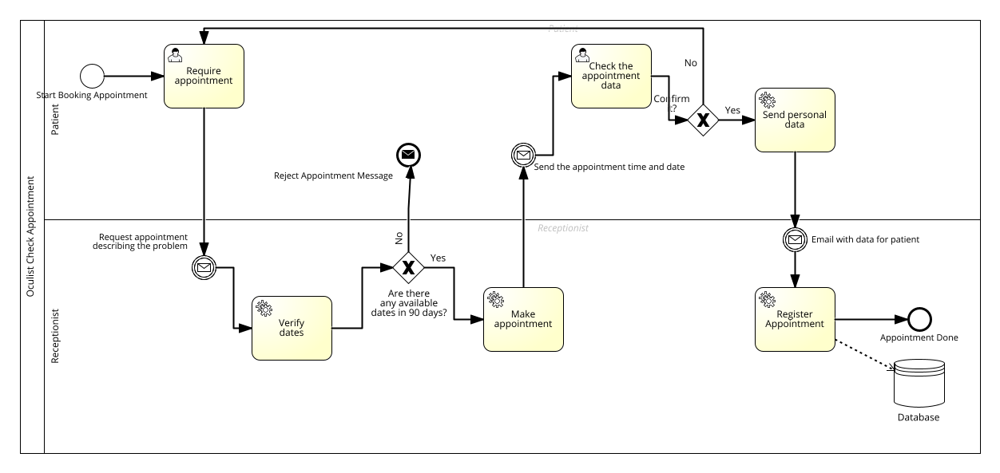

Name:  Process model prolongation
setup folder
MMV aaa


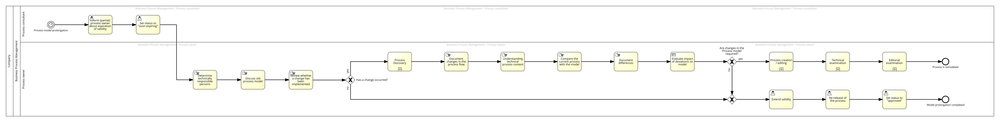

Name:  anmelden
setup folder
MMV aaa


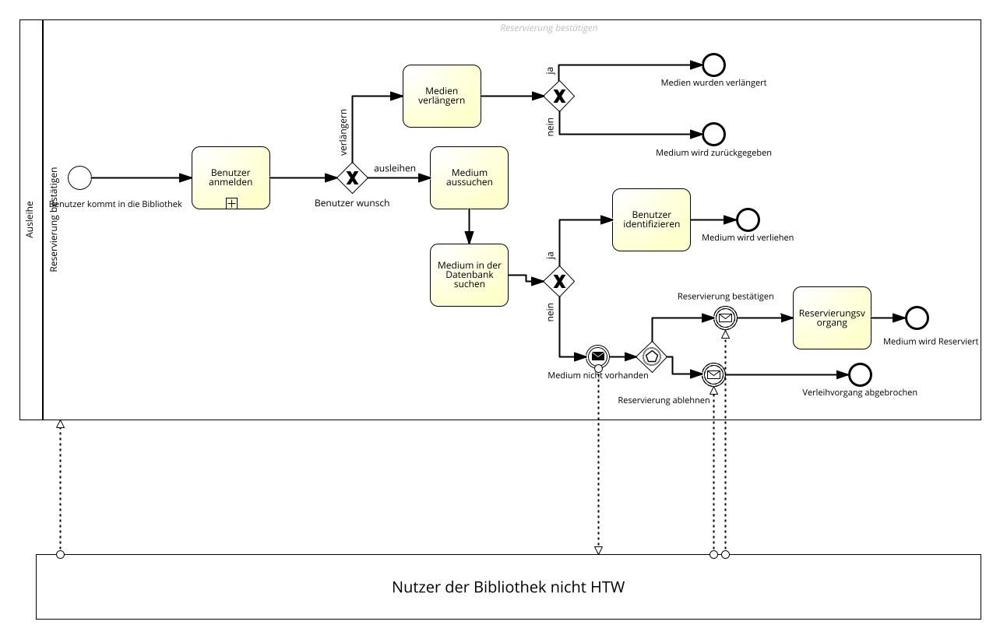

Name:  zum PC gehen
setup folder
MMV aaa


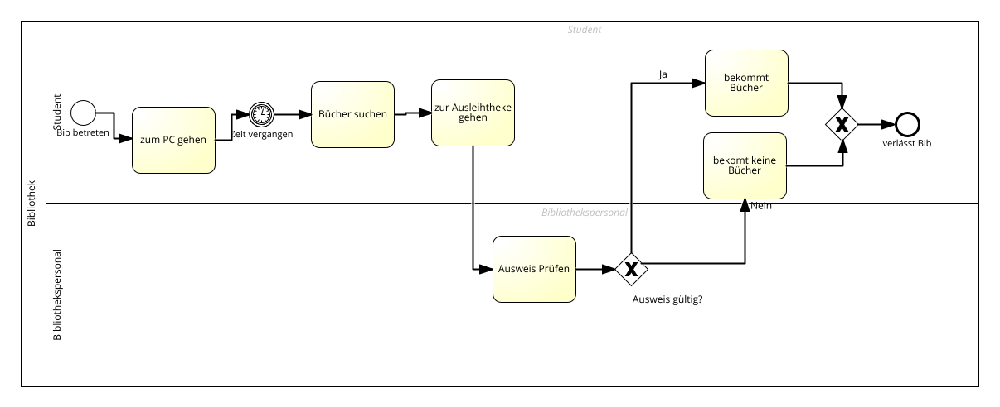

Name:  Traubenlese von Hand
setup folder
MMV aaa


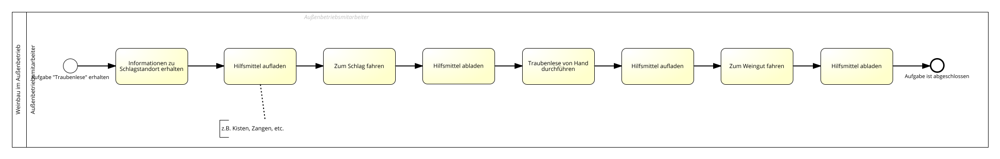

Name:  purchase order
setup folder
MMV aaa


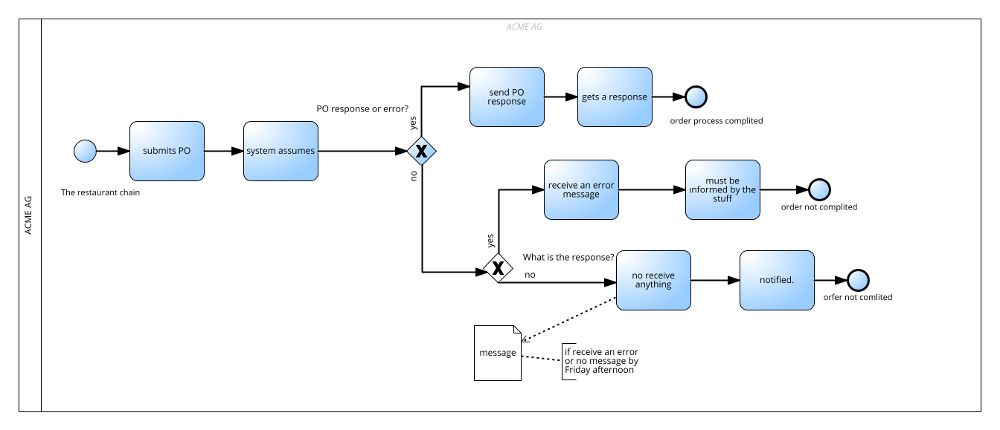

Name:  Process creation / discovery
setup folder
MMV aaa


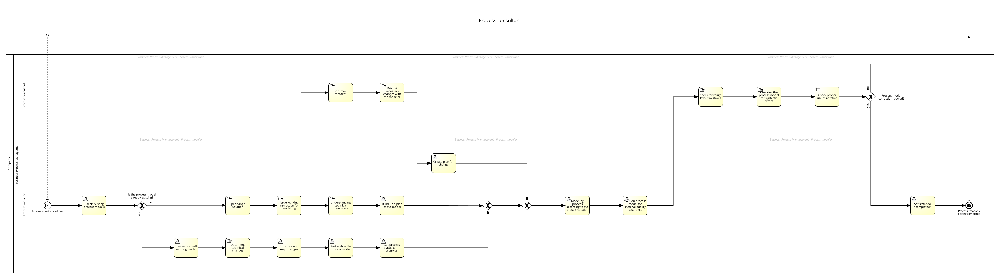

Name:  Datenblatt 
einblenden
setup folder
MMV aaa


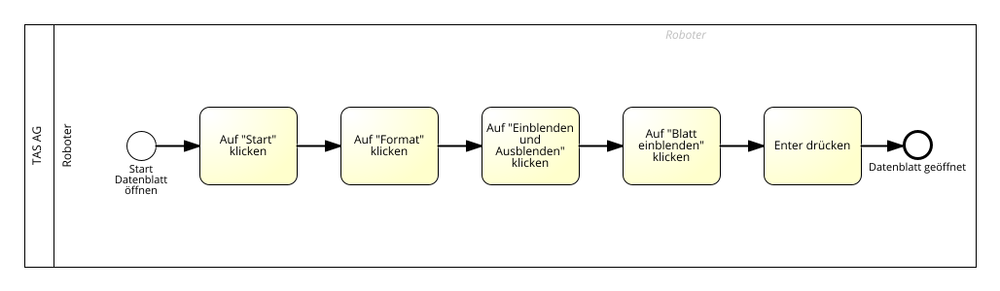

Name:  Andere Einkäufe (Soll)
setup folder
MMV aaa


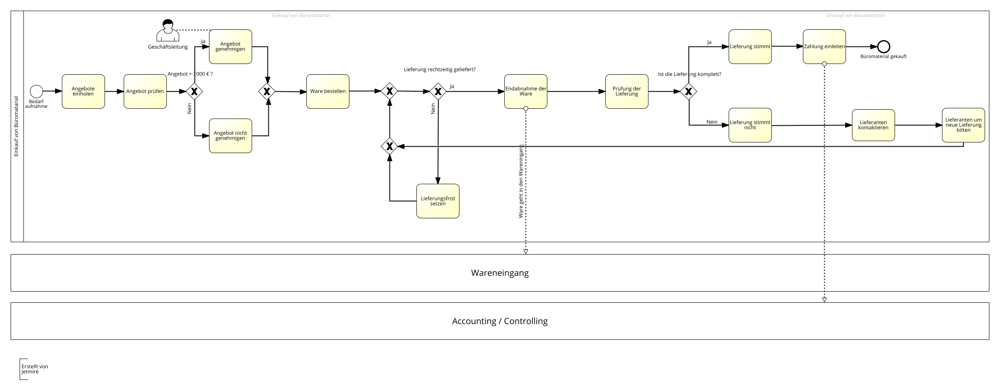

Name:  Pizza bezahlen
setup folder
MMV aaa


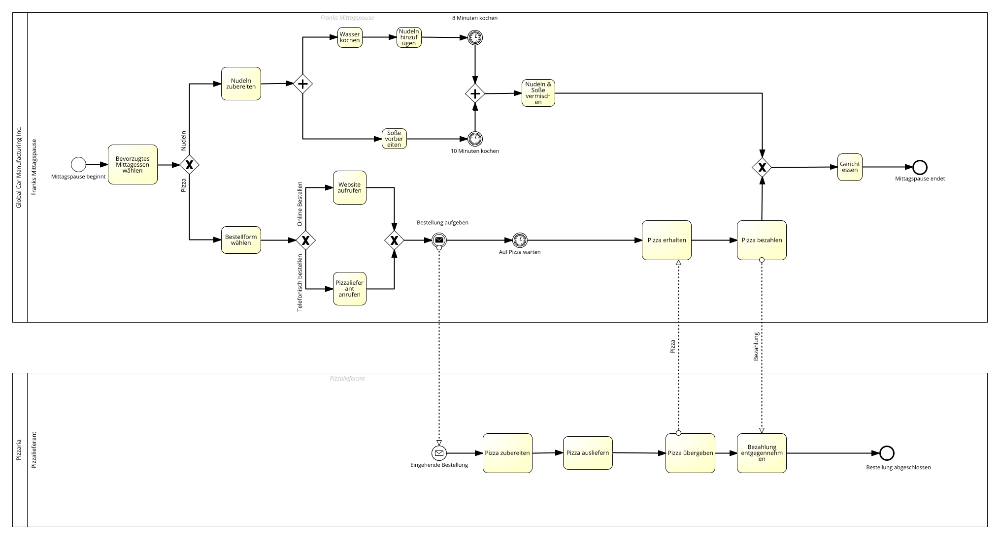

Name:  Full-Kit Kriterien prüfen 
setup folder
MMV aaa


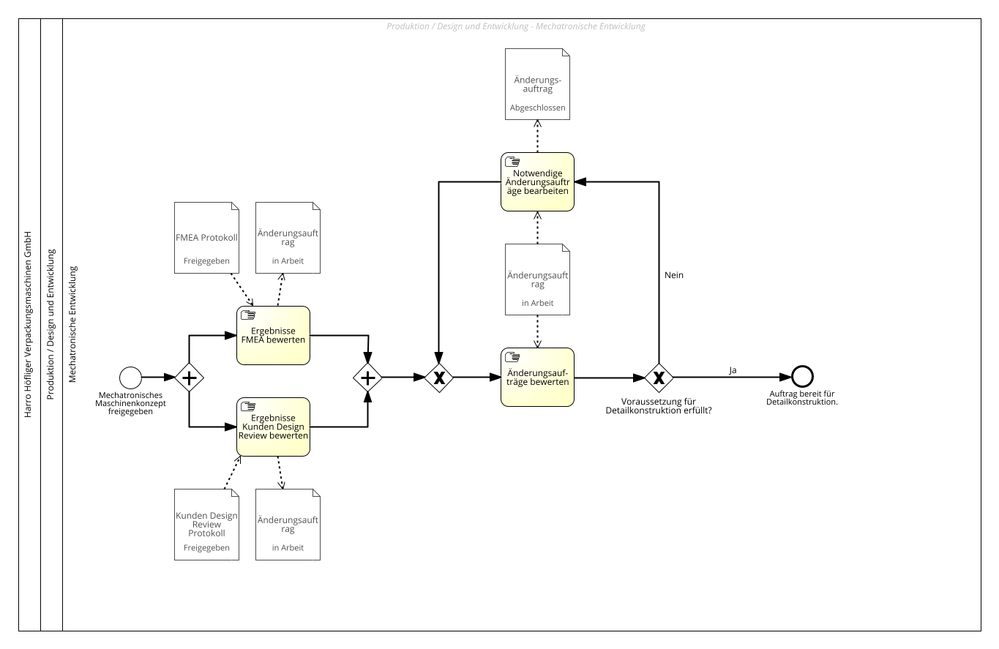

Name:  Fahrrad Herstellung
setup folder
MMV aaa


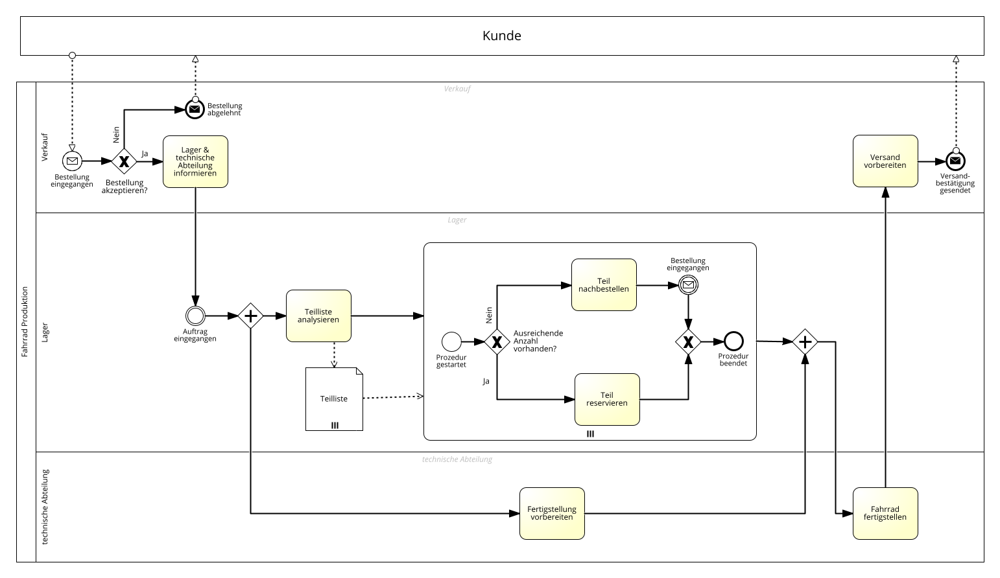

Name:  Schadensregulierung
setup folder
MMV aaa


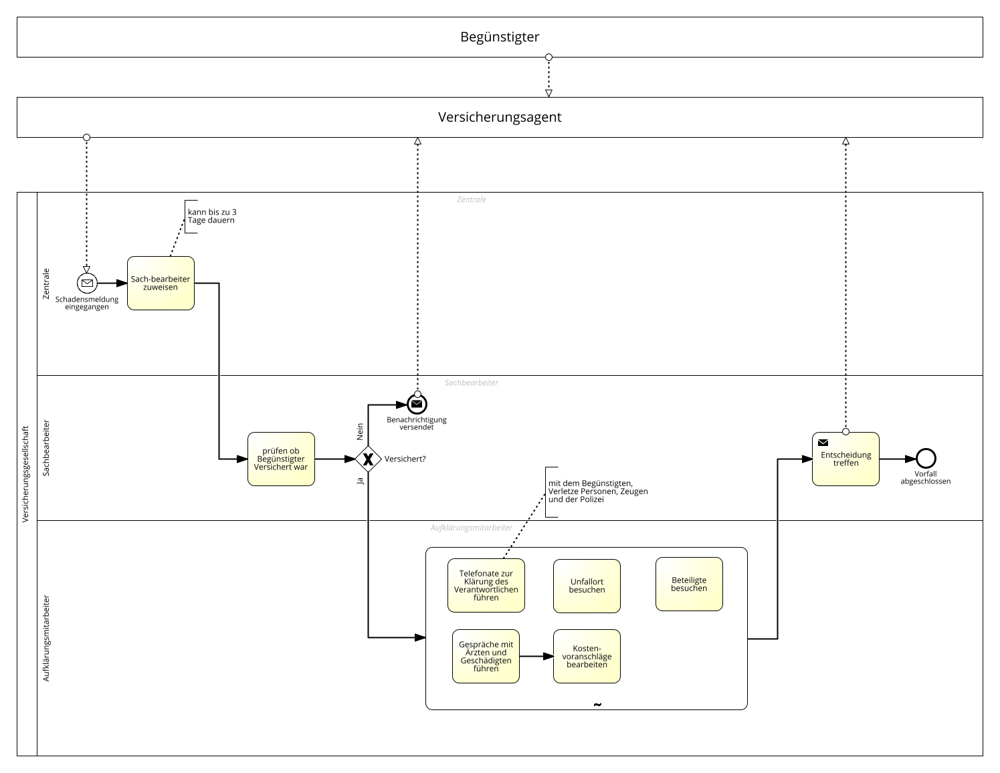

Name:  Personalverwaltung
setup folder
MMV aaa


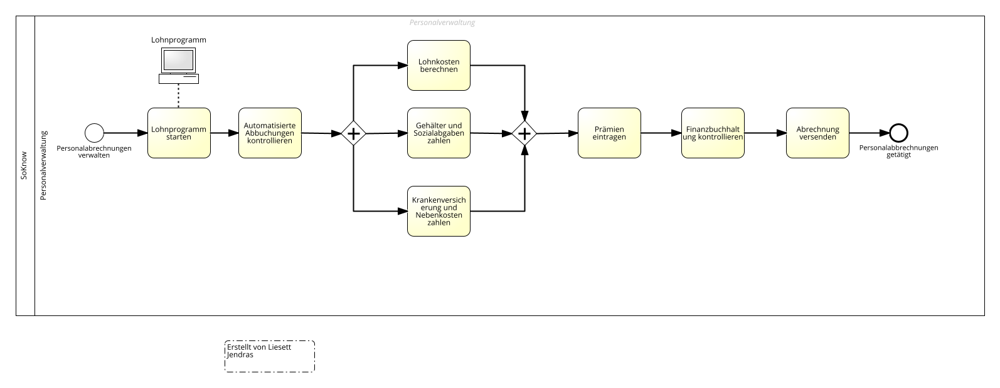

Name:  Sales pipeline process
setup folder
MMV aaa


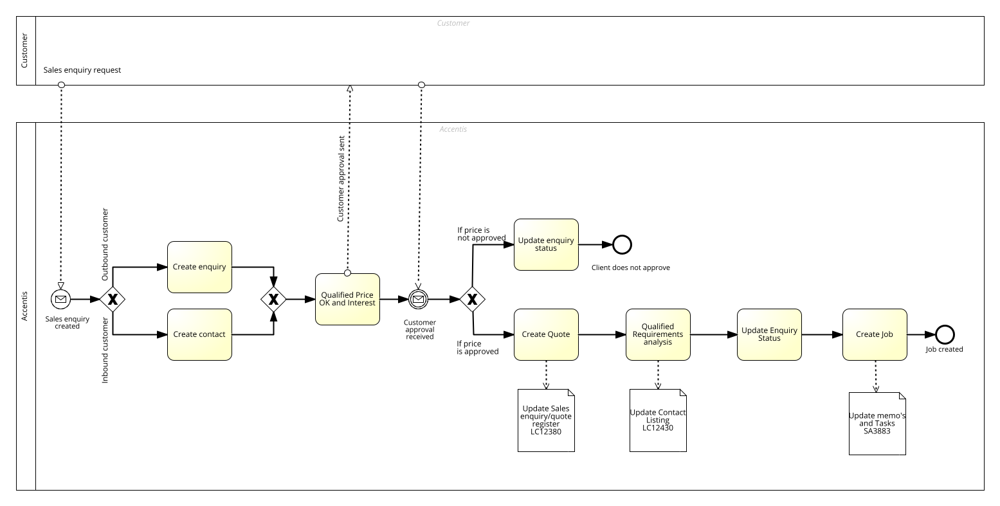

Name:  PC Montage
setup folder
MMV aaa


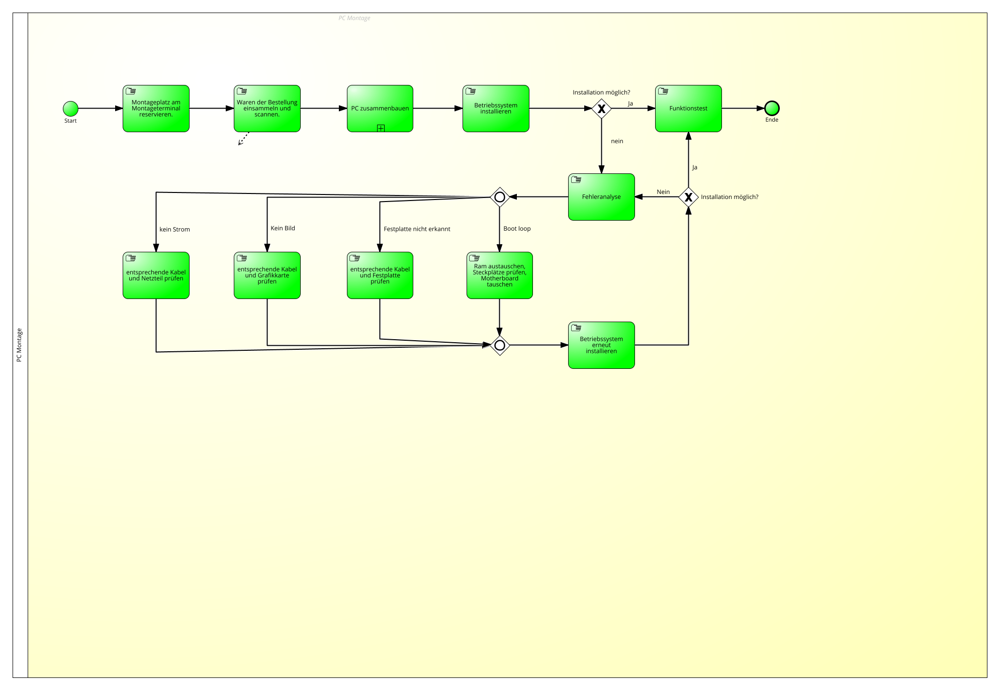

Name:  Purchase Requisition-to-Purchase Order
setup folder
MMV aaa


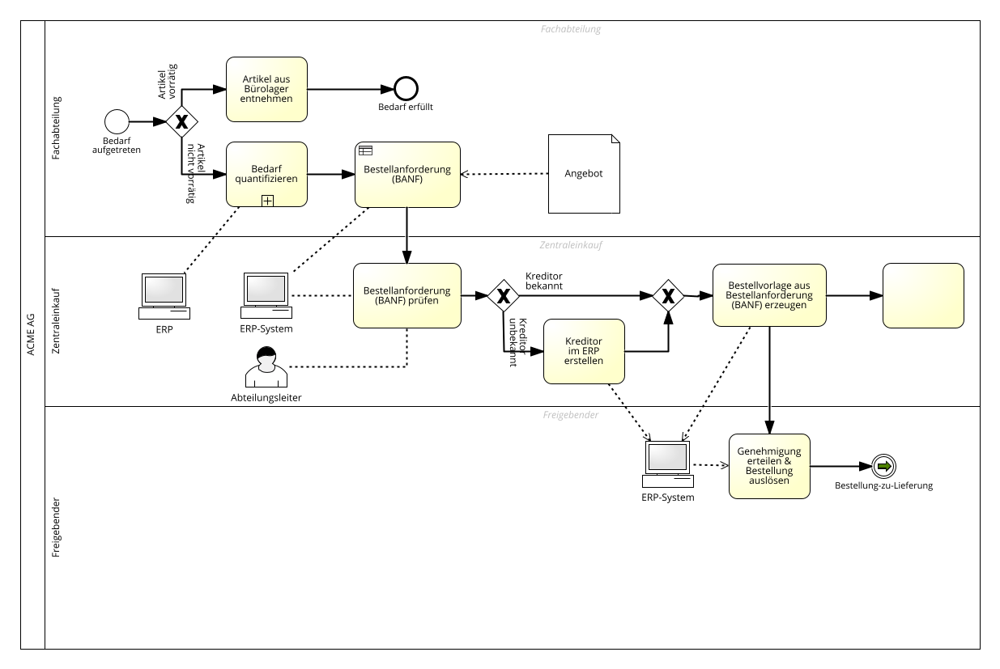

Name:  Einkauf Infrastruktur/ Facility-Mangement
setup folder
MMV aaa


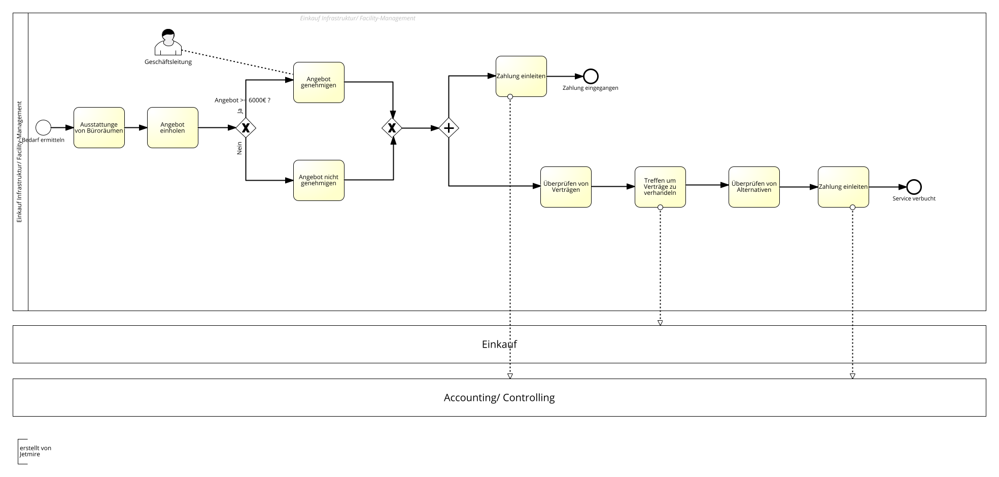

Name:  Upload der Importexcel in das TTCall System
setup folder
MMV aaa


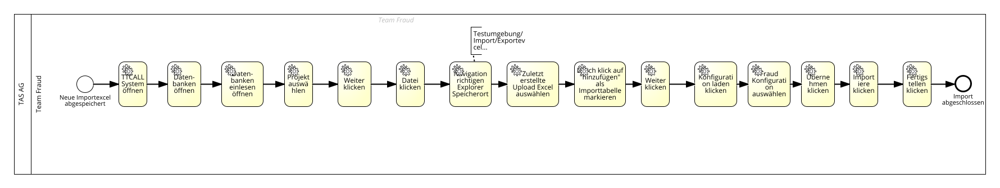

Name:  Schoko & Kuchen
setup folder
MMV aaa


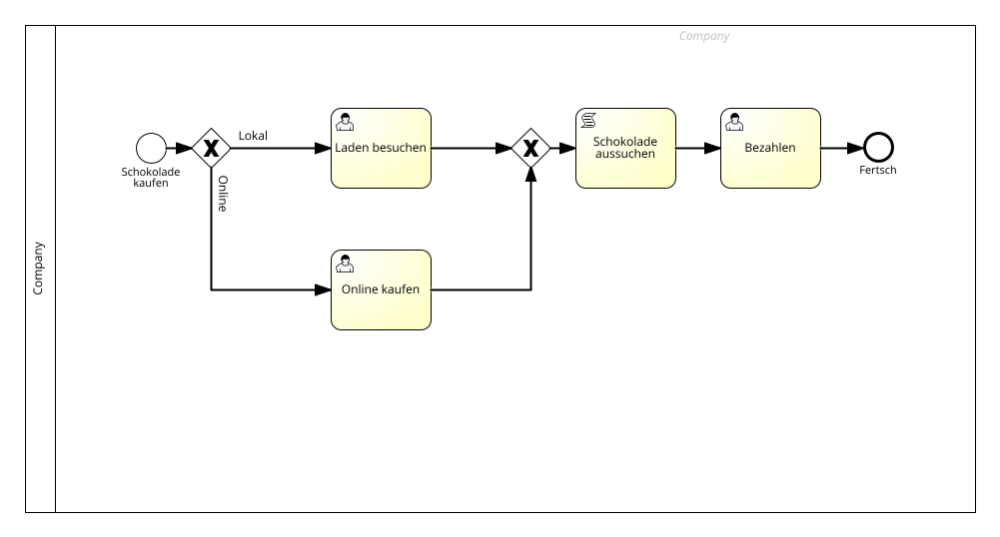

Name:  setup battle.net account
setup folder
MMV aaa


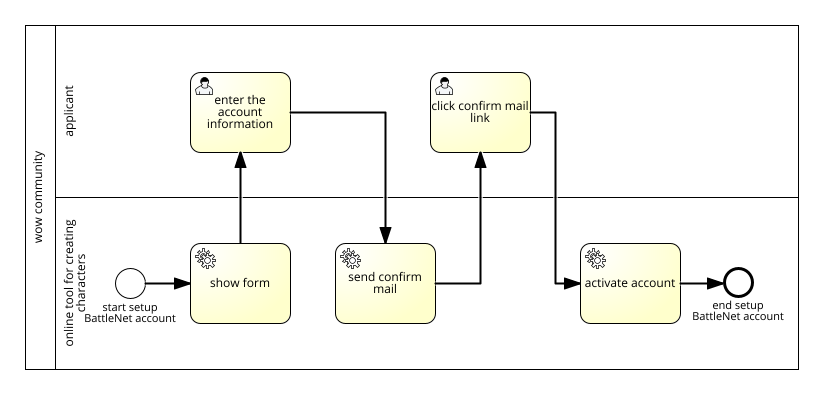

Name:  Vertiebs-Innendienst

setup folder
MMV aaa


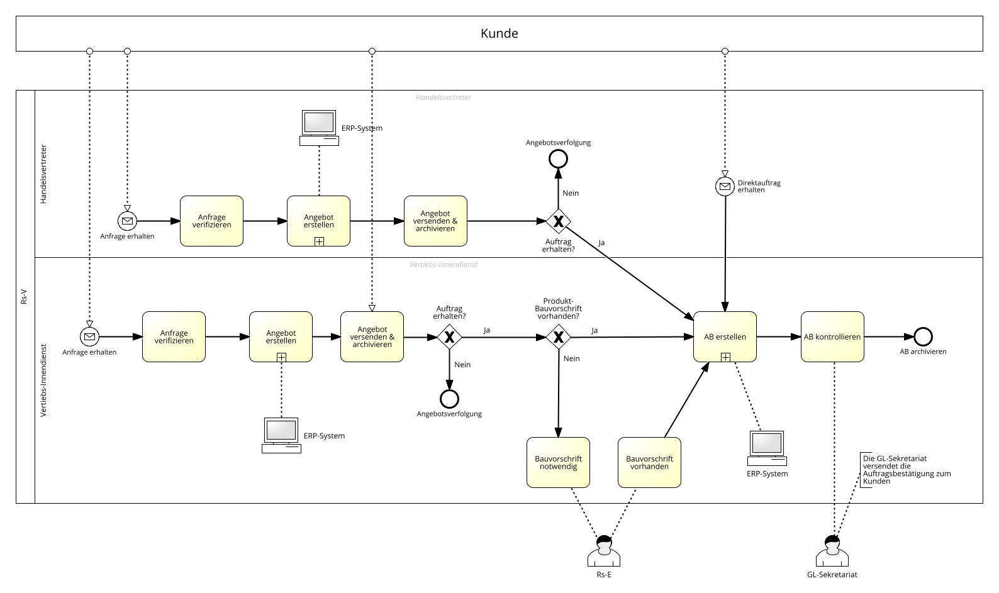

Name:  Kredit-Prozess
setup folder
MMV aaa


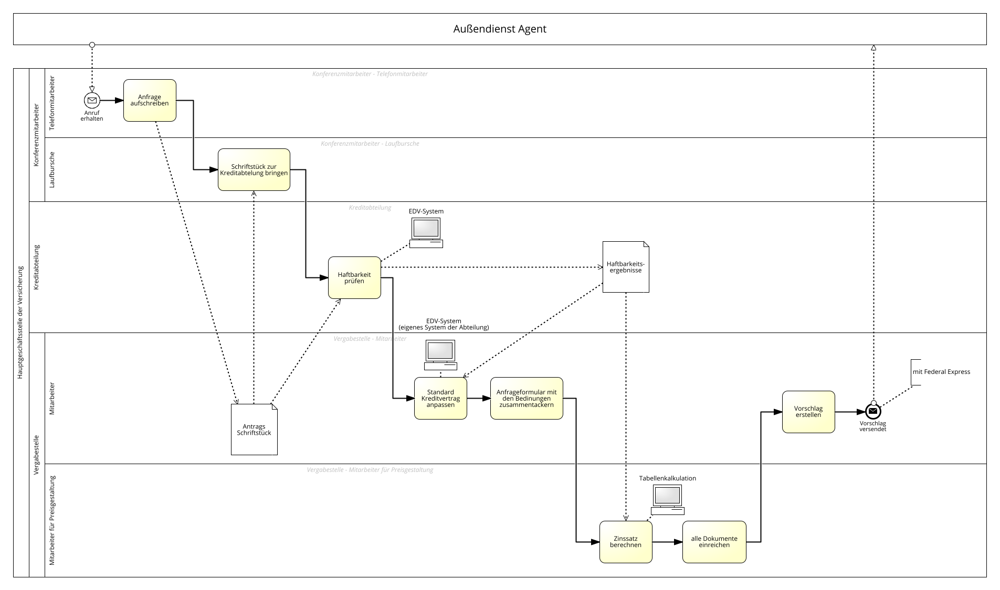

Name:  IT resolution of tickets
setup folder
MMV aaa


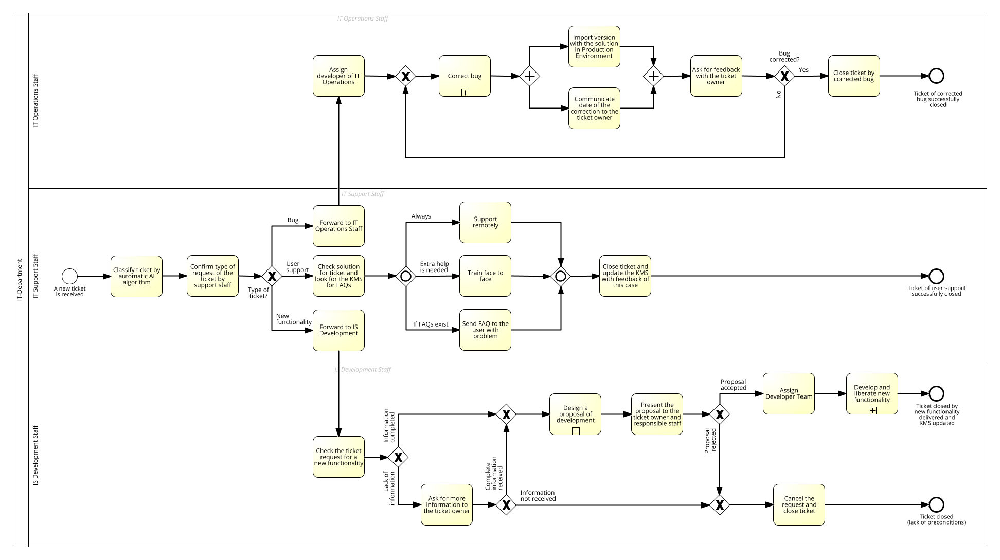

Name:  Entwicklung Steuerungstechnik
setup folder
MMV aaa


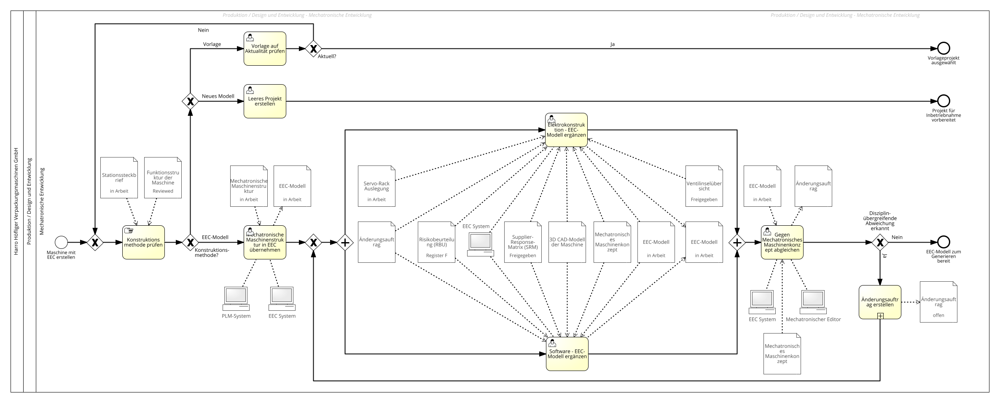

Name:  Einnahmen einfordern Strategie (ist-Prozess)
setup folder
MMV aaa


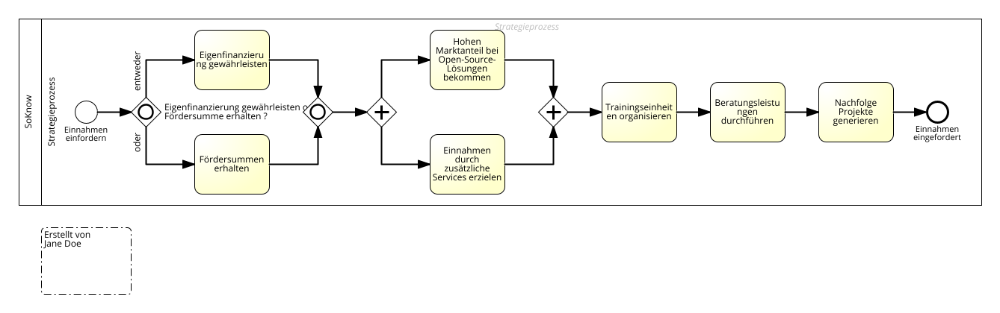

Name:  Process discovery
setup folder
MMV aaa


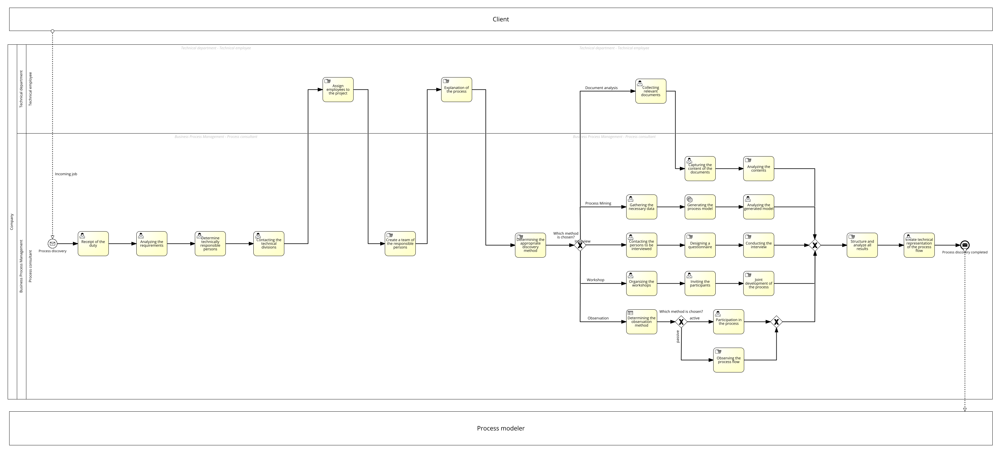

Name:  Is Short or Long Trip?
setup folder
MMV aaa


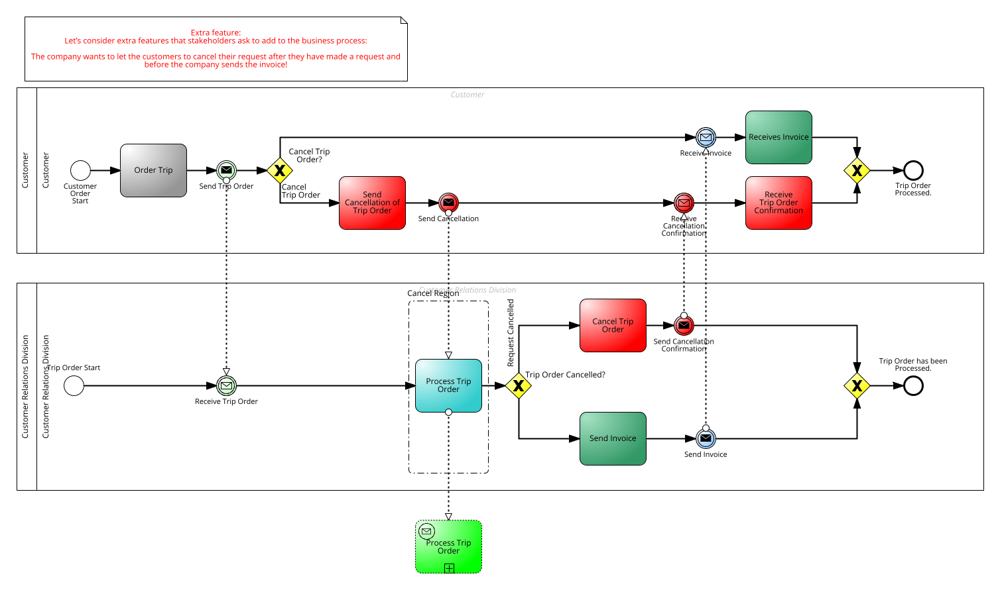

Name:  Prozesserhebung / -dokumentation
setup folder
MMV aaa


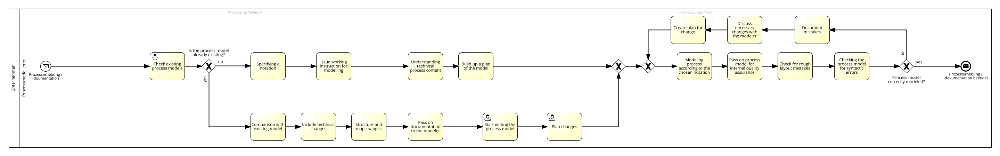

Name:  1.3.1 Contract withdrawal
setup folder
MMV aaa


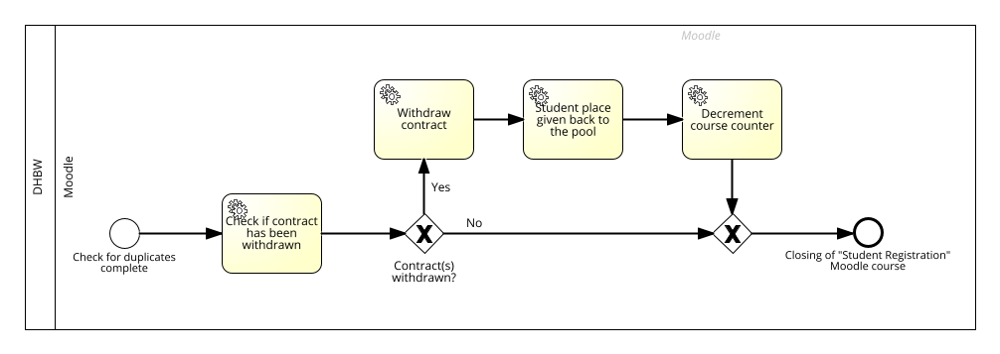

Name:  Mitzeichnungsvermerk
weiterleiten
setup folder
MMV aaa


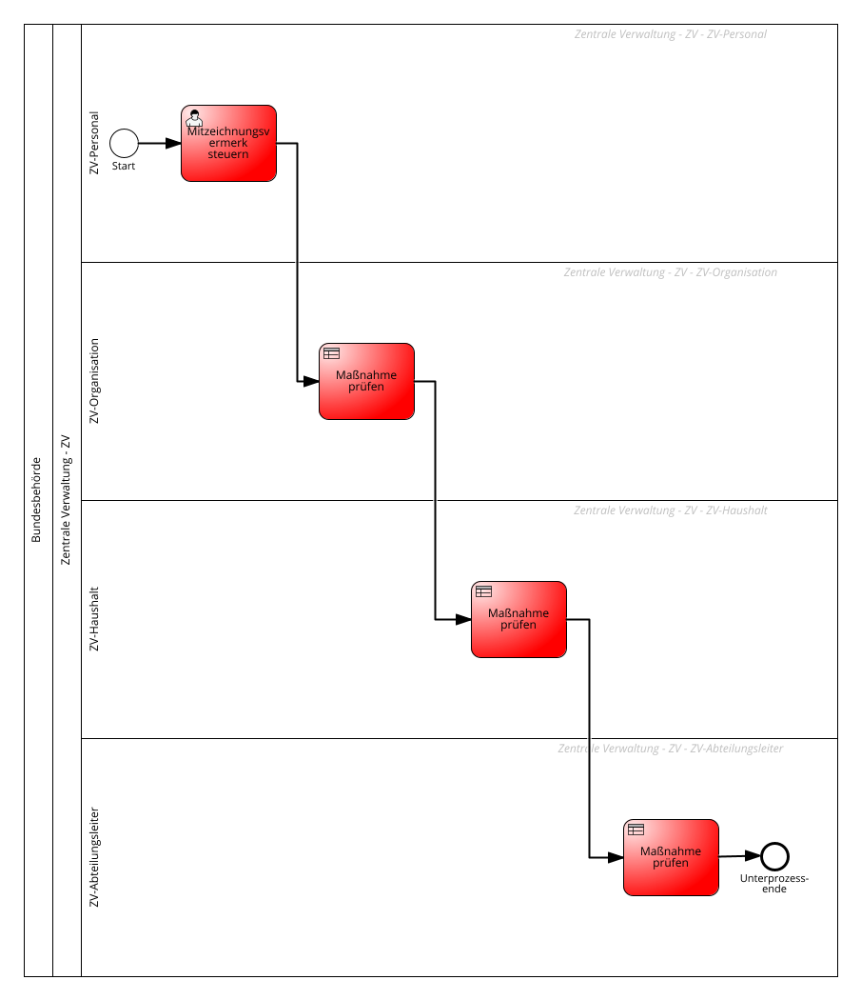

Name:  Neue Technologien herausfinden (ist-Prozess)
setup folder
MMV aaa


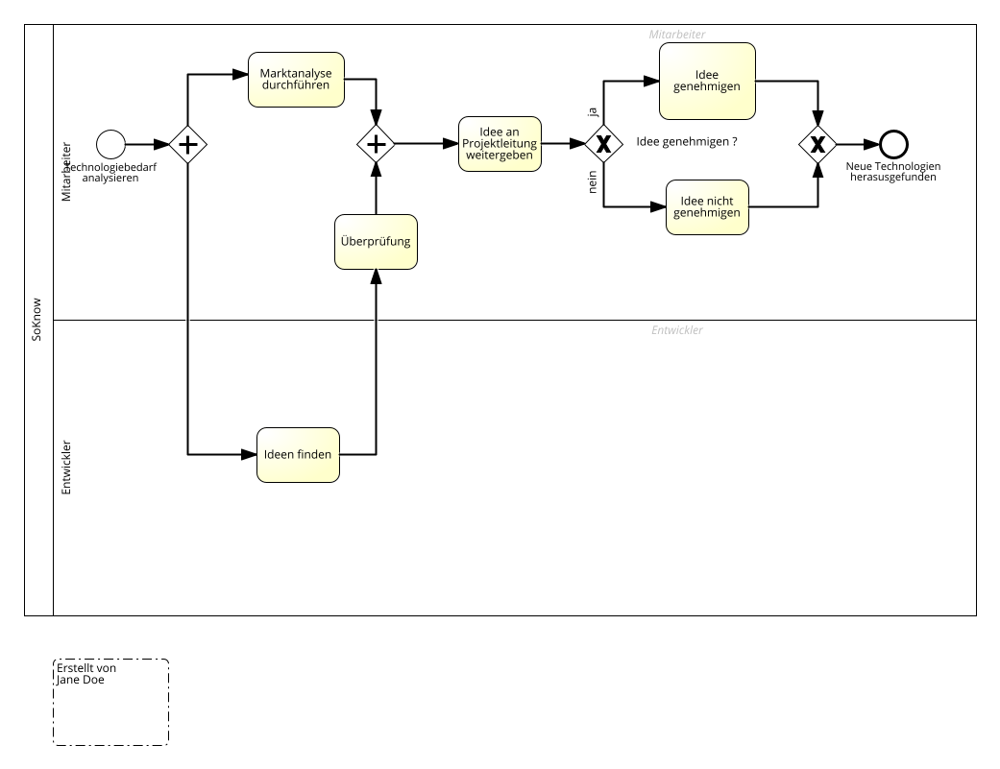

Name:  Pharmacy
setup folder
MMV aaa


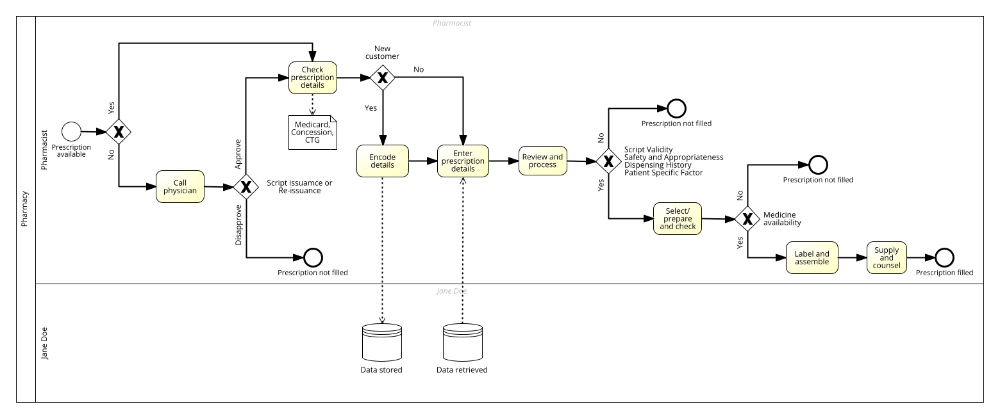

Name:  Create New Dummy Staff
setup folder
MMV aaa


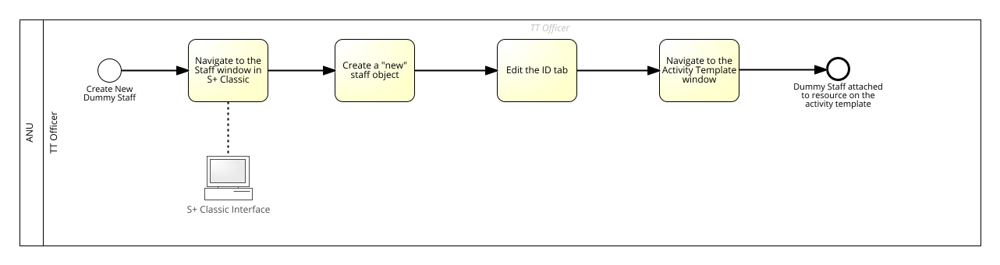

Name:  s B2B sale (1st Phase)
setup folder
MMV aaa


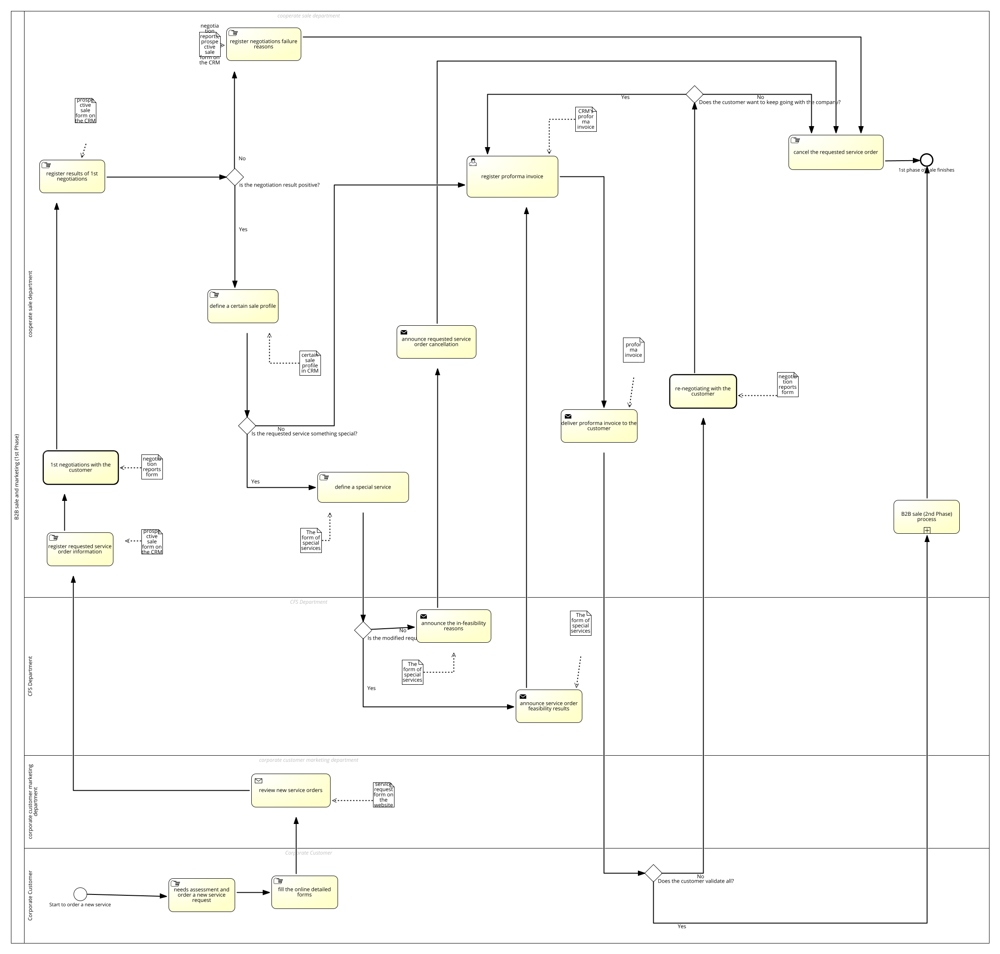

Name:  Einnahmen einfordern
setup folder
MMV aaa


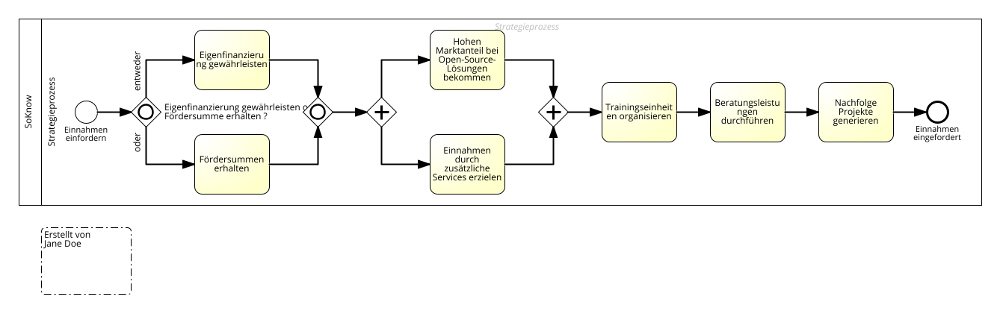

Name:  Zahlungsverkehr (Soll-Prozess)
setup folder
MMV aaa


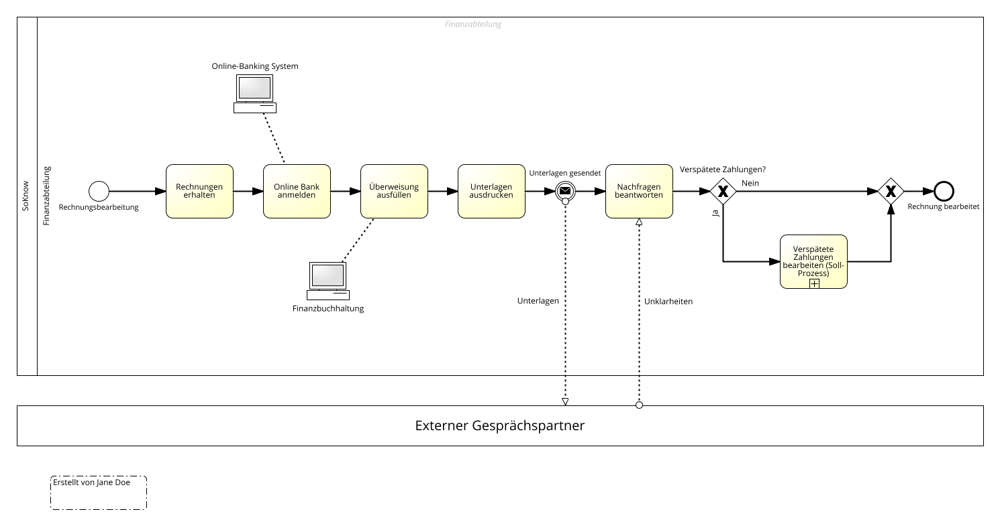

Name:  XX
setup folder
MMV aaa


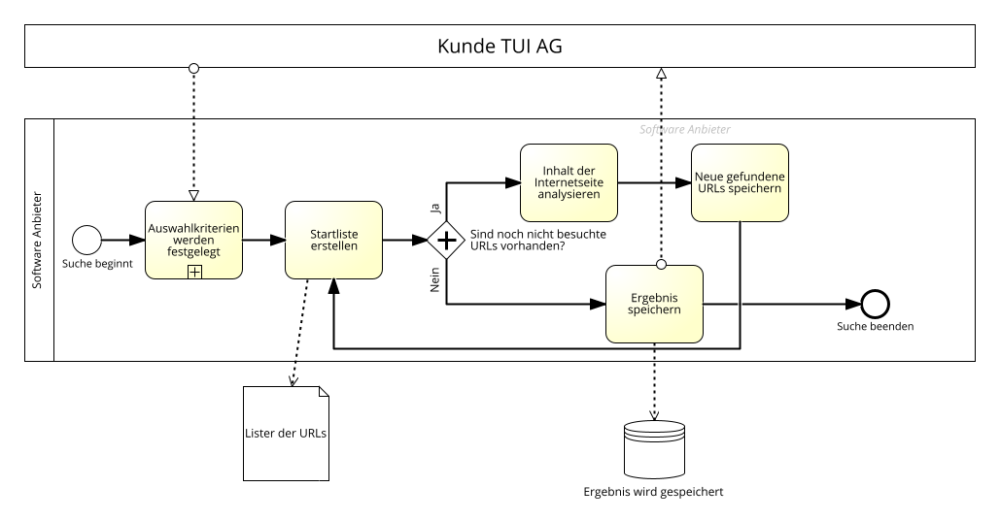

Name:  2. Vacation Leave Request
setup folder
MMV aaa


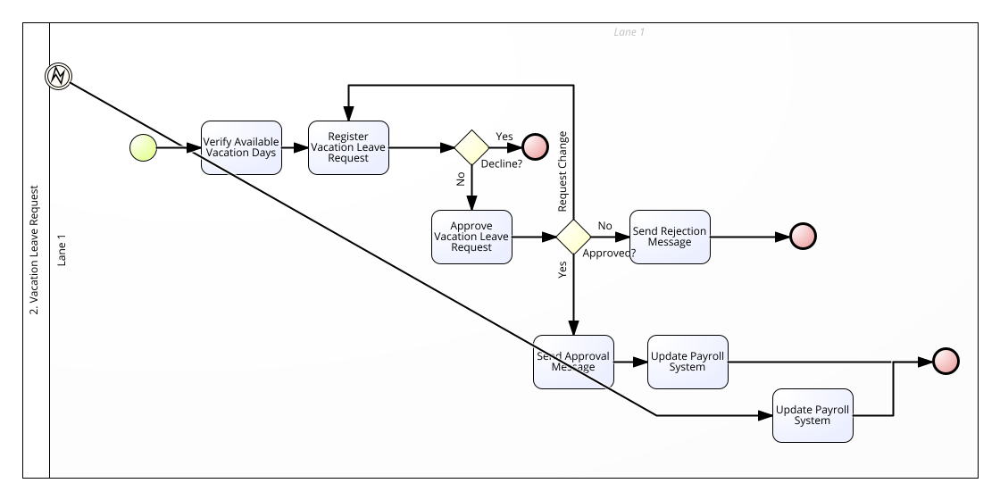

Name:  1.1 Execute Fixed Income /Derivative  Trade
setup folder
MMV aaa


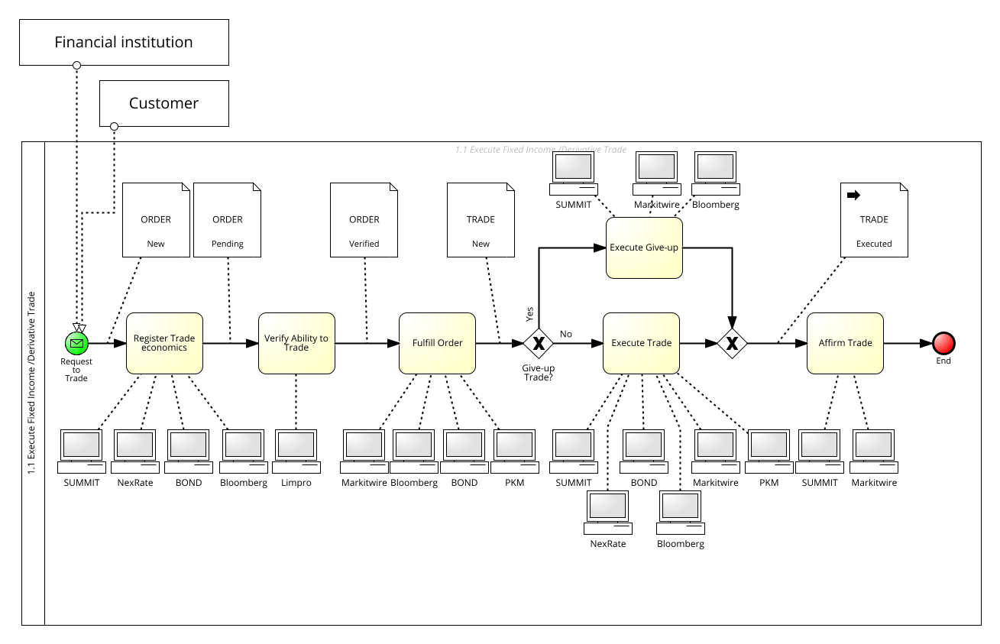

Name:  IMIS-Application Process
setup folder
MMV aaa


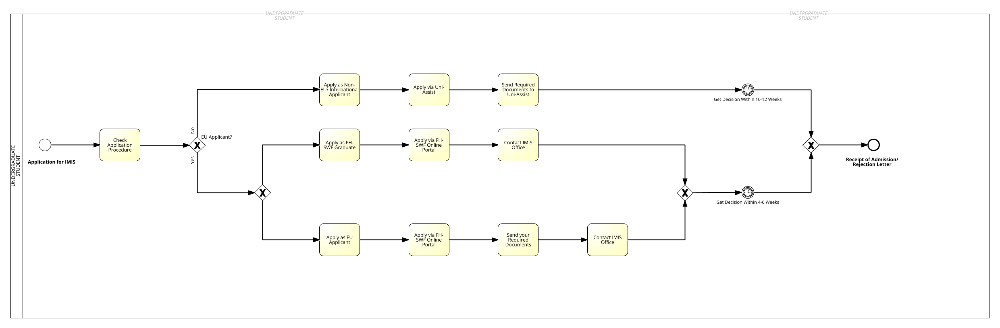

Name:  Inhalt der Formulare prüfen
setup folder
MMV aaa


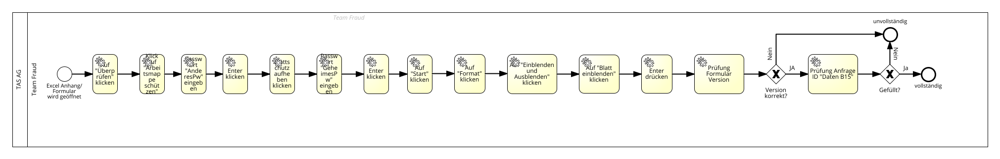

Name:  Risk management
setup folder
MMV aaa


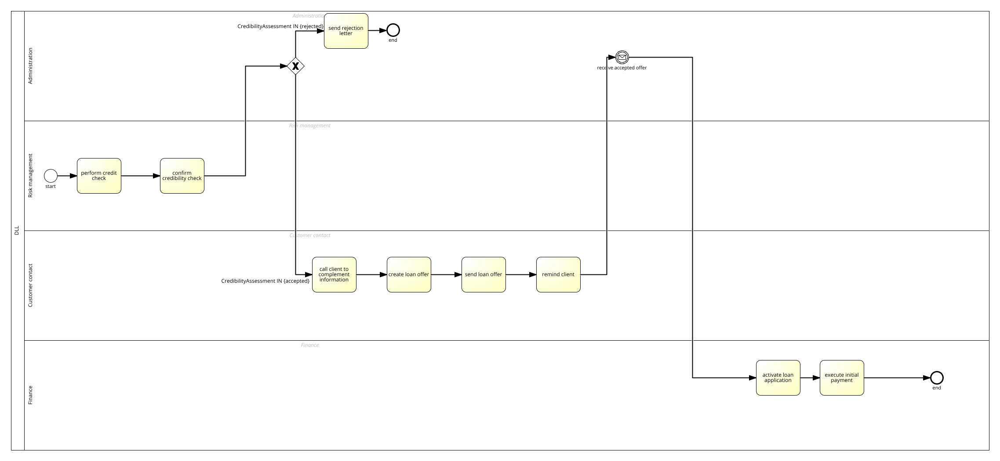

Name:  Schutzmaßnahmen Datei entfernen
setup folder
MMV aaa


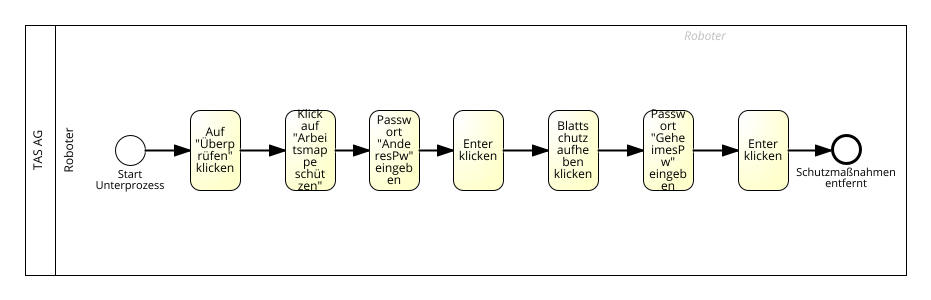

Name:  Develop and liberate new functionality
setup folder
MMV aaa


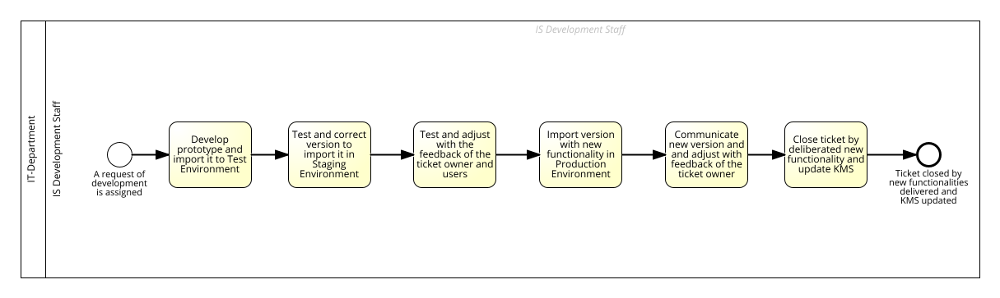

Name:  Steuern abführen
setup folder
MMV aaa


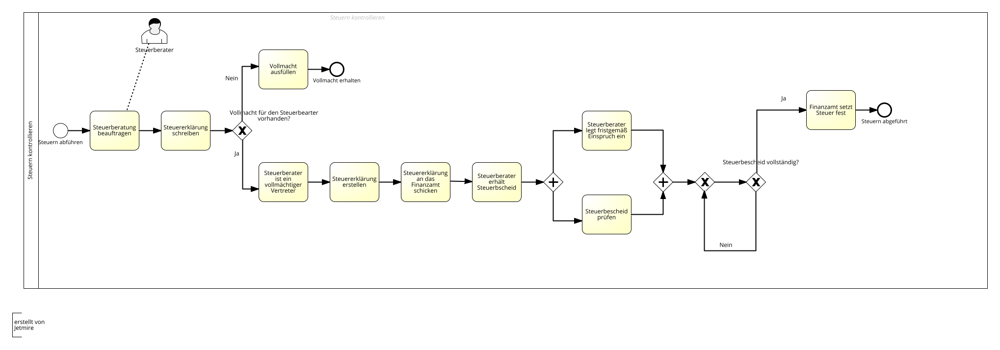

Name:  Beratungsleistung formulieren (ist-Prozess)
setup folder
MMV aaa


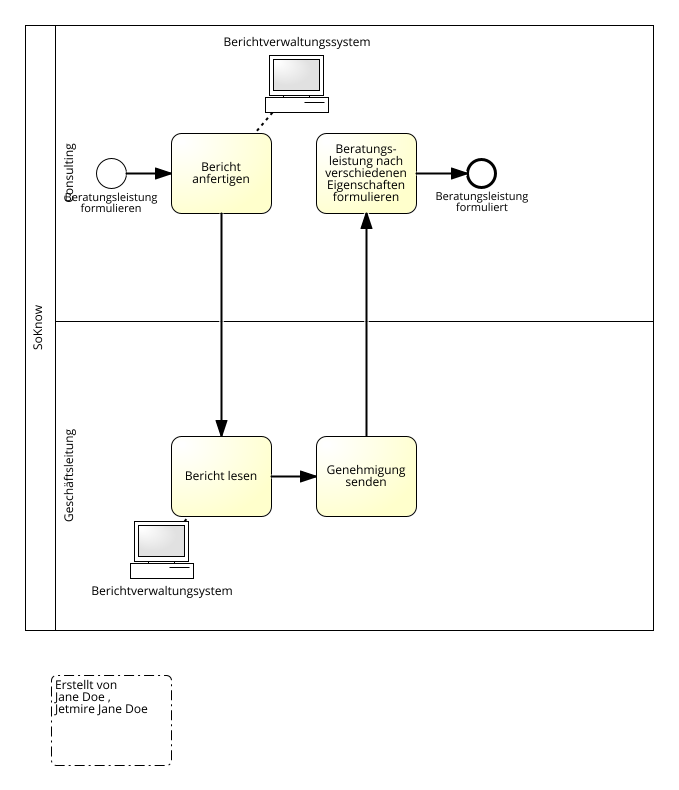

Name:  Travel info
setup folder
MMV aaa


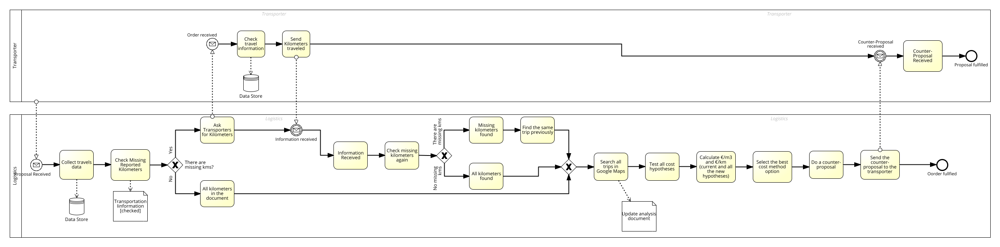

Name:  ?
setup folder
MMV aaa


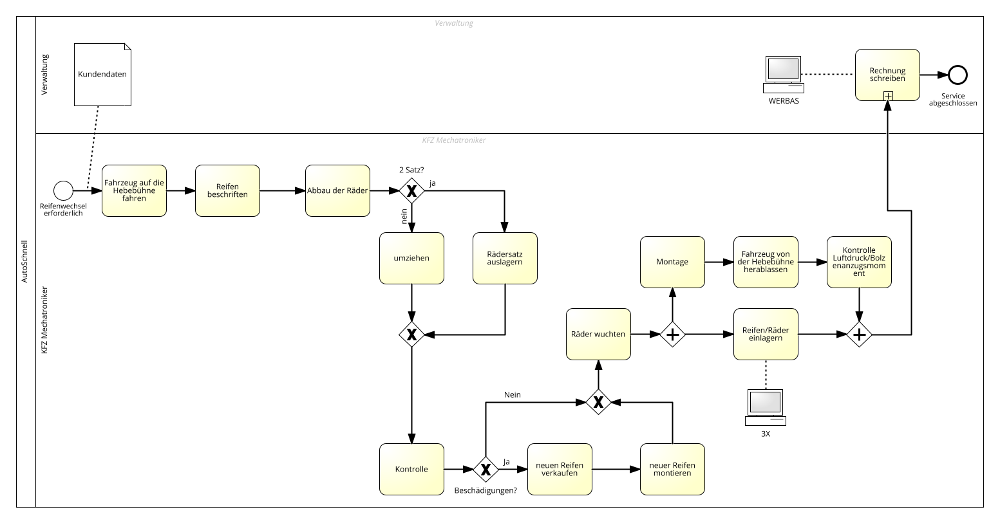

Name:  s B2B sale (2nd Phase)
setup folder
MMV aaa


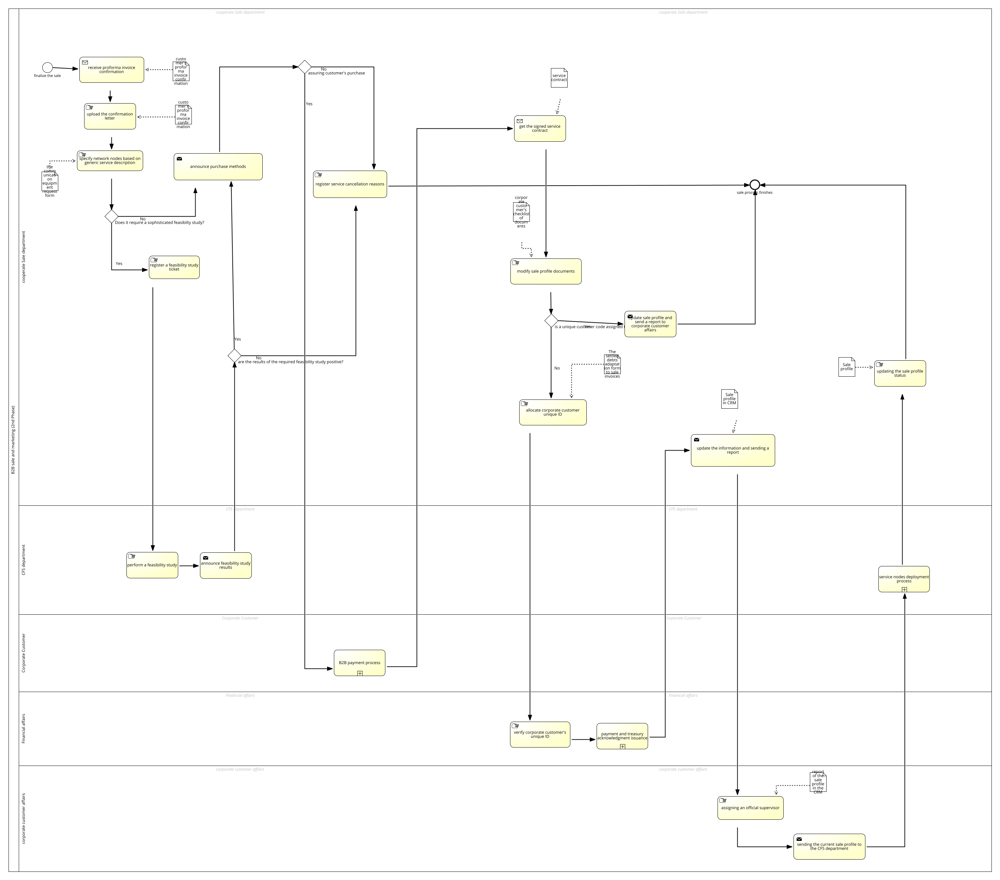

Name:  Personalabteilung
setup folder
MMV aaa


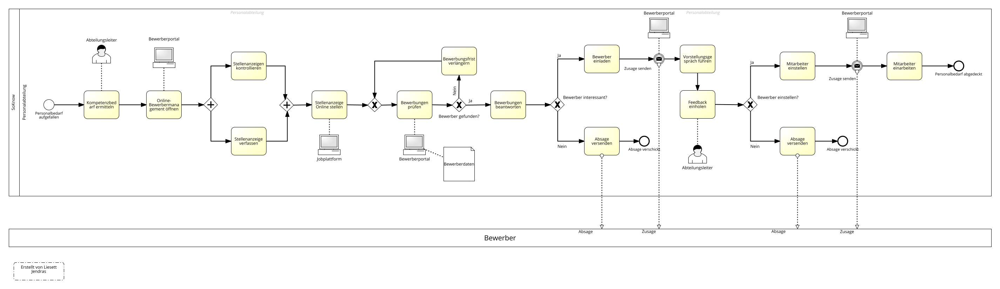

Name:  Protokollführung (Soll-Prozess)
setup folder
MMV aaa


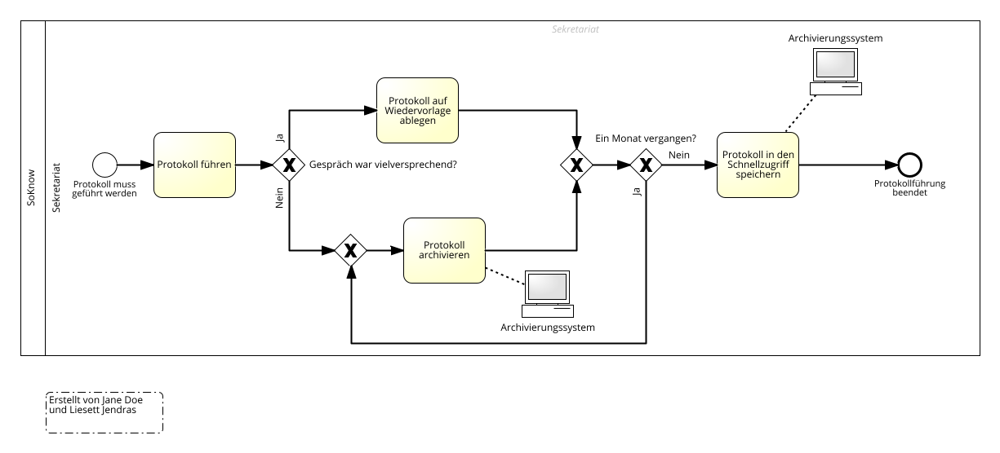

Name:  2.1 Execute FX/Derivative  Trade
setup folder
MMV aaa


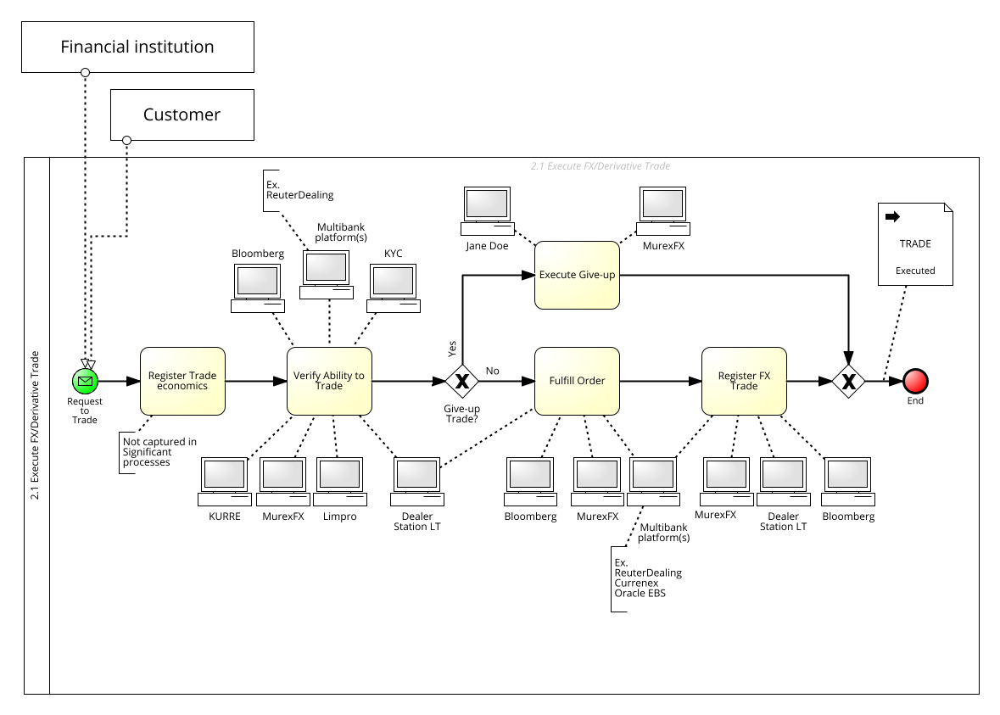

Name:  Produkt entwickeln (Soll-Prozess)
setup folder
MMV aaa


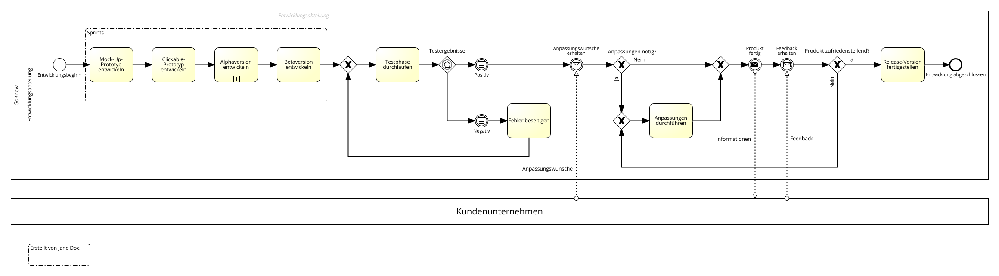

Name:  Krankenhaus Prozess
setup folder
MMV aaa


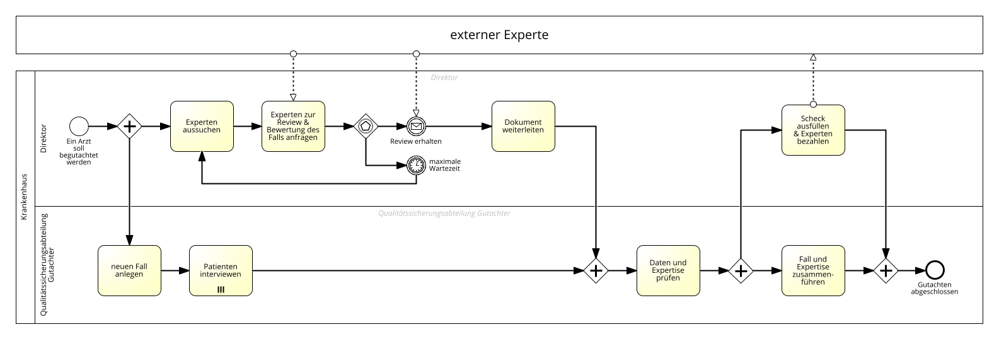

Name:  Kundenbeziehungen verbessern
setup folder
MMV aaa


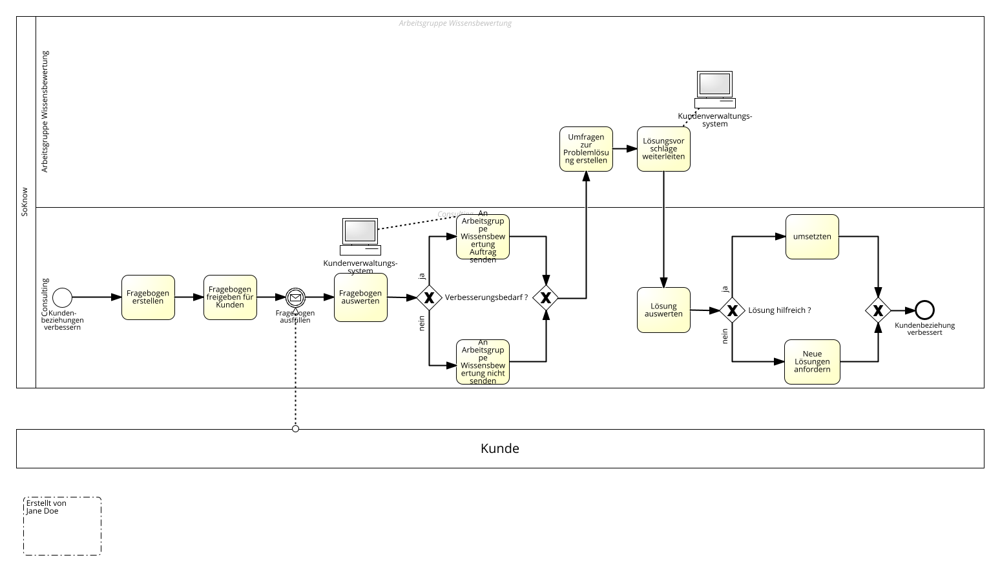

Name:  Postbearbeitung (Soll-Prozess)
setup folder
MMV aaa


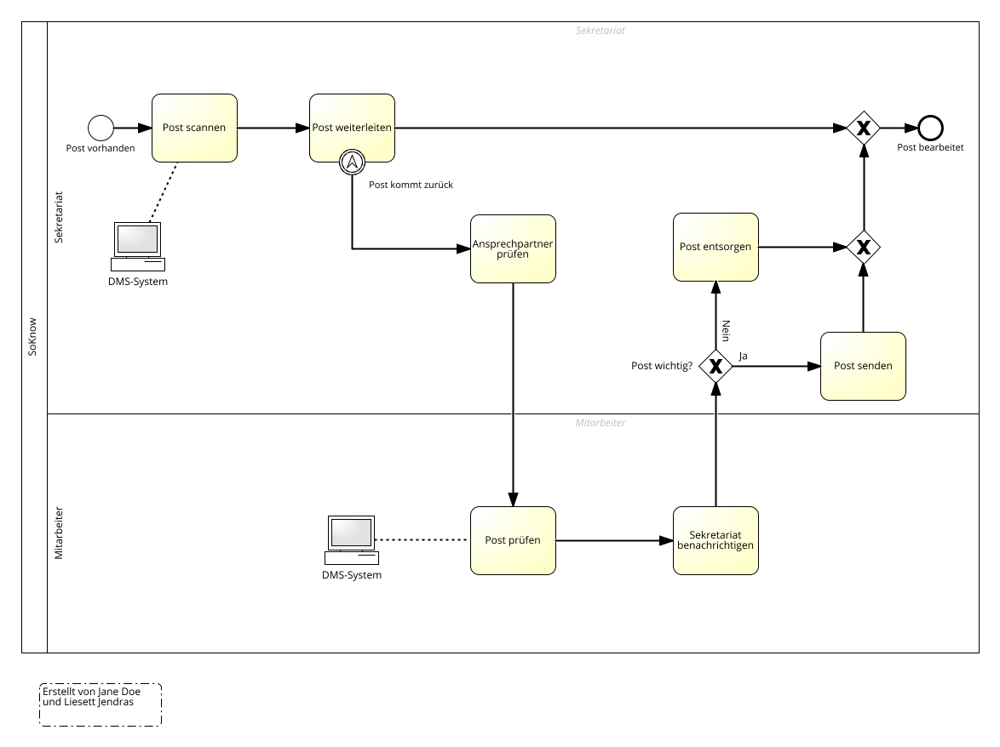

Name:  Rechnung
setup folder
MMV aaa


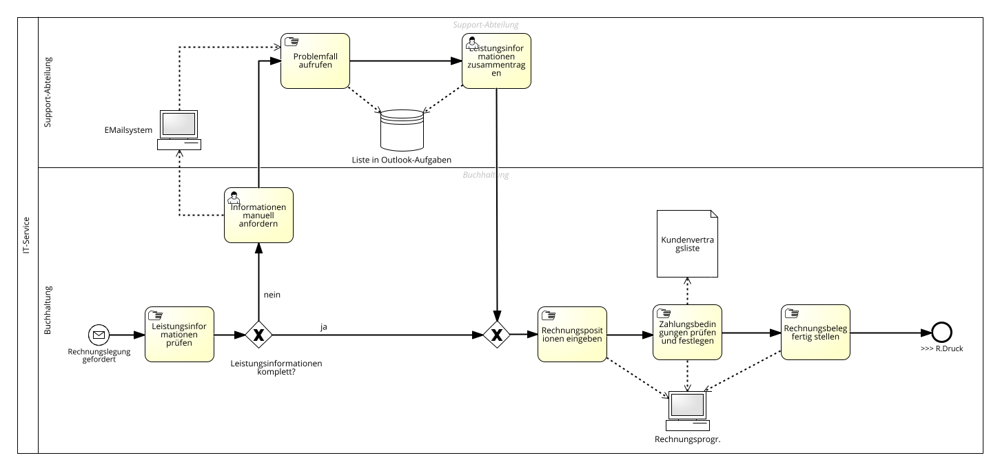

Name:  Kundenverbindung aufnehmen
setup folder
MMV aaa


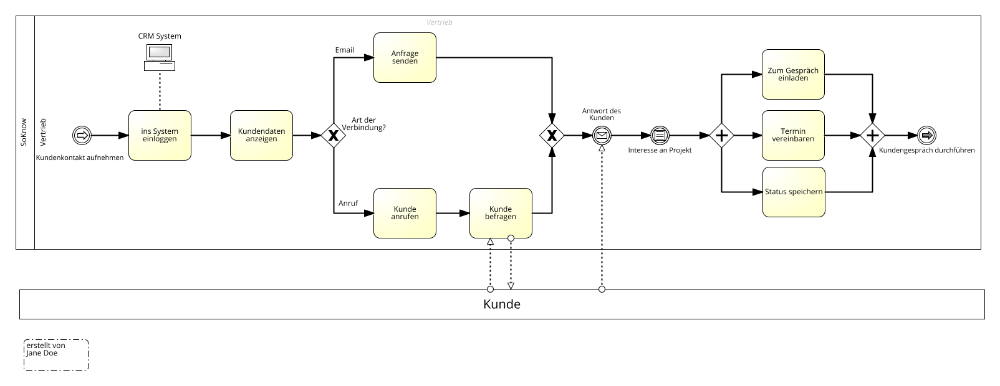

Name:  Aufgabe bestätigen
setup folder
MMV aaa


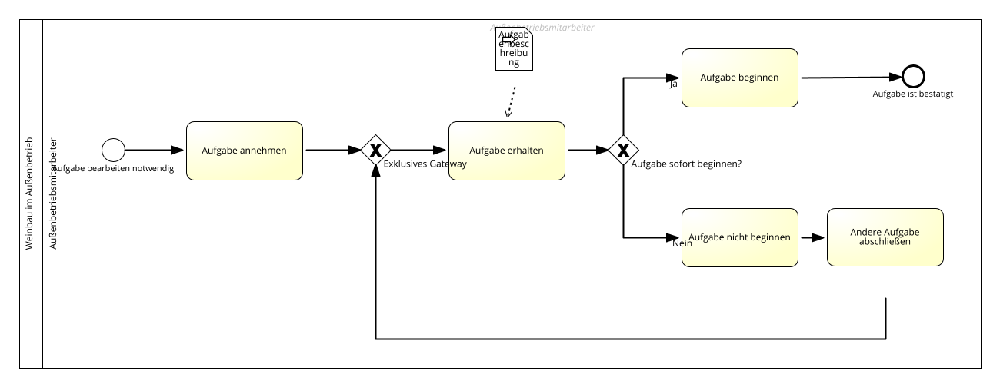

1       None
14      None
        ... 
5429    None
7814    None
Length: 141, dtype: object

In [15]:
# Lets draw these

from IPython.display import Image, display
from sapsam.ImageGenerator import ImageGenerator

def upload_and_show_image(model):
    # get required data
    model_json = model.model_json
    model_namespace = model.namespace
    model_name = json.loads(model_json)['properties']['name']
    print('Name: ', model_name)
    # generate image
    gen = ImageGenerator()
    image_request = gen.generate_image(model_name, model_json, model_namespace, deletes=False)
    display(Image(image_request))

not_blacklisted.apply(upload_and_show_image, axis=1)

In [87]:
# Lets save the cleaned data set as a file
not_blacklisted.to_pickle(constants.DATA_ROOT / "cleaned" / "sapsam_cleaned.pkl")

# Generating process documentation
Welcome to the main purpose of the data set preparation - the creation of multimodal process documentations. We do this in two steps:
* Uploading the models to Signavio via API
* Using selenium to create the documentation via the Signavio Website (API is not easy accessible yet)

In [101]:
# In a first step lets upload the processes to signavio

sapsam_cleaned = pd.read_pickle(constants.DATA_ROOT / "cleaned" / "sapsam_cleaned.pkl")

from IPython.display import Image, display
from sapsam.ImageGenerator import ImageGenerator

for i in range (sapsam_cleaned.shape[0]):
    current = sapsam_cleaned.iloc[i]
    filename = f"{i}_model"
    model_json = current.model_json
    model_namespace = current.namespace
    # generate image
    gen = ImageGenerator()
    print(i, current.model_json_name)
    # note: error InvalidHeader can occour if the account is deactivated or credentials are wrong
    image_request = gen.generate_image(filename, model_json, model_namespace, deletes=False)

0 Receipt of application
setup folder
MMV aaa
1 Procurement of work equipment
setup folder
MMV aaa
2 Procure parts
setup folder
MMV aaa
3 Arbeitsmittel beschaffen
setup folder
MMV aaa
4 Bewerbungseingang

setup folder
MMV aaa
5 Teile beschaffen
setup folder
MMV aaa
6 
setup folder
MMV aaa
7 administrator

setup folder
MMV aaa
8 base model (adjusted_V1)
setup folder
MMV aaa
9 11. Quick-Model-Prozess
setup folder
MMV aaa
10 vaja3
setup folder
MMV aaa
11 Programm-Menü-AOG
setup folder
MMV aaa
12 Projektdurchführung (Soll-Prozess)
setup folder
MMV aaa
13 Wareneingang
setup folder
MMV aaa
14 Seller receives  buyer's message and  resends the order
setup folder
MMV aaa
15 Problem lösen
setup folder
MMV aaa
16 Lernfortschritt
setup folder
MMV aaa
17 Personal Email Account Creation.
setup folder
MMV aaa
18 PC zusammenbauen
setup folder
MMV aaa
19 Administrator
setup folder
MMV aaa
20 Kundenservice (Soll-Prozess)
setup folder
MMV aaa
21 start to prepare cooking paper
setup folder
MMV aaa
22 Regi

In [21]:
# In a second step lets create the process documentation. We dont have access to a suitable API yet, but can do it via the website with selenium

from selenium import webdriver
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.common.by import By
from selenium.common.exceptions import ElementNotInteractableException, StaleElementReferenceException
import time

from conf import pw, email

# url to the signavio dictionary where the models are saved. adapt to your dict
url_to_dict = "https://academic.signavio.com/p/explorer#/directory/dfaee9d97599466aa6b5c09015ae24ba" 


driver = webdriver.Chrome()
driver.get(url_to_dict)

# login
print("Logging in")
login_email = driver.find_element(By.ID, "name")
login_email.send_keys(email)
login_password = driver.find_element(By.ID, "password")
login_password.send_keys(pw)
login_submit = driver.find_element(By.ID, "submit")
login_submit.click()

# navigate to SAP-SAM folder
print("Loading page - takes a while")
driver.get(url_to_dict)
time.sleep(13)

sapsam_cleaned = pd.read_pickle(constants.DATA_ROOT / "cleaned" / "sapsam_cleaned.pkl")
for i in range(sapsam_cleaned.shape[0]):
    
    # Opening report page
    print("Opening report page")
    reporting = driver.find_element(By.XPATH, "//button[text()='Reporting']")
    reporting.click()
    process_documentation = driver.find_element(By.XPATH, "//a[text()='Process documentation (PDF)']")
    process_documentation.click()
    time.sleep(1)

    # Clicking the checkbox for the model
    model_span = driver.find_element(By.XPATH, f"//div/a[@class='x-tree-node-anchor']/span[text()='{i}_model']")
    model_div = model_span.find_element(By.XPATH, "../..")
    model_checkbox = model_div.find_element(By.CSS_SELECTOR, "input[type='checkbox']")
    model_checkbox.click()

    # Inserting the name
    input_title = driver.find_element(By.NAME, "title")
    input_title.clear()
    input_title.send_keys(f"{i}_process_documentation")

    # Generating process documentation (will be downloaded autoamatically to the download folder)
    print(f"Generating report for {i}, takes some seconds")
    button_submit = driver.find_element(By.XPATH, "//button[text()='Generate documentation']")
    button_submit.click()
    time.sleep(5)

    button_ok = driver.find_element(By.XPATH, "//button[text()='OK']")
    button_ok.click()
    time.sleep(1)



time.sleep(3)

driver.close()

Logging in
Loading page - takes a while
Opening report page
Generating report for 0, takes some seconds
Opening report page
Generating report for 1, takes some seconds
Opening report page
Generating report for 2, takes some seconds
Opening report page
Generating report for 3, takes some seconds
Opening report page
Generating report for 4, takes some seconds
Opening report page
Generating report for 5, takes some seconds
Opening report page
Generating report for 6, takes some seconds
Opening report page
Generating report for 7, takes some seconds
Opening report page
Generating report for 8, takes some seconds
Opening report page
Generating report for 9, takes some seconds
Opening report page
Generating report for 10, takes some seconds
Opening report page
Generating report for 11, takes some seconds
Opening report page
Generating report for 12, takes some seconds
Opening report page
Generating report for 13, takes some seconds
Opening report page
Generating report for 14, takes some sec

In [26]:
# We move the generated pdfs manually into the sapsam/cleaned folder
# As a next step we transform the pdfs into images because current multimodal models can handle images or text only but not PDFs yet
# We ensure that we do not loose any information during the process

number_of_models = pd.read_pickle(constants.DATA_ROOT / "cleaned" / "sapsam_cleaned.pkl").shape[0]

import pypdfium2 as pdfium


for i in range(number_of_models):
    pdf = pdfium.PdfDocument(constants.DATA_ROOT / "cleaned" / f"{i}_process_documentation - 1.0.0.pdf")
    n_pages = len(pdf)
    print(f"Extracting {n_pages} pages from entry {i}")
    for page_number in range(n_pages):
        page = pdf.get_page(page_number)
        pil_image = page.render(scale=300/72).to_pil()
        filename = constants.DATA_ROOT / "cleaned" / f"{i}_process_documentation_page_{page_number}.png"
        pil_image.save(filename)

Extracting 7 pages from entry 0
Extracting 7 pages from entry 1
Extracting 7 pages from entry 2
Extracting 7 pages from entry 3
Extracting 7 pages from entry 4
Extracting 7 pages from entry 5
Extracting 8 pages from entry 6
Extracting 7 pages from entry 7
Extracting 7 pages from entry 8
Extracting 7 pages from entry 9
Extracting 7 pages from entry 10
Extracting 18 pages from entry 11
Extracting 8 pages from entry 12
Extracting 6 pages from entry 13
Extracting 7 pages from entry 14
Extracting 7 pages from entry 15
Extracting 6 pages from entry 16
Extracting 6 pages from entry 17
Extracting 6 pages from entry 18
Extracting 7 pages from entry 19
Extracting 6 pages from entry 20
Extracting 9 pages from entry 21
Extracting 6 pages from entry 22
Extracting 6 pages from entry 23
Extracting 7 pages from entry 24
Extracting 7 pages from entry 25
Extracting 8 pages from entry 26
Extracting 6 pages from entry 27
Extracting 7 pages from entry 28
Extracting 7 pages from entry 29
Extracting 7 pages 

# Generating ground truth json
We want to transform the ground truth process models into our json schema which will use later as a target format for the process generation.
The advantage from the schema to the current process models are the following
* It is shorter which is important for LLM because their tokens are limited
* It includes only relevant information and for example not X and Y painting coordinates
* It is simple and easy to understand which makes it also easy understandable for the LLM, at least thats the hope
* chatGTP can and will work well with JSON schemas in the future. The function api of chatGTP enforces a json ouput structure based on a json schema which is sadly not yet available for v4 with vision.

In [5]:
from multimodalgenai.bpmn_schema import bpmn_schema
from sapsam_mapping import sapsam_mapping

# load models
sapsam_cleaned = pd.read_pickle(constants.DATA_ROOT / "cleaned" / "sapsam_cleaned.pkl")

from jsonschema import validate, ValidationError

def flatten_bpmn_rec(shape, parent_lane=''):
    """
    Transforms the given JSON excerpt into the defined BPMN schema.
    :param json_data: The input JSON data
    :return: Transformed JSON object following the BPMN schema
    """

    tasks, events, gateways, pools, messageFlows, sequenceFlows = [], [], [], [], [], []

    # Load the JSON if it's provided as a string
    if isinstance(shape, str):
        shape = json.loads(shape)
    
    # extract basic element information
    element = {
        "id": shape["resourceId"],
        "name": shape["properties"].get("name", "").replace("\n", " ").strip(),
        #"type": shape["stencil"]["id"],
        "outgoing": shape.get("outgoing", []),
    }
    if(parent_lane): element["parent_lane"] = parent_lane

    # extract specific element information based on the type
    element_type = sapsam_mapping[shape["stencil"]["id"]]
    if element_type == "Events":
        assert len(element.get("childShapes", [])) == 0, "Events dont have child shapes"
        # extract event type from stencil id
        element["type"] = shape["stencil"]["id"] 
        events.append(element)
    elif element_type == 'Activities':
        assert len(element.get("childShapes", [])) == 0, "Activities dont have child shapes"
        # extract task type from properties or stencil id
        task_type = shape["properties"].get("tasktype", None)
        # catch none string
        if task_type == "None": task_type = None
        if task_type: 
            element["type"] = task_type
        else:  
            element["type"] = shape["stencil"]["id"]
        tasks.append(element)
    elif element_type == 'Gateways':
        assert len(element.get("childShapes", [])) == 0, "Gateways dont have child shapes"
        # extract gateway type from stencil id. Replace type with shorter naming convention
        gateway_type = shape["stencil"]["id"]
        if gateway_type == "InclusiveGateway": gateway_type = "Inclusive"
        elif gateway_type == "Exclusive_Databased_Gateway": gateway_type = "Exclusive"
        elif gateway_type == "ParallelGateway": gateway_type = "Parallel"
        elif gateway_type == "EventbasedGateway": gateway_type = "Eventbased"
        element["type"] = gateway_type 
        # remove optional name if not assigned
        if(not element["name"]): del element['name']
        gateways.append(element)
    elif element_type == 'Sequence Flows':
        assert len(element.get("childShapes", [])) == 0, "Sequence Flows dont have child shapes"
        # extract target ref
        element['targetRef'] = shape.get("target").get("resourceId")
        # rename name in condition (if exists)
        name = element.pop("name")
        if name:  element["condition"] = name
        sequenceFlows.append(element)
    elif element_type == 'Message Flows':
        assert len(element.get("childShapes", [])) == 0, "Message Flows dont have child shapes"
        # extract target ref
        element['targetRef'] = shape.get("target").get("resourceId")
        # rename name in label (if exists)
        name = element.pop("name")
        if name:  element["label"] = name
        messageFlows.append(element)
    elif element_type == 'Pools':
        element['lanes'] = []
        for lane in shape.get("childShapes", []):
            assert sapsam_mapping[lane["stencil"]["id"]] == 'Lanes', "Pools should only have lanes as childs"
            assert len(lane.get("outgoing", [])) == 0,  "Lanes should not have any outgoing elements"
            element['lanes'].append({
                "id": lane["resourceId"],
                "name": lane["properties"].get("name", "").strip()
            })
            for child in lane.get("childShapes", []):
                tasksRec, eventsRec, gatewaysRec, poolsRec, messageFlowsRec, sequenceFlowsRec = flatten_bpmn_rec(child, lane["resourceId"])
                tasks += tasksRec
                events+=eventsRec
                gateways+=gatewaysRec
                pools+=poolsRec
                messageFlows+=messageFlowsRec
                sequenceFlows+=sequenceFlowsRec
                assert(len(pools) == 0), "Pools in pools would be strange"
        pools.append(element)
    elif element_type == 'Diagram':
        # Process child shapes
        for shapeRec in shape.get("childShapes", []):
            tasksRec, eventsRec, gatewaysRec, poolsRec, messageFlowsRec, sequenceFlowsRec = flatten_bpmn_rec(shapeRec)
            tasks += tasksRec
            events+=eventsRec
            gateways+=gatewaysRec
            pools+=poolsRec
            messageFlows+=messageFlowsRec
            sequenceFlows+=sequenceFlowsRec
        
    return tasks, events, gateways, pools, messageFlows, sequenceFlows

# takes the model from flatten_bpmn_rec and polishs it
# this second step is needed to process sourceRefs, elementRefs and removing attributes
def polish_schema(flatted_bpmn):
    # add sourceRef attribute to control flows by searching outgoing ids
    for flow in flatted_bpmn.get("sequenceFlows", []) + flatted_bpmn.get("messageFlows", []):
        for list in flatted_bpmn.values():
            for item in list:
                for outgoing in item.get("outgoing", []):
                    outgoingId = outgoing.get("resourceId")
                    if flow.get("id") == outgoingId:
                        flow["sourceRef"] = item.get("id")

    # removing outgoing attribute
    for list in flatted_bpmn.values():
        for item in list:
            del(item['outgoing'])

     # add elementRefs attribute to lanes by searching parent_lane ids
    for pool in flatted_bpmn.get("pools", []):
        for lane in pool.get("lanes", []):
            elementRefs = []
            for list in flatted_bpmn.values():
                for item in list:
                    if lane.get("id") == item.get('parent_lane', ''):
                            elementRefs.append(item.get("id"))
            lane["elemRefs"] = elementRefs

    # removing parent_lane attribute
    for list in flatted_bpmn.values():
        for item in list:
            if item.get('parent_lane', ""): del(item['parent_lane'])

def transform_to_bpmn_schema(json_data):
    tasks, events, gateways, pools, messageFlows, sequenceFlows = flatten_bpmn_rec(json_data)
    flatten_bpmn = {
            "tasks": tasks,
            "events": events,
            "gateways": gateways,
            "pools": pools,
            "messageFlows": messageFlows,
            "sequenceFlows": sequenceFlows
    }
    polish_schema(flatten_bpmn)
    validate(instance=flatten_bpmn, schema=bpmn_schema)
    # try:
    #     validate(instance=flatten_bpmn, schema=bpmn_schema)
    # except ValidationError as e:
    #     print(e)
    return flatten_bpmn



# Example usage
json_data = json.loads(sapsam_cleaned.iloc[0]["model_json"])
transformed_data = transform_to_bpmn_schema(json_data)
print(json.dumps(transformed_data, indent=2))

{
  "tasks": [
    {
      "id": "sid-FFF7A601-D7E5-4061-8409-146F24B72F13",
      "name": "Invite to job interview",
      "type": "Send"
    },
    {
      "id": "sid-53C132C5-359D-4E79-8FBB-99B7C41973C7",
      "name": "Prepare employment agreement",
      "type": "Task"
    },
    {
      "id": "sid-CAF14C6A-837F-417D-B67A-2A7B6362B5DB",
      "name": "Send receipt confirmation",
      "type": "Send"
    },
    {
      "id": "sid-6CCC5A9A-2512-4C46-93EB-90B1CDD0FFEC",
      "name": "Carry out job interview",
      "type": "Task"
    },
    {
      "id": "sid-18206754-99AE-4C11-B9A7-BEB27E81FED5",
      "name": "Send employment contract",
      "type": "Send"
    },
    {
      "id": "sid-31C0CE32-8227-44E5-B7F0-0501D5D57FB4",
      "name": "Send rejection",
      "type": "Send"
    },
    {
      "id": "sid-F7A0EA5F-240D-433C-A911-C815B73F9A3F",
      "name": "Applicant verified",
      "type": "Business Rule"
    }
  ],
  "events": [
    {
      "id": "sid-25311BE5-F820-4CB8-B325-

In [4]:
# Lets do this for all the models and save them as jsons

import json

for i in range (sapsam_cleaned.shape[0]):
    current = sapsam_cleaned.iloc[i]
    try:
        gt = transform_to_bpmn_schema(current.model_json)
        filename = constants.DATA_ROOT / "cleaned" / f"{i}_ground_truth.json"
        with open(filename, 'w') as f:
            json.dump(gt, f, indent=4)
    except AssertionError as e:
        print("MMV Assertion")
        print(e)
        print(current.model_json_name)
        print(current.model_json)
    except ValidationError as e:
        print("MMV Validation")
        print(e)
        print(current.model_json_name)
        print(current.model_json)